<a href="https://colab.research.google.com/github/kimjh7669/DeepLearning_Practice/blob/main/Tensorflow_Robust_Lane_deteciton.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dataset Download from Kaggle (robust-lane-detection)

## Google Mount

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Download from Kaggle

In [ ]:
import os
print(os.getcwd())
from google.colab import files
files.upload() #upload kaggle.json


!pip install -U kaggle==1.5.1
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 /root/.kaggle/kaggle.json
!kaggle datasets download -d junghokim/robust-lane-detection
# !unzip robust-lane-detection.zip -d ./data -q

/content


Saving kaggle.json to kaggle.json
     |████████████████████████████████| 53 kB 2.0 MB/s 
     |████████████████████████████████| 132 kB 15.0 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.1-py3-none-any.whl size=64744 sha256=30a6613b3dca19d449251e550f2298c72ec73a88611d016b01c17e2127e8c11d
  Stored in directory: /root/.cache/pip/wheels/12/e1/d4/d5d5e8c536b2e712b2356c76b9bd37d6248e92f16f9639902a
Successfully built kaggle
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is in

In [ ]:
!unzip -qq robust-lane-detection.zip -d ./data 

# Train

## Config

In [ ]:
import easydict

# globel param
# dataset setting
img_width = 256
img_height = 128
img_channel = 3
label_width = 256
label_height = 128
label_channel = 1
data_loader_numworkers = 8
class_num = 1

# path
train_path = "/content/drive/MyDrive/Robust_Lane_Detection/train_index.txt"
val_path = "/content/drive/MyDrive/Robust_Lane_Detection/val_index.txt"
# test_path = "/content/data/test_index_demo.txt"
save_path = "/content/drive/MyDrive/Robust_Lane_Detection/Result/"
# pretrained_path='./pretrained/unetlstm.pth'

# weight
class_weight = [0.02, 1.02]

# def args_setting():
#     # Training settings
#     parser = argparse.ArgumentParser(description='Tensorflow UNet-ConvLSTM')
    # parser.add_argument('--model',type=str, default='UNet-ConvLSTM',help='( UNet-ConvLSTM | SegNet-ConvLSTM | UNet | SegNet | ')
#     parser.add_argument('--batch-size', type=int, default=1, metavar='N',
#                         help='input batch size for training (default: 10)')
#     parser.add_argument('--test-batch-size', type=int, default=1, metavar='N',
#                         help='input batch size for testing (default: 100)')
#     parser.add_argument('--epochs', type=int, default=5, metavar='N',
#                         help='number of epochs to train (default: 30)')
#     parser.add_argument('--lr', type=float, default=0.01, metavar='LR',
#                         help='learning rate (default: 0.01)')
#     parser.add_argument('--momentum', type=float, default=0.5, metavar='M',
#                         help='SGD momentum (default: 0.5)')
#     parser.add_argument('--cuda', action='store_true', default=True,
#                         help='use CUDA training')
#     parser.add_argument('--seed', type=int, default=1, metavar='S',
#                         help='random seed (default: 1)')
#     parser.add_argument('--log-interval', type=int, default=10, metavar='N',
#                         help='how many batches to wait before logging training status')
#     args = parser.parse_args(args=[])
#     return args

def args_setting():
    args = easydict.EasyDict({
        "model": 'UNet-ConvLSTM',     # help=( UNet-ConvLSTM | SegNet-ConvLSTM | UNet | SegNet | )
        "batch_size" : 5,           # default: 10
        "test_batch_size" : 1,      # default: 100
        "epochs" : 30,              # default: 30
        "lr" : 0.01,                # default: 0.01
        "momentum" : 0.5,           # default: 0.5
        "cuda" : True,              # default: True 
        "seed" : 1,                 # default: 1
        "log_interval" : 10         # default: 10 
    })
    return args

## Utils

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np

class double_conv(layers.Layer): 
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = keras.Sequential([
            layers.Conv2D(out_ch, (3, 3), padding = "SAME", activation=None), 
            layers.BatchNormalization(momentum=0.9),
            layers.Activation('relu'),
            layers.Conv2D(out_ch, (3, 3), padding = "SAME", activation=None), 
            layers.BatchNormalization(momentum=0.9),
            layers.Activation('relu')            
        ])
    def call(self, x):
        x = self.conv(x)
        return x

class inconv(layers.Layer):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = double_conv(in_ch, out_ch)
    def call(self, x):
        x = self.conv(x)
        return x

class down(layers.Layer):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.mpconv = keras.Sequential([
            layers.MaxPooling2D(2),
            layers.Conv2D(out_ch, (3, 3), padding = "SAME", activation=None), 
            layers.BatchNormalization(momentum=0.9),
            layers.Activation('relu'),
            layers.Conv2D(out_ch, (3, 3), padding = "SAME", activation=None), 
            layers.BatchNormalization(momentum=0.9),
            layers.Activation('relu') 
        ])

    def call(self, x):
        x = self.mpconv(x)
        return x
        

class up(layers.Layer):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super().__init__()

        #  would be a nice idea if the upsampling could be learned too,
        #  but my machine do not have enough memory to handle all those weights
        if bilinear:
            self.up = layers.UpSampling2D(size = (2,2), interpolation='bilinear')
        else:
            self.up = layers.Conv2DTranspose(in_ch//2, 2, stride=(2, 2))

        self.conv = double_conv(in_ch, out_ch)

    def call(self, x1, x2):
        x1 = self.up(x1) 
        diffX = x1.shape[1] - x2.shape[1] # height ?
        diffY = x1.shape[2] - x2.shape[2] # width ?
        padding = [[0,0], [diffX// 2, int((diffX + 1)/ 2)], [diffY // 2, int((diffY+1) / 2)], [0,0]]
        x2 = tf.pad(x2, padding)
        x = layers.concatenate([x2, x1], axis=3)
        x = self.conv(x)
        return x

class outconv(layers.Layer):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = layers.Conv2D(out_ch, (1, 1), padding = "SAME", activation=None)
    def call(self, x):
        x = self.conv(x)
        return x


class ConvLSTMCell(layers.Layer):

    def __init__(self, input_size, input_dim, hidden_dim, kernel_size, bias):
        """
        Initialize ConvLSTM cell.

        Parameters
        ----------
        input_size: (int, int)
            Height and width of input tensor as (height, width).
        input_dim: int
            Number of channels of input tensor.
        hidden_dim: int
            Number of channels of hidden state.
        kernel_size: (int, int)
            Size of the convolutional kernel.
        bias: bool
            Whether or not to add the bias.
        """

        super().__init__()

        self.height, self.width = input_size
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim

        self.kernel_size = kernel_size
        self.padding = kernel_size[0] // 2, kernel_size[1] // 2
        self.bias = bias


        self.conv = keras.Sequential([
            layers.ZeroPadding2D(padding=self.padding),
            layers.Conv2D( #in_channels=self.input_dim + self.hidden_dim,
                              filters=4 * self.hidden_dim,
                              kernel_size=self.kernel_size,
                              padding="valid",
                              use_bias=self.bias)
        ])

    def call(self, input_tensor, cur_state):
        h_cur, c_cur = cur_state

        combined = layers.concatenate([input_tensor, h_cur], axis=3)  # concatenate along channel axis

        combined_conv = self.conv(combined)
        for_split_list = []
        
        for i in range(combined_conv.shape[3] // self.hidden_dim):
            for_split_list.append(self.hidden_dim)

        cc_i, cc_f, cc_o, cc_g = tf.split(combined_conv, for_split_list, axis=3) # split 
        i = tf.sigmoid(cc_i)
        f = tf.sigmoid(cc_f)
        o = tf.sigmoid(cc_o)
        g = tf.tanh(cc_g)

        c_next = f * c_cur + i * g
        h_next = o * tf.tanh(c_next)

        return h_next, c_next

    def init_hidden(self, batch_size):
        return (tf.zeros([batch_size, self.height, self.width, self.hidden_dim]),
                tf.zeros([batch_size, self.height, self.width, self.hidden_dim]))


class ConvLSTM(layers.Layer):

    def __init__(self, input_size, input_dim, hidden_dim, kernel_size, num_layers,
                 batch_first=False, bias=True, return_all_layers=False):
        super().__init__()

        self._check_kernel_size_consistency(kernel_size)

        # Make sure that both `kernel_size` and `hidden_dim` are lists having len == num_layers
        kernel_size = self._extend_for_multilayer(kernel_size, num_layers)
        hidden_dim = self._extend_for_multilayer(hidden_dim, num_layers)
        if not len(kernel_size) == len(hidden_dim) == num_layers:
            raise ValueError('Inconsistent list length.')

        self.height, self.width = input_size

        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.kernel_size = kernel_size
        self.num_layers = num_layers
        self.batch_first = batch_first
        self.bias = bias
        self.return_all_layers = return_all_layers

        cell_list = []
        for i in range(0, self.num_layers):
            cur_input_dim = self.input_dim if i == 0 else self.hidden_dim[i - 1]

            cell_list.append(ConvLSTMCell(input_size=(self.height, self.width),
                                          input_dim=cur_input_dim,
                                          hidden_dim=self.hidden_dim[i],
                                          kernel_size=self.kernel_size[i],
                                          bias=self.bias))

        # self.cell_list = nn.ModuleList(cell_list)
        self.cell_list = cell_list
        
    def call(self, input_tensor, hidden_state=None):
        """

        Parameters
        ----------
        input_tensor: todo
            5-D Tensor either of shape (t, b, c, h, w) or (b, t, c, h, w)
        hidden_state: todo
            None. todo implement stateful

        Returns
        -------
        last_state_list, layer_output
        """
        if not self.batch_first:
            # (t, b, c, h, w) -> (b, t, c, h, w) -> t = seq num
            # (t, b, h, w, c) -> (b, t, h, w, c)
            input_tensor = tf.transpose(input_tensor, [1, 0, 2, 3, 4])

        # Implement stateful ConvLSTM
        if hidden_state is not None:
            raise NotImplementedError()
        else:
            hidden_state = self._init_hidden(batch_size=input_tensor.shape[0])

        layer_output_list = []
        last_state_list = []

        seq_len = input_tensor.shape[1]
        cur_layer_input = input_tensor

        for layer_idx in range(self.num_layers):

            h, c = hidden_state[layer_idx]
            output_inner = []
            for t in range(seq_len):
                h, c = self.cell_list[layer_idx](input_tensor=cur_layer_input[:, t, :, :, :],
                                                 cur_state=[h, c])


                output_inner.append(h)

            layer_output = tf.stack(output_inner, axis=1)
            cur_layer_input = layer_output
            
            layer_output = tf.transpose(layer_output, [1, 0, 2, 3, 4])
            layer_output_list.append(layer_output)
            last_state_list.append([h, c])

        if not self.return_all_layers:
            layer_output_list = layer_output_list[-1:]
            last_state_list = last_state_list[-1:]

        return layer_output_list, last_state_list

    def _init_hidden(self, batch_size):
        init_states = []
        for i in range(self.num_layers):
            init_states.append(self.cell_list[i].init_hidden(batch_size))
        return init_states

    @staticmethod
    def _check_kernel_size_consistency(kernel_size):
        if not (isinstance(kernel_size, tuple) or
                (isinstance(kernel_size, list) and all([isinstance(elem, tuple) for elem in kernel_size]))):
            raise ValueError('`kernel_size` must be tuple or list of tuples')

    @staticmethod
    def _extend_for_multilayer(param, num_layers):
        if not isinstance(param, list):
            param = [param] * num_layers
        return param


## model

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import Model
import operator
# from config import args_setting
import numpy as np

def unpool(value, name='unpool'):
    """N-dimensional version of the unpooling operation from
    https://www.robots.ox.ac.uk/~vgg/rg/papers/Dosovitskiy_Learning_to_Generate_2015_CVPR_paper.pdf

    :param value: A Tensor of shape [b, d0, d1, ..., dn, ch]
    :return: A Tensor of shape [b, 2*d0, 2*d1, ..., 2*dn, ch]
    """
    # print(tf.name_scope)
    with tf.name_scope(name) as scope:
        sh = value.get_shape().as_list()
        print(sh)
        dim = len(sh[1:-1])
        print(dim)
        out = (tf.reshape(value, [-1] + sh[-dim:]))
        # print(out)
        for i in range(dim, 0, -1):
            # print(i)
            out = tf.concat([out, tf.zeros_like(out)], i)
        print(out)
        out_size = [-1] + [s * 2 for s in sh[1:-1]] + [sh[-1]]
        print(out_size)
        out = tf.reshape(out, out_size, name=scope)
    return out


def generate_model(args):

    assert args.model in [ 'UNet-ConvLSTM', 'SegNet-ConvLSTM', 'UNet', 'SegNet']
    if args.model == 'SegNet-ConvLSTM':
        model = SegNet_ConvLSTM()
    elif args.model == 'SegNet':
        model = SegNet()
    elif args.model == 'UNet-ConvLSTM':
        model = UNet_ConvLSTM(img_channel, class_num)
    elif args.model == 'UNet':
        model = UNet(img_channel, class_num)
    return model

class UNet_ConvLSTM(Model):
    def __init__(self, n_channels, n_classes):
        super().__init__()
        self.inc = inconv(n_channels, 64)
        self.down1 = down(64, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 512)
        self.up1 = up(1024, 256)
        self.up2 = up(512, 128)
        self.up3 = up(256, 64)
        self.up4 = up(128, 64)
        self.outc = outconv(64, n_classes)
        self.convlstm = ConvLSTM(input_size=(8,16),
                                 input_dim=512,
                                 hidden_dim=[512, 512],
                                 kernel_size=(3,3),
                                 num_layers=2,
                                 batch_first=False,
                                 bias=True,
                                 return_all_layers=False)

    def call(self, x):
        x = tf.unstack(x, axis=1)
        # data = []
        for idx, item in enumerate(x):
            x1 = self.inc(item)
            x2 = self.down1(x1)
            x3 = self.down2(x2)
            x4 = self.down3(x3)
            x5 = self.down4(x4)
            if idx == 0:
                data = tf.expand_dims(x5, axis = 0)
            else:
                data = tf.concat([data, tf.expand_dims(x5, axis = 0)], axis = 0)
            
            # data.append(tf.expand_dims(x5, axis = 0))
        # data = layers.concatenate(data, axis=0)
        
        lstm, _ = self.convlstm(data)
        test = lstm[-1][ -1,:, :, :, :]
        x = self.up1(test, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return tf.math.sigmoid(x)



class UNet(Model):
    def __init__(self, n_channels, n_classes):
        super().__init__()
        self.inc = inconv(n_channels, 64)
        self.down1 = down(64, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 512)
        self.up1 = up(1024, 256)
        self.up2 = up(512, 128)
        self.up3 = up(256, 64)
        self.up4 = up(128, 64)
        self.outc = outconv(64, n_classes)

    def call(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return x

## dataset

In [ ]:
import tensorflow as tf
from tensorflow import data
from tensorflow.keras.utils import Sequence
from tensorflow.keras.preprocessing import image
from PIL import Image
import numpy as np
# from sklearn import preprocessing

def readTxt(file_path):
    img_list = []
    with open(file_path, 'r') as file_to_read:
        while True:
            lines = file_to_read.readline()
            if not lines:
                break
            item = lines.strip().split()
            img_list.append(item)
    file_to_read.close()
    return img_list

class RoadSequenceDataset(Sequence):

    def __init__(self, file_path):

        self.img_list = readTxt(file_path)
        self.dataset_size = len(self.img_list)
    def __len__(self):
        return self.dataset_size

    def __getitem__(self, idx):
        img_path_list = self.img_list[idx]
        data = Image.open(img_path_list[4])
        label = Image.open(img_path_list[5])
        data = image.img_to_array(data)
        label = tf.squeeze(image.img_to_array(label))
        sample = {'data': data, 'label': label}
        return sample

class RoadSequenceDatasetList(Sequence):

    def __init__(self, file_path, batch_size, shuffle = True):
        self.batch_size = batch_size
        self.img_list = readTxt(file_path)
        self.dataset_size = len(self.img_list)
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        return int(np.floor(self.dataset_size) / self.batch_size)

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(self.dataset_size)
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __getitem__(self, idx):
        indexes = self.indexes[idx*self.batch_size:(idx+1)*self.batch_size]
        list_id = [self.img_list[k] for k in indexes]
        batch_data = []
        batch_label = []
        if_first = True
        for img_path_list in list_id:
            # img_path_list = self.img_list[idx]
            data = []
            for i in range(5):
                # print(img_path_list[i])
                temp = np.array(image.img_to_array(Image.open(img_path_list[i]))) / 255.
                data.append(tf.expand_dims(temp, axis=0))
                
            data = tf.keras.layers.concatenate(data, 0)
            label = np.array(image.img_to_array(Image.open(img_path_list[5]))) / 255.
            
            # label = tf.squeeze(label)
            label = tf.cast(label, dtype = tf.int32)
            
            if if_first == True:
                temp = np.array(data)
                batch_data = (tf.expand_dims(temp, axis = 0))
                temp = np.array(label)
                batch_label = tf.expand_dims(temp, axis = 0)
            else:
                temp = tf.expand_dims(np.array(data), axis = 0)
                batch_data = tf.keras.layers.concatenate([batch_data, temp], axis = 0)
                temp = tf.expand_dims(np.array(label), axis = 0)
                batch_label = tf.keras.layers.concatenate([batch_label, temp], axis = 0)
            if_first = False
        batch_data = tf.cast(batch_data, dtype=tf.float32)
        batch_label = tf.cast(batch_label, dtype=tf.float32)
        sample = {'data': batch_data, 'label': batch_label}

        return sample

## train

### train - image show

(128, 256, 1)


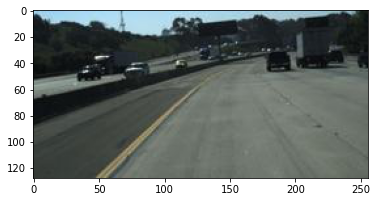

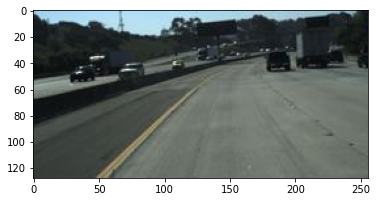

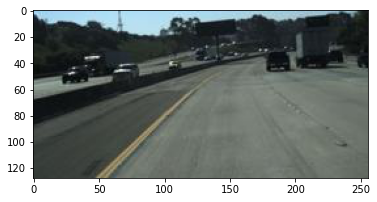

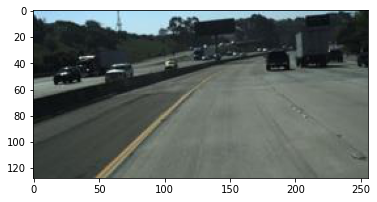

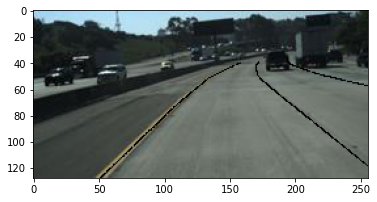

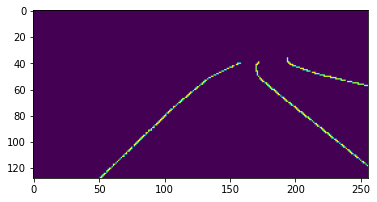

Train Epoch: 0 [0/91660 (0%)]	Loss: 0.000000
(128, 256, 1)


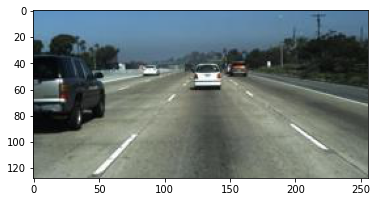

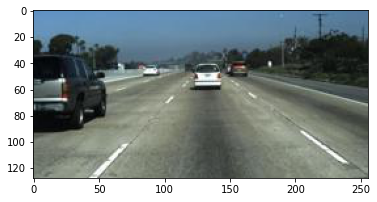

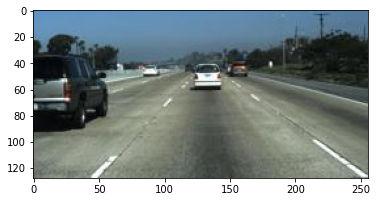

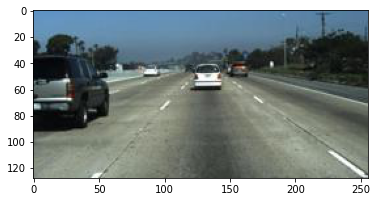

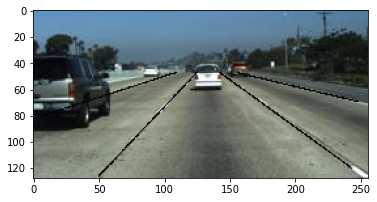

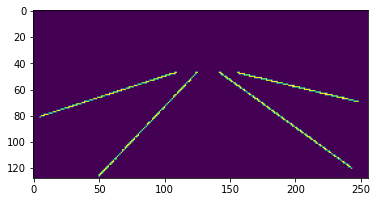

(128, 256, 1)


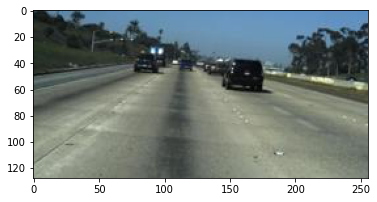

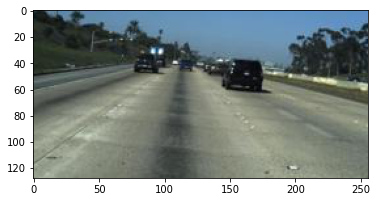

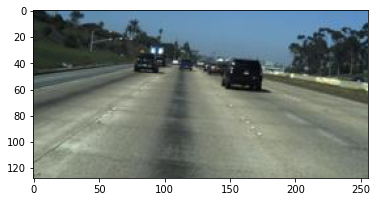

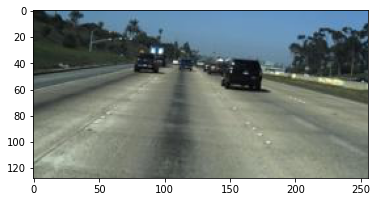

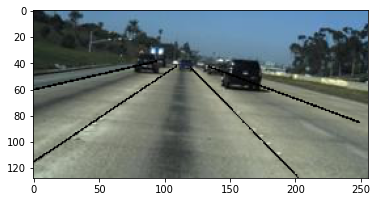

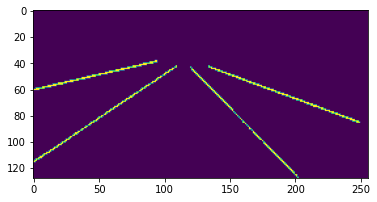

(128, 256, 1)


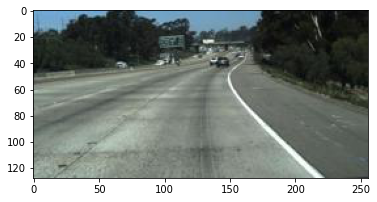

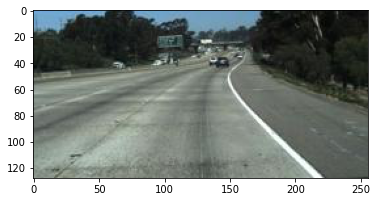

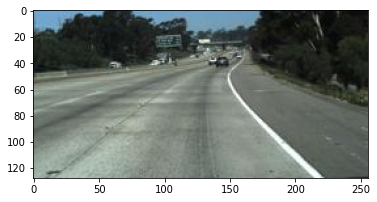

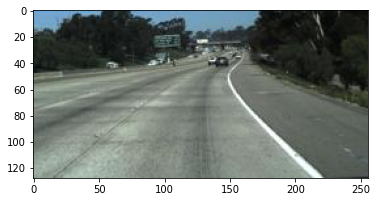

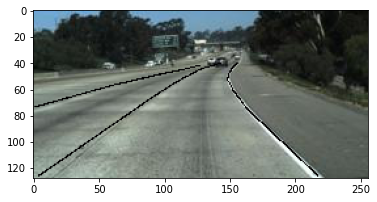

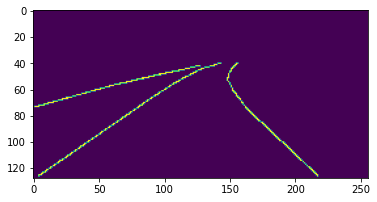

(128, 256, 1)


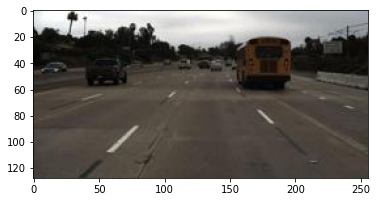

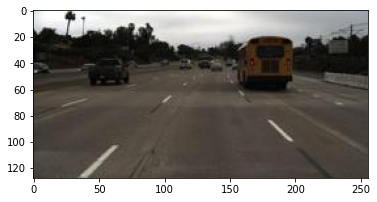

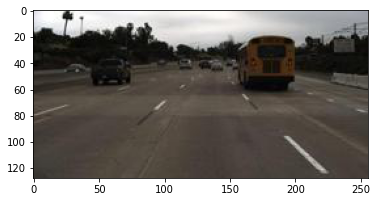

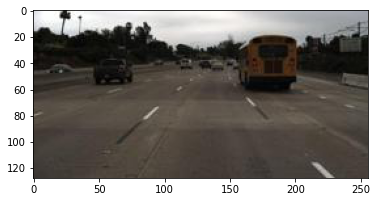

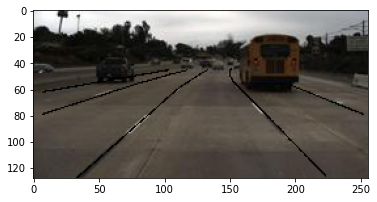

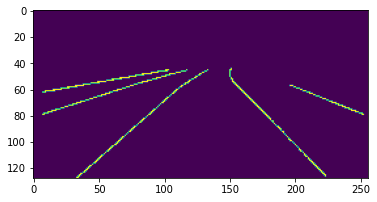

(128, 256, 1)


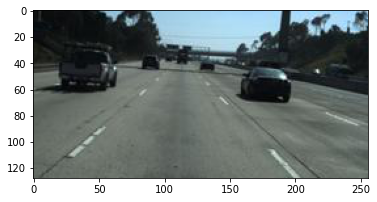

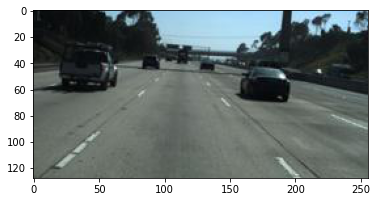

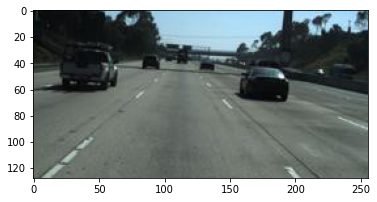

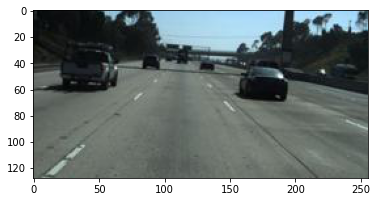

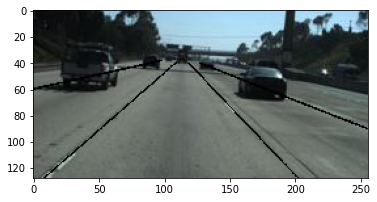

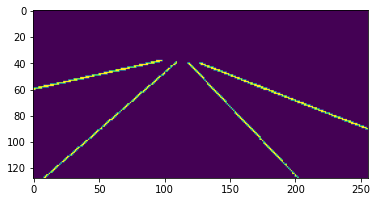

Train Epoch: 0 complete in 0m 9s


In [ ]:
from re import L
import tensorflow as tf
from tensorflow import keras
from tensorflow import data
from tensorflow.keras.preprocessing import image
from tensorflow.python.ops.numpy_ops.np_math_ops import isnan
import matplotlib.pyplot as plt
import time
# import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"
# import tensorflow as tf
# from torchvision import transforms
# from torch.optim import lr_scheduler


physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

def train(args, epoch, model, train_loader, optimizer, criterion):
    since = time.time()
    for batch_idx,  sample_batched in enumerate(train_loader):
        data, target = sample_batched['data'], sample_batched['label']
        # plt.imshow(data)
        np_data = np.array(data)
        np_target = np.array(target)
        print(np_target[0].shape)
        for i in range(128):
          for j in range(256):
            if np_target[0][i][j] == 1:
              np_data[0][4][i][j][0] = 0
              np_data[0][4][i][j][1] = 0
              np_data[0][4][i][j][2] = 0

        for i in range(5):
          plt.imshow(np_data[0][i])
          plt.show()
        np_target = np.squeeze((np_target[0]), axis = 2)
        plt.imshow(np_target)
        plt.show()
        if batch_idx == 5:
          break
        loss = 0
        # with tf.GradientTape() as tape:
        #     output, _ = model(data)
        #     # print(model.summary())
        #     output = tf.convert_to_tensor(output)
        #     # output = tf.keras.layers.Softmax(axis=-1)(output)
        #     # print(target.shape, output.shape)
            
        #     # loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=target, logits=output)
        #     print(target.shape)
        #     print(output.shape)
        #     weights = tf.cast(target, dtype=tf.float32) + 0.02
        #     loss = criterion(target, output, sample_weight=weights)
        #     # loss = tf.math.multiply(loss, weights)
            
        #     # print(loss)
        #     # loss = tf.clip_by_value(loss, clip_value_min=0, clip_value_max=float("inf"))
        #     loss = tf.reduce_mean(loss)
        #     # print(loss)
            
        # gradients = tape.gradient(loss, model.trainable_weights)
        # # print(gradients)
        # optimizer.apply_gradients(zip(gradients, model.trainable_weights))

        if batch_idx % args.log_interval == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, batch_idx * len(data), train_loader.dataset_size,
                100. * batch_idx / len(train_loader), loss))


    time_elapsed = time.time() - since
    print('Train Epoch: {} complete in {:.0f}m {:.0f}s'.format(epoch,
        time_elapsed // 60, time_elapsed % 60))

def val(args, model, val_loader, criterion, epoch):

    loss1= 0
    correct = 0

    for batch_idx, sample_batched in enumerate(val_loader):
        data, target = sample_batched['data'], sample_batched['label']
        
        
        output, _ = model(data)
        # print(model.summary())
        output = tf.convert_to_tensor(output)
        # output = tf.keras.layers.Softmax(axis=-1)(output)
        # print(target.shape, output.shape)
        
        loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=target, logits=output)
        # loss = criterion(target, output)
        weights = tf.cast(target, dtype=tf.float32) + 0.02
        loss = tf.math.multiply(loss, weights)
        
        # print(loss)
        # loss = tf.clip_by_value(loss, clip_value_min=0, clip_value_max=float("inf"))
        loss1 += tf.reduce_mean(loss)

        # pred = tf.math.reduce_max(output, axis = 3, keepdims=True)
        pred = tf.math.argmax(output, axis=3)
        temp = tf.cast(tf.math.equal(pred, tf.cast(target , dtype=tf.int64)), dtype = tf.int32)
        correct += tf.math.reduce_sum(temp)
        
        if batch_idx % (args.log_interval * 10) == 0:
            print(f"Batch[{batch_idx}] Accuracy: {100. * int(correct) / (val_loader.dataset_size * label_height * label_width):.5f}")
            
    loss1 /= (val_loader.dataset_size/args.test_batch_size)
    val_acc = 100. * int(correct) / (val_loader.dataset_size * label_height * label_width)
    print('\nAverage loss: {:.4f}, Accuracy: {}/{} ({:.5f}%)\n'.format(
        loss1, int(correct), (val_loader.dataset_size * label_height * label_width), val_acc))
    # model.save(model, '%s.pth'%val_acc)
    model.save_weights('epoch-{}_acc-{}'.format(epoch, val_acc))


if __name__ == '__main__':
    args = args_setting()
    tf.random.set_seed(args.seed)
    # use_cuda = args.cuda and tf.test.is_gpu_available()
    # device = tf.device("gpu" if use_cuda else "cpu")

    # turn image into floatTensor
    # op_tranforms = image.img_to_array()

    # load data for batches, num_workers for multiprocess
    if args.model == 'SegNet-ConvLSTM' or 'UNet-ConvLSTM':
        train_loader = RoadSequenceDatasetList(file_path=train_path, batch_size= args.batch_size, shuffle= True)
        val_loader = RoadSequenceDatasetList(file_path=val_path, batch_size= args.test_batch_size, shuffle= True)
    else:
        train_loader = RoadSequenceDataset(file_path=train_path, batch_size= args.batch_size, shuffle= True)
        val_loader = RoadSequenceDataset(file_path=val_path, batch_size= args.test_batch_size, shuffle= True)

    #load model
    model = generate_model(args)
    scheduler = tf.keras.optimizers.schedules.ExponentialDecay(args.lr, decay_steps=1, decay_rate=0.5, staircase=True)    
    optimizer = tf.keras.optimizers.Adam(learning_rate=scheduler)
    # optimizer = torch.optim.Adam([
    #     {'params': get_parameters(model, layer_name=["inc", "down1", "down2", "down3", "down4"]), 'lr': args.lr * 0.0},
    #     {'params': get_parameters(model, layer_name=["outc", "up1", "up2", "up3", "up4"]), 'lr': args.lr * 0.1},
    #     {'params': get_parameters(model, layer_name=["convlstm"]), 'lr': args.lr * 1},
    # ], lr=args.lr)
    # optimizer = torch.optim.SGD([
    #     {'params': get_parameters(model, layer_name=["conv1_block", "conv2_block", "conv3_block", "conv4_block", "conv5_block"]), 'lr': args.lr * 0.5},
    #     {'params': get_parameters(model, layer_name=["upconv5_block", "upconv4_block", "upconv3_block", "upconv2_block", "upconv1_block"]), 'lr': args.lr * 0.33},
    #     {'params': get_parameters(model, layer_name=["Conv3D_block"]), 'lr': args.lr * 0.5},
    # ], lr=args.lr,momentum=0.9)

    
    # class_weight = tf.convert_to_tensor(config.class_weight)
    class_weight = tf.convert_to_tensor([3.,3.,3.])

    # criterion = tf.nn.weighted_cross_entropy_with_logits(pos_weight=class_weight, name=None)
    # criterion = torch.nn.CrossEntropyLoss(weight=class_weight)
    criterion = tf.keras.losses.SparseCategoricalCrossentropy()
    # criterion = tf.keras.losses.CategoricalCrossentropy()
    # criterion = tf.nn.sparse_softmax_cross_entropy_with_logits()
    # criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    best_acc = 0

    # pretrained_dict = torch.load(config.pretrained_path)
    # model_dict = model.state_dict()

    # pretrained_dict_1 = {k: v for k, v in pretrained_dict.items() if (k in model_dict)}
    # model_dict.update(pretrained_dict_1)
    # model.load_state_dict(model_dict)

    # train
    
    
    # print(train_loader[0]['data'].shape)

    
    # for epoch in range(1, args.epochs+1):
    for epoch in range(1):
        train(args, epoch, model, train_loader, optimizer, criterion)
        # val(args, model, val_loader, criterion, epoch)
    # model.save_weights('model_epoch_5')

### Real Train - model.fit

In [2]:
from re import L
import tensorflow as tf
from tensorflow import keras
from tensorflow import data
from tensorflow.keras.preprocessing import image
from tensorflow.python.ops.numpy_ops.np_math_ops import isnan
import matplotlib.pyplot as plt
import time
# import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"
# import tensorflow as tf
# from torchvision import transforms
# from torch.optim import lr_scheduler

def WBCE(y_true, y_pred):
    epsilon = 1e-7
    return (-1)*tf.math.reduce_mean(tf.math.multiply(tf.math.log(y_pred + epsilon), y_true)*20 + tf.math.multiply(tf.math.log(1-y_pred + epsilon), 1-y_true))

physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

def train(args, epoch, model, train_loader, optimizer, criterion, batch_size):
    since = time.time()
    for batch_idx,  sample_batched in enumerate(train_loader):
        data, target = sample_batched['data'], sample_batched['label']
        data = tf.cast(data, dtype=tf.float32)
        target = tf.cast(target, dtype=tf.float32)
        np_data = np.array(data)
        np_target = np.array(target)
        loss = 0
        model.fit(x=data, y=target, batch_size=batch_size, shuffle=False, epochs=1)
        # print(output.shape)
        # with tf.GradientTape() as tape:
        #       output, _ = model(data)
        #     # print(model.summary())
        #     output = tf.convert_to_tensor(output)
        #     # output = tf.keras.layers.Softmax(axis=-1)(output)
        #     # print(target.shape, output.shape)
            
        #     # loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=target, logits=output)
        #     print(target.shape)
        #     print(output.shape)
        #     weights = tf.cast(target, dtype=tf.float32) + 0.02
        #     loss = criterion(target, output, sample_weight=weights)
        #     # loss = tf.math.multiply(loss, weights)
            
        #     # print(loss)
        #     # loss = tf.clip_by_value(loss, clip_value_min=0, clip_value_max=float("inf"))
        #     loss = tf.reduce_mean(loss)
        #     # print(loss)
            
        # gradients = tape.gradient(loss, model.trainable_weights)
        # # print(gradients)
        # optimizer.apply_gradients(zip(gradients, model.trainable_weights))

        if batch_idx % args.log_interval == 0:
            output = model(data)
            for_output = np.squeeze((output[0]), axis = 2)
            plt.imshow(for_output)
            plt.show()
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, batch_idx * len(data), train_loader.dataset_size,
                100. * batch_idx / len(train_loader), loss))


    time_elapsed = time.time() - since
    print('Train Epoch: {} complete in {:.0f}m {:.0f}s'.format(epoch,
        time_elapsed // 60, time_elapsed % 60))

def val(args, model, val_loader, criterion, epoch):

    loss1= 0
    correct = 0

    for batch_idx, sample_batched in enumerate(val_loader):
        data, target = sample_batched['data'], sample_batched['label']
        
        
        output, _ = model(data)
        # print(model.summary())
        output = tf.convert_to_tensor(output)
        # output = tf.keras.layers.Softmax(axis=-1)(output)
        # print(target.shape, output.shape)
        
        loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=target, logits=output)
        # loss = criterion(target, output)
        weights = tf.cast(target, dtype=tf.float32) + 0.02
        loss = tf.math.multiply(loss, weights)
        
        # print(loss)
        # loss = tf.clip_by_value(loss, clip_value_min=0, clip_value_max=float("inf"))
        loss1 += tf.reduce_mean(loss)

        # pred = tf.math.reduce_max(output, axis = 3, keepdims=True)
        pred = tf.math.argmax(output, axis=3)
        temp = tf.cast(tf.math.equal(pred, tf.cast(target , dtype=tf.int64)), dtype = tf.int32)
        correct += tf.math.reduce_sum(temp)
        
        if batch_idx % (args.log_interval * 10) == 0:
            print(f"Batch[{batch_idx}] Accuracy: {100. * int(correct) / (val_loader.dataset_size * label_height * label_width):.5f}")
            
    loss1 /= (val_loader.dataset_size/args.test_batch_size)
    val_acc = 100. * int(correct) / (val_loader.dataset_size * label_height * label_width)
    print('\nAverage loss: {:.4f}, Accuracy: {}/{} ({:.5f}%)\n'.format(
        loss1, int(correct), (val_loader.dataset_size * label_height * label_width), val_acc))
    # model.save(model, '%s.pth'%val_acc)
    model.save_weights('epoch-{}_acc-{}'.format(epoch, val_acc))


if __name__ == '__main__':
    args = args_setting()
    tf.random.set_seed(args.seed)
    # use_cuda = args.cuda and tf.test.is_gpu_available()
    # device = tf.device("gpu" if use_cuda else "cpu")

    # turn image into floatTensor
    # op_tranforms = image.img_to_array()

    # load data for batches, num_workers for multiprocess
    if args.model == 'SegNet-ConvLSTM' or 'UNet-ConvLSTM':
        train_loader = RoadSequenceDatasetList(file_path=train_path, batch_size= args.batch_size, shuffle= True)
        val_loader = RoadSequenceDatasetList(file_path=val_path, batch_size= args.test_batch_size, shuffle= True)
    else:
        train_loader = RoadSequenceDataset(file_path=train_path, batch_size= args.batch_size, shuffle= True)
        val_loader = RoadSequenceDataset(file_path=val_path, batch_size= args.test_batch_size, shuffle= True)

    #load model
    model = generate_model(args)
    
    model.compile(optimizer="Adam", loss=WBCE, metrics=[WBCE])
    # model.build(input_shape=(None,5,128,256,3))
    scheduler = tf.keras.optimizers.schedules.ExponentialDecay(args.lr, decay_steps=1, decay_rate=0.5, staircase=True)    
    optimizer = tf.keras.optimizers.Adam(learning_rate=scheduler)
    # optimizer = torch.optim.Adam([
    #     {'params': get_parameters(model, layer_name=["inc", "down1", "down2", "down3", "down4"]), 'lr': args.lr * 0.0},
    #     {'params': get_parameters(model, layer_name=["outc", "up1", "up2", "up3", "up4"]), 'lr': args.lr * 0.1},
    #     {'params': get_parameters(model, layer_name=["convlstm"]), 'lr': args.lr * 1},
    # ], lr=args.lr)
    # optimizer = torch.optim.SGD([
    #     {'params': get_parameters(model, layer_name=["conv1_block", "conv2_block", "conv3_block", "conv4_block", "conv5_block"]), 'lr': args.lr * 0.5},
    #     {'params': get_parameters(model, layer_name=["upconv5_block", "upconv4_block", "upconv3_block", "upconv2_block", "upconv1_block"]), 'lr': args.lr * 0.33},
    #     {'params': get_parameters(model, layer_name=["Conv3D_block"]), 'lr': args.lr * 0.5},
    # ], lr=args.lr,momentum=0.9)

    
    # class_weight = tf.convert_to_tensor(config.class_weight)
    class_weight = tf.convert_to_tensor([3.,3.,3.])

    # criterion = tf.nn.weighted_cross_entropy_with_logits(pos_weight=class_weight, name=None)
    # criterion = torch.nn.CrossEntropyLoss(weight=class_weight)
    criterion = tf.keras.losses.SparseCategoricalCrossentropy()
    # criterion = tf.keras.losses.CategoricalCrossentropy()
    # criterion = tf.nn.sparse_softmax_cross_entropy_with_logits()
    # criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    best_acc = 0

    # pretrained_dict = torch.load(config.pretrained_path)
    # model_dict = model.state_dict()

    # pretrained_dict_1 = {k: v for k, v in pretrained_dict.items() if (k in model_dict)}
    # model_dict.update(pretrained_dict_1)
    # model.load_state_dict(model_dict)

    # train
    
    
    # print(train_loader[0]['data'].shape)

    batch_size = args.batch_size
    # for epoch in range(1, args.epochs+1):
    for epoch in range(1):
        train(args, epoch, model, train_loader, optimizer, criterion, batch_size)
        # val(args, model, val_loader, criterion, epoch)
    # model.save_weights('model_epoch_5')

### GradientTape

In [ ]:
import os
from re import L
import tensorflow as tf
from tensorflow import keras
from tensorflow import data
from tensorflow.keras.preprocessing import image
from tensorflow.python.ops.numpy_ops.np_math_ops import isnan
import matplotlib.pyplot as plt
import time
# import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"
# import tensorflow as tf
# from torchvision import transforms
# from torch.optim import lr_scheduler

physical_devices = tf.config.experimental.list_physical_devices('GPU')
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

def WBCE(y_true, y_pred):
    epsilon = 1e-7
    return (-1)*tf.math.reduce_mean(tf.math.multiply(tf.math.log(y_pred + epsilon), y_true)*20 + tf.math.multiply(tf.math.log(1-y_pred + epsilon), 1-y_true))

def train(args, epoch, model, train_loader, optimizer, batch_size):
    since = time.time()
    for batch_idx,  sample_batched in enumerate(train_loader):
        data, target = sample_batched['data'], sample_batched['label']

        # print(output.shape)

        with tf.GradientTape() as tape:
            output = model(data)
            # output = tf.convert_to_tensor(output)
            loss = WBCE(target, output)
            
        gradients = tape.gradient(loss, model.trainable_variables)
        optimizer.apply_gradients(zip(gradients, model.trainable_variables))


        if batch_idx % args.log_interval == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, batch_idx * len(data), train_loader.dataset_size,
                100. * batch_idx / len(train_loader), loss))
            for_output = np.squeeze((output[0]), axis = 2)
            plt.imshow(for_output, cmap = 'gray')
            plt.show()

    time_elapsed = time.time() - since
    print('Train Epoch: {} complete in {:.0f}m {:.0f}s'.format(epoch,
        time_elapsed // 60, time_elapsed % 60))

def val(args, model, val_loader, epoch):

    loss1= 0
    correct = 0

    for batch_idx, sample_batched in enumerate(val_loader):
        data, target = sample_batched['data'], sample_batched['label']
        
        output = model(data)
        # output = tf.convert_to_tensor(output)
        
        loss = WBCE(target, output)
        # loss = tf.clip_by_value(loss, clip_value_min=0, clip_value_max=float("inf"))
        loss1 += tf.reduce_mean(loss)

        # pred = tf.math.reduce_max(output, axis = 3, keepdims=True)
        pred = tf.math.argmax(output, axis=3, output_type=tf.int32)
        temp = tf.cast(tf.math.equal(pred, tf.squeeze(tf.cast(target, dtype = tf.int32), axis = 3)), dtype = tf.int32)
        correct += tf.math.reduce_sum(temp)
        
        if batch_idx % (args.log_interval * 10) == 0:
            print(f"Batch[{batch_idx}] Accuracy: {100. * int(correct) / (val_loader.dataset_size * label_height * label_width):.5f}")
            
    loss1 /= (val_loader.dataset_size/args.test_batch_size)
    val_acc = 100. * int(correct) / (val_loader.dataset_size * label_height * label_width)
    print('\nAverage loss: {:.4f}, Accuracy: {}/{} ({:.5f}%)\n'.format(
        loss1, int(correct), (val_loader.dataset_size * label_height * label_width), val_acc))
    # model.save(model, '%s.pth'%val_acc)
    os.chdir('/content/drive/MyDrive/Robust_Lane_Detection/Result')
    model.save_weights('epoch-{}_acc-{}'.format(epoch, val_acc))

In [ ]:
if __name__ == '__main__':
    args = args_setting()
    tf.random.set_seed(args.seed)
    
    if args.model == 'SegNet-ConvLSTM' or 'UNet-ConvLSTM':
        train_loader = RoadSequenceDatasetList(file_path=train_path, batch_size= args.batch_size, shuffle= True)
        val_loader = RoadSequenceDatasetList(file_path=val_path, batch_size= args.test_batch_size, shuffle= True)
    else:
        train_loader = RoadSequenceDataset(file_path=train_path, batch_size= args.batch_size, shuffle= True)
        val_loader = RoadSequenceDataset(file_path=val_path, batch_size= args.test_batch_size, shuffle= True)
    model = generate_model(args)
    
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
    
    best_acc = 0
    # pretrained_dict = torch.load(config.pretrained_path)
    # model_dict = model.state_dict()

    # pretrained_dict_1 = {k: v for k, v in pretrained_dict.items() if (k in model_dict)}
    # model_dict.update(pretrained_dict_1)
    # model.load_state_dict(model_dict)
    batch_size = args.batch_size

Train Epoch: 0 [0/91660 (0%)]	Loss: 0.269736


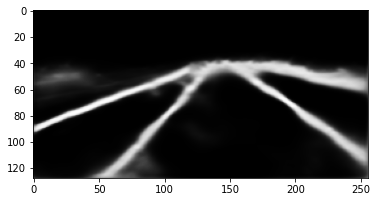

Train Epoch: 0 [50/91660 (0%)]	Loss: 0.286427


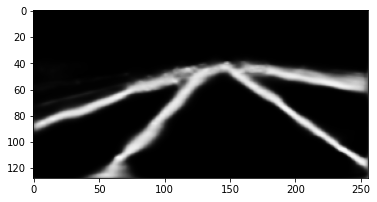

Train Epoch: 0 [100/91660 (0%)]	Loss: 0.289890


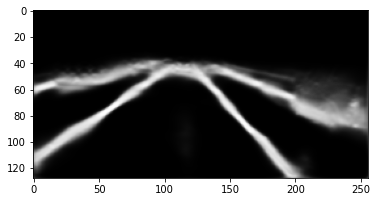

Train Epoch: 0 [150/91660 (0%)]	Loss: 0.318936


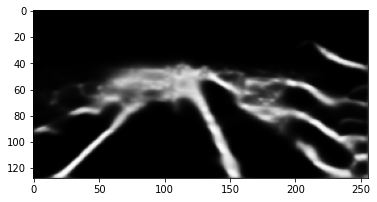

Train Epoch: 0 [200/91660 (0%)]	Loss: 0.254497


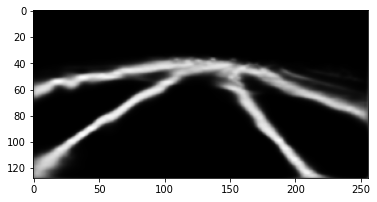

Train Epoch: 0 [250/91660 (0%)]	Loss: 0.276555


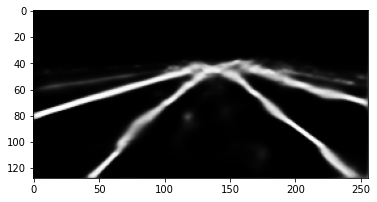

Train Epoch: 0 [300/91660 (0%)]	Loss: 0.252732


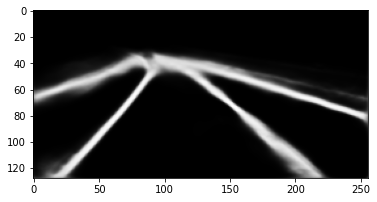

Train Epoch: 0 [350/91660 (0%)]	Loss: 0.308479


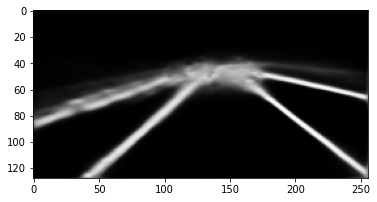

Train Epoch: 0 [400/91660 (0%)]	Loss: 0.224363


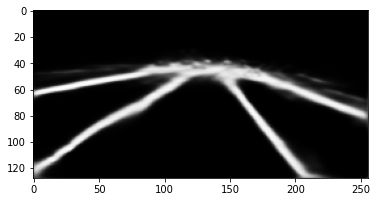

Train Epoch: 0 [450/91660 (0%)]	Loss: 0.179406


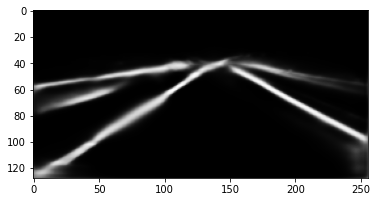

Train Epoch: 0 [500/91660 (1%)]	Loss: 0.237689


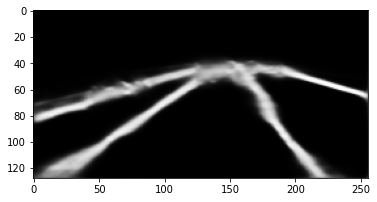

Train Epoch: 0 [550/91660 (1%)]	Loss: 0.278465


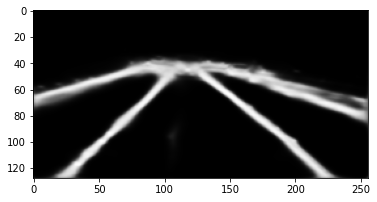

Train Epoch: 0 [600/91660 (1%)]	Loss: 0.223689


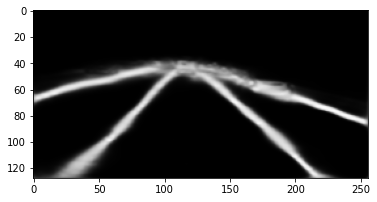

Train Epoch: 0 [650/91660 (1%)]	Loss: 0.178877


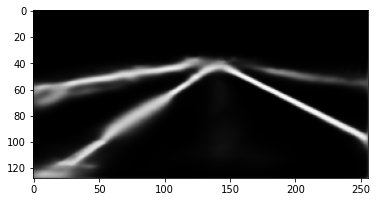

Train Epoch: 0 [700/91660 (1%)]	Loss: 0.352546


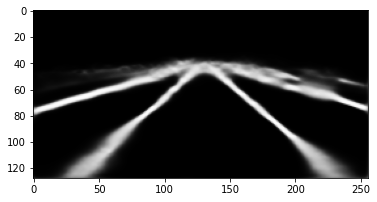

Train Epoch: 0 [750/91660 (1%)]	Loss: 0.234329


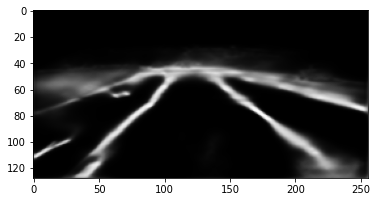

Train Epoch: 0 [800/91660 (1%)]	Loss: 0.240116


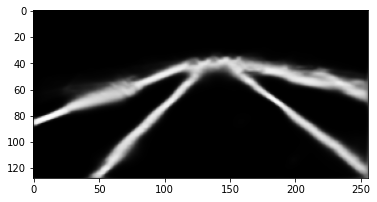

Train Epoch: 0 [850/91660 (1%)]	Loss: 0.253119


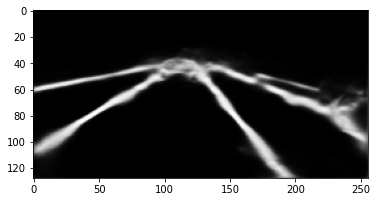

Train Epoch: 0 [900/91660 (1%)]	Loss: 0.340553


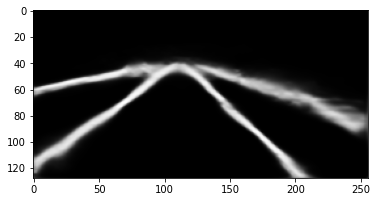

Train Epoch: 0 [950/91660 (1%)]	Loss: 0.338693


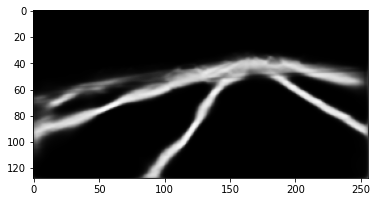

Train Epoch: 0 [1000/91660 (1%)]	Loss: 0.296014


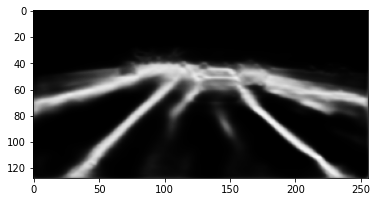

Train Epoch: 0 [1050/91660 (1%)]	Loss: 0.206547


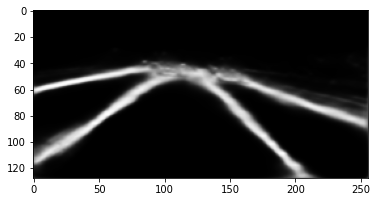

Train Epoch: 0 [1100/91660 (1%)]	Loss: 0.283004


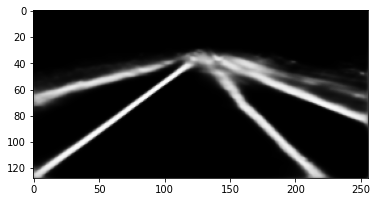

Train Epoch: 0 [1150/91660 (1%)]	Loss: 0.249994


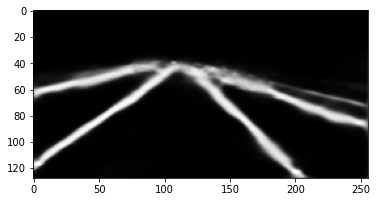

Train Epoch: 0 [1200/91660 (1%)]	Loss: 0.222749


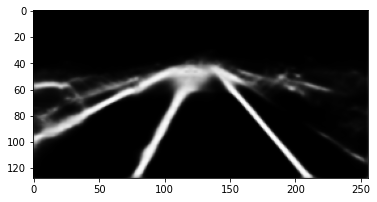

Train Epoch: 0 [1250/91660 (1%)]	Loss: 0.229900


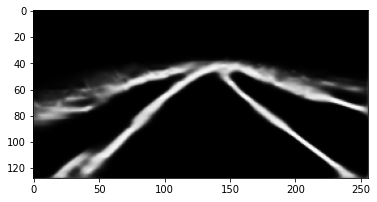

Train Epoch: 0 [1300/91660 (1%)]	Loss: 0.245810


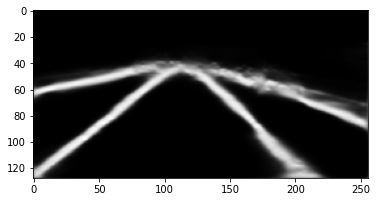

Train Epoch: 0 [1350/91660 (1%)]	Loss: 0.271402


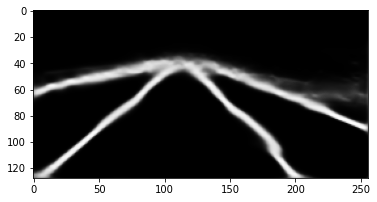

Train Epoch: 0 [1400/91660 (2%)]	Loss: 0.245214


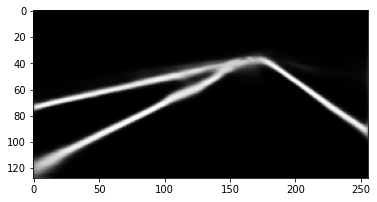

Train Epoch: 0 [1450/91660 (2%)]	Loss: 0.230381


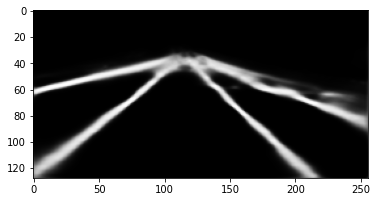

Train Epoch: 0 [1500/91660 (2%)]	Loss: 0.298135


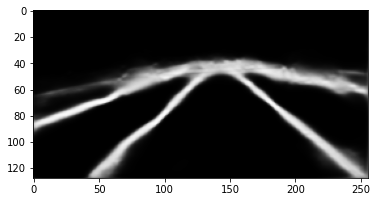

Train Epoch: 0 [1550/91660 (2%)]	Loss: 0.302020


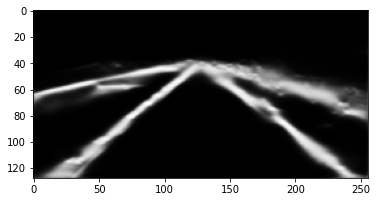

Train Epoch: 0 [1600/91660 (2%)]	Loss: 0.218523


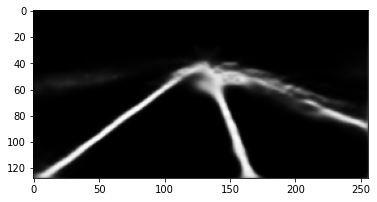

Train Epoch: 0 [1650/91660 (2%)]	Loss: 0.408406


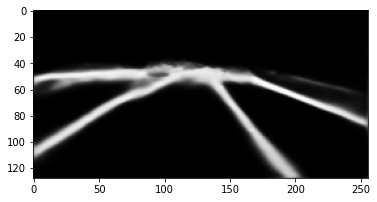

Train Epoch: 0 [1700/91660 (2%)]	Loss: 0.247449


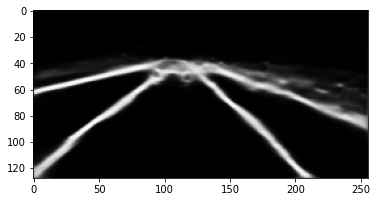

Train Epoch: 0 [1750/91660 (2%)]	Loss: 0.269829


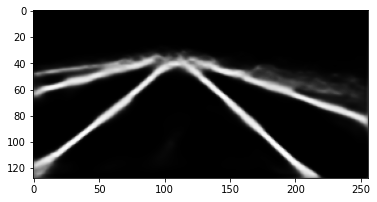

Train Epoch: 0 [1800/91660 (2%)]	Loss: 0.234341


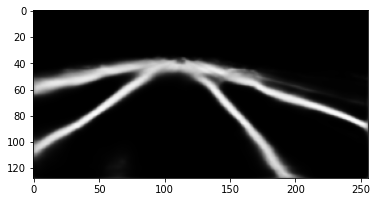

Train Epoch: 0 [1850/91660 (2%)]	Loss: 0.259323


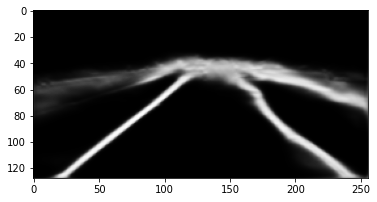

Train Epoch: 0 [1900/91660 (2%)]	Loss: 0.215521


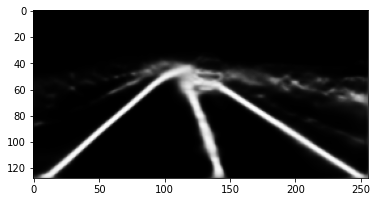

Train Epoch: 0 [1950/91660 (2%)]	Loss: 0.303264


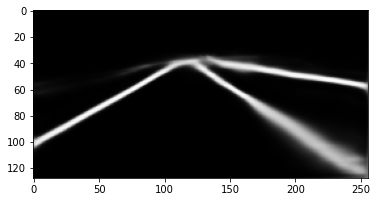

Train Epoch: 0 [2000/91660 (2%)]	Loss: 0.248228


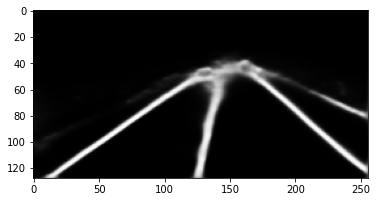

Train Epoch: 0 [2050/91660 (2%)]	Loss: 0.246562


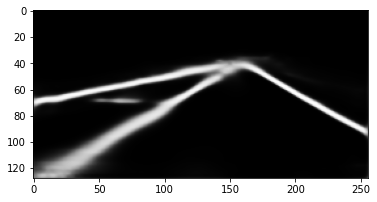

Train Epoch: 0 [2100/91660 (2%)]	Loss: 0.210181


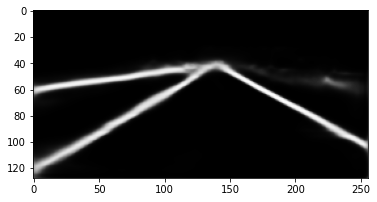

Train Epoch: 0 [2150/91660 (2%)]	Loss: 0.283810


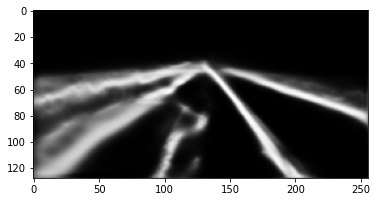

Train Epoch: 0 [2200/91660 (2%)]	Loss: 0.253746


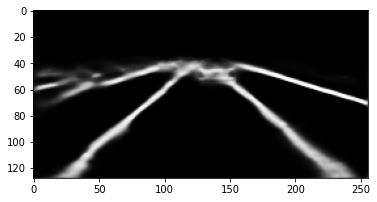

Train Epoch: 0 [2250/91660 (2%)]	Loss: 0.221851


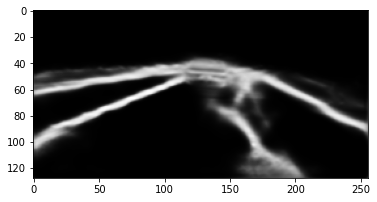

Train Epoch: 0 [2300/91660 (3%)]	Loss: 0.286855


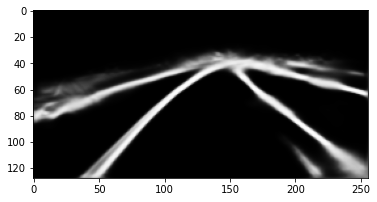

Train Epoch: 0 [2350/91660 (3%)]	Loss: 0.315299


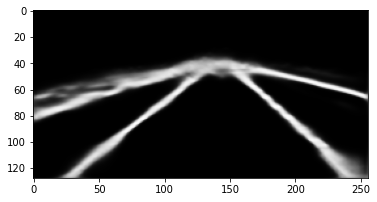

Train Epoch: 0 [2400/91660 (3%)]	Loss: 0.235754


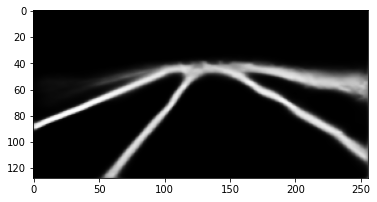

Train Epoch: 0 [2450/91660 (3%)]	Loss: 0.195289


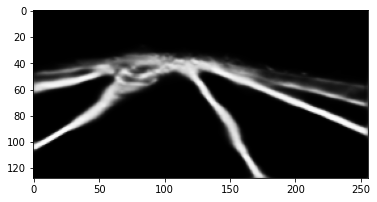

Train Epoch: 0 [2500/91660 (3%)]	Loss: 0.287561


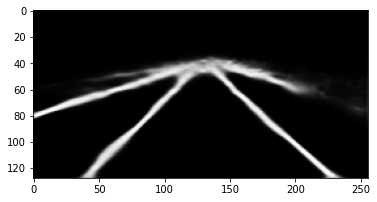

Train Epoch: 0 [2550/91660 (3%)]	Loss: 0.191033


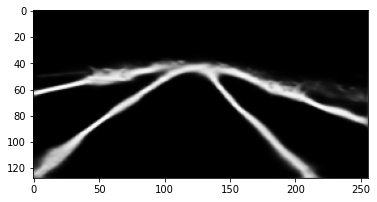

Train Epoch: 0 [2600/91660 (3%)]	Loss: 0.307689


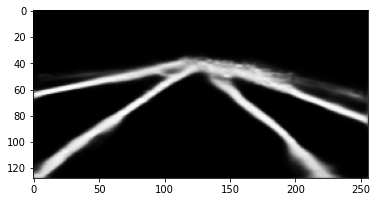

Train Epoch: 0 [2650/91660 (3%)]	Loss: 0.245474


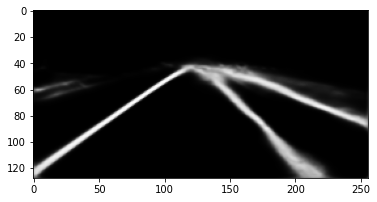

Train Epoch: 0 [2700/91660 (3%)]	Loss: 0.252653


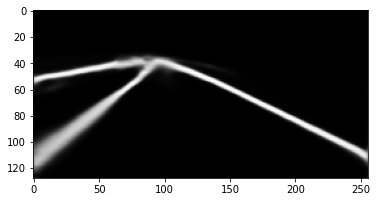

Train Epoch: 0 [2750/91660 (3%)]	Loss: 0.162071


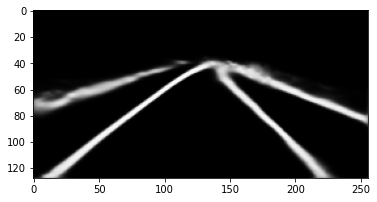

Train Epoch: 0 [2800/91660 (3%)]	Loss: 0.221736


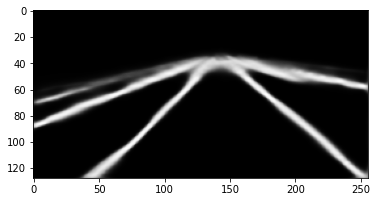

Train Epoch: 0 [2850/91660 (3%)]	Loss: 0.240479


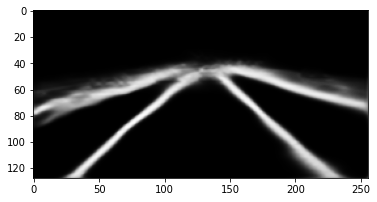

Train Epoch: 0 [2900/91660 (3%)]	Loss: 0.204744


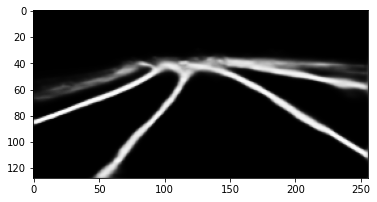

Train Epoch: 0 [2950/91660 (3%)]	Loss: 0.275002


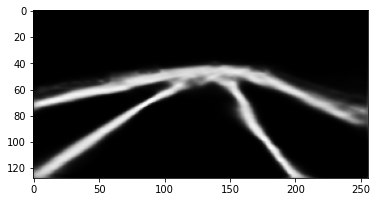

Train Epoch: 0 [3000/91660 (3%)]	Loss: 0.262922


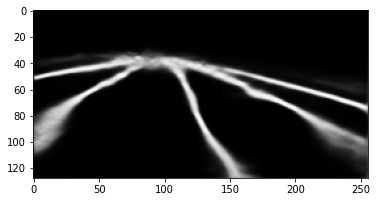

Train Epoch: 0 [3050/91660 (3%)]	Loss: 0.258550


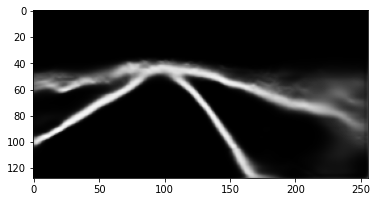

Train Epoch: 0 [3100/91660 (3%)]	Loss: 0.274499


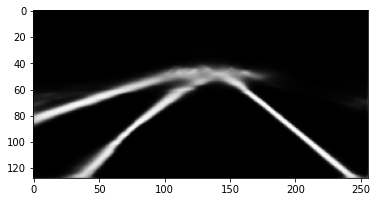

Train Epoch: 0 [3150/91660 (3%)]	Loss: 0.242358


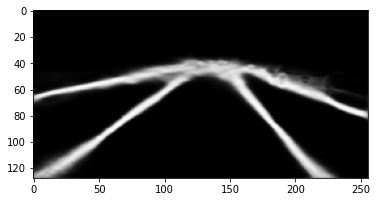

Train Epoch: 0 [3200/91660 (3%)]	Loss: 0.287245


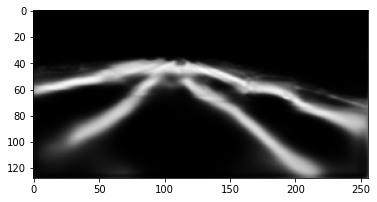

Train Epoch: 0 [3250/91660 (4%)]	Loss: 0.249212


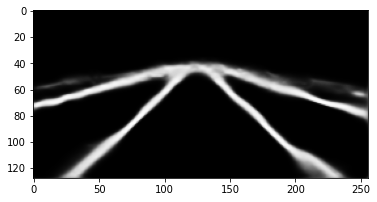

Train Epoch: 0 [3300/91660 (4%)]	Loss: 0.175272


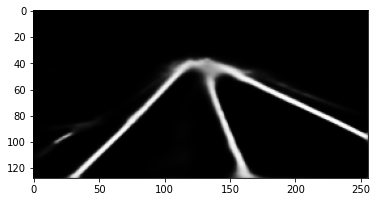

Train Epoch: 0 [3350/91660 (4%)]	Loss: 0.240302


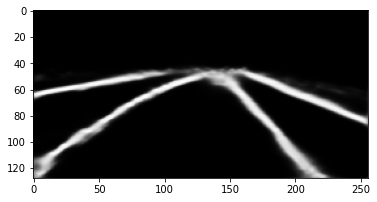

Train Epoch: 0 [3400/91660 (4%)]	Loss: 0.235078


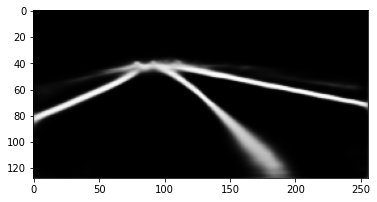

Train Epoch: 0 [3450/91660 (4%)]	Loss: 0.302648


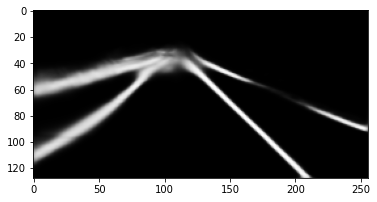

Train Epoch: 0 [3500/91660 (4%)]	Loss: 0.205132


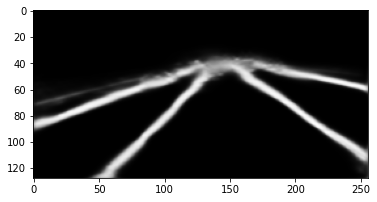

Train Epoch: 0 [3550/91660 (4%)]	Loss: 0.245622


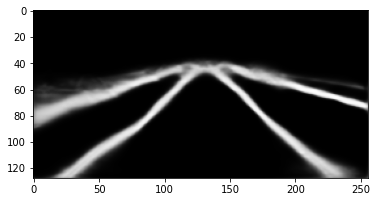

Train Epoch: 0 [3600/91660 (4%)]	Loss: 0.170638


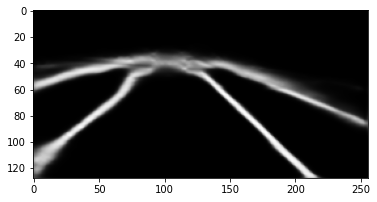

Train Epoch: 0 [3650/91660 (4%)]	Loss: 0.223851


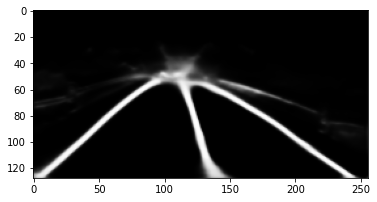

Train Epoch: 0 [3700/91660 (4%)]	Loss: 0.278082


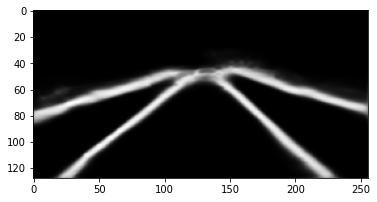

Train Epoch: 0 [3750/91660 (4%)]	Loss: 0.203345


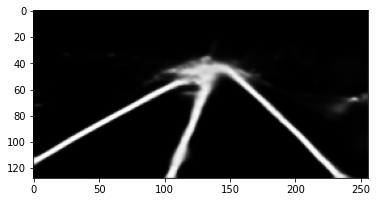

Train Epoch: 0 [3800/91660 (4%)]	Loss: 0.271411


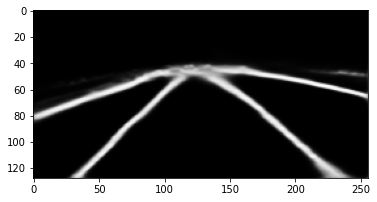

Train Epoch: 0 [3850/91660 (4%)]	Loss: 0.249547


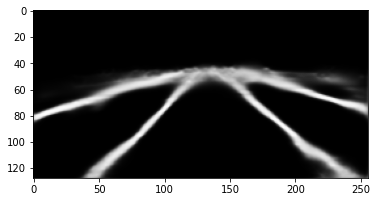

Train Epoch: 0 [3900/91660 (4%)]	Loss: 0.211569


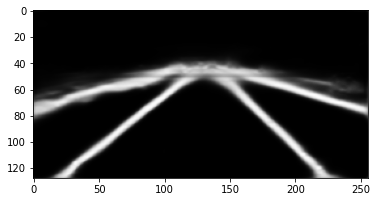

Train Epoch: 0 [3950/91660 (4%)]	Loss: 0.253007


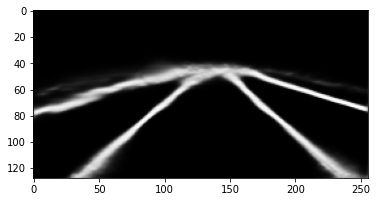

Train Epoch: 0 [4000/91660 (4%)]	Loss: 0.323642


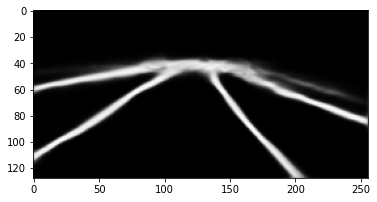

Train Epoch: 0 [4050/91660 (4%)]	Loss: 0.319091


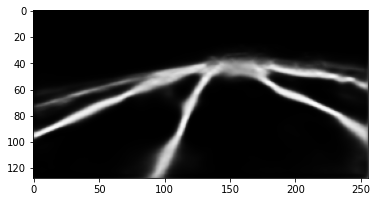

Train Epoch: 0 [4100/91660 (4%)]	Loss: 0.279030


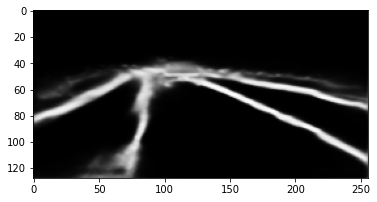

Train Epoch: 0 [4150/91660 (5%)]	Loss: 0.226890


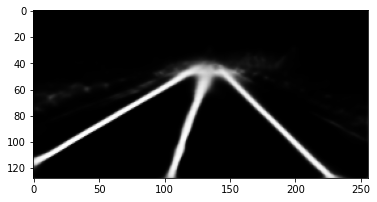

Train Epoch: 0 [4200/91660 (5%)]	Loss: 0.301625


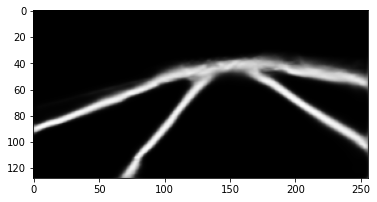

Train Epoch: 0 [4250/91660 (5%)]	Loss: 0.241674


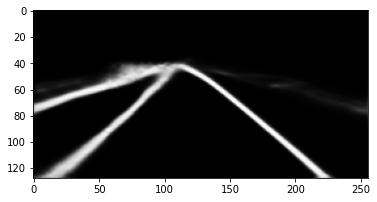

Train Epoch: 0 [4300/91660 (5%)]	Loss: 0.212387


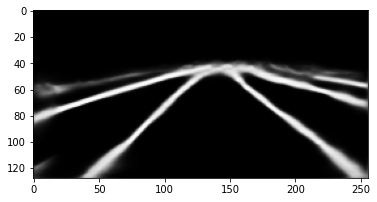

Train Epoch: 0 [4350/91660 (5%)]	Loss: 0.248313


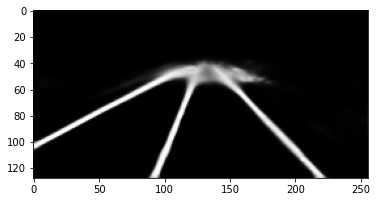

Train Epoch: 0 [4400/91660 (5%)]	Loss: 0.229387


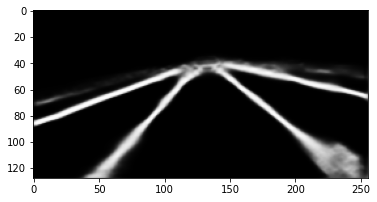

Train Epoch: 0 [4450/91660 (5%)]	Loss: 0.234301


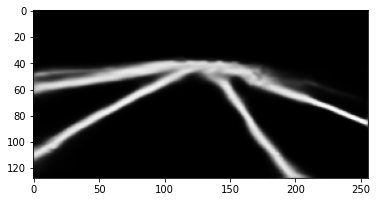

Train Epoch: 0 [4500/91660 (5%)]	Loss: 0.269195


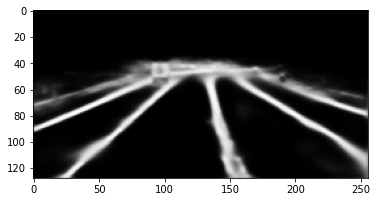

Train Epoch: 0 [4550/91660 (5%)]	Loss: 0.200053


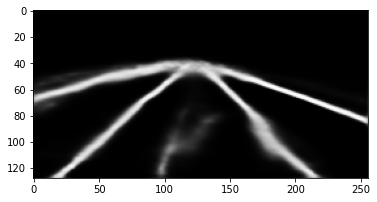

Train Epoch: 0 [4600/91660 (5%)]	Loss: 0.220147


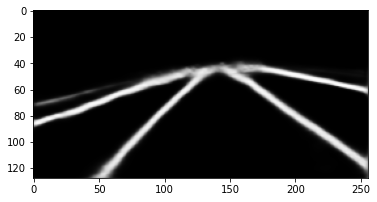

Train Epoch: 0 [4650/91660 (5%)]	Loss: 0.169407


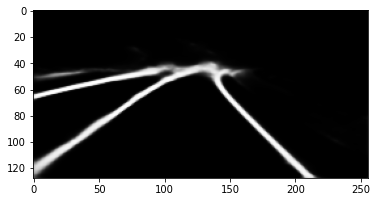

Train Epoch: 0 [4700/91660 (5%)]	Loss: 0.190173


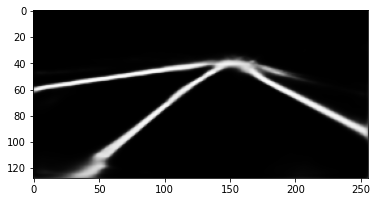

Train Epoch: 0 [4750/91660 (5%)]	Loss: 0.276835


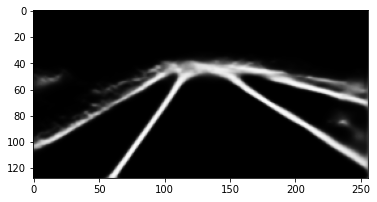

Train Epoch: 0 [4800/91660 (5%)]	Loss: 0.214019


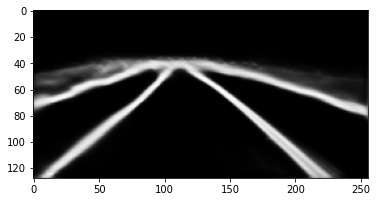

Train Epoch: 0 [4850/91660 (5%)]	Loss: 0.187088


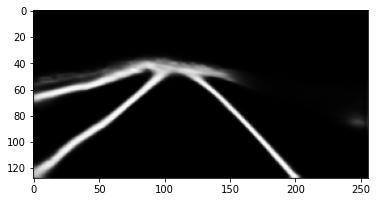

Train Epoch: 0 [4900/91660 (5%)]	Loss: 0.233218


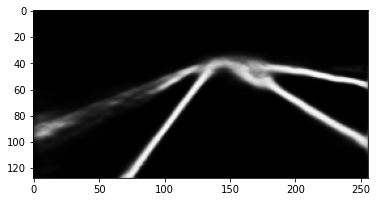

Train Epoch: 0 [4950/91660 (5%)]	Loss: 0.241071


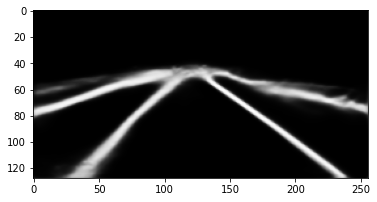

Train Epoch: 0 [5000/91660 (5%)]	Loss: 0.272060


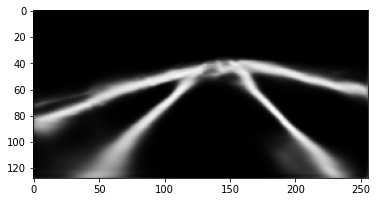

Train Epoch: 0 [5050/91660 (6%)]	Loss: 0.201482


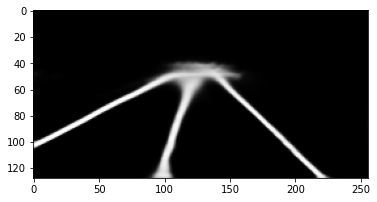

Train Epoch: 0 [5100/91660 (6%)]	Loss: 0.234259


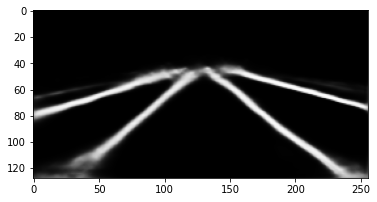

Train Epoch: 0 [5150/91660 (6%)]	Loss: 0.294524


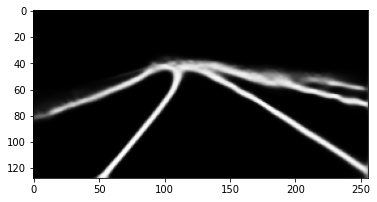

Train Epoch: 0 [5200/91660 (6%)]	Loss: 0.291722


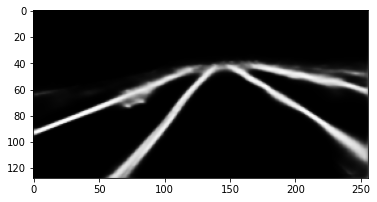

Train Epoch: 0 [5250/91660 (6%)]	Loss: 0.237181


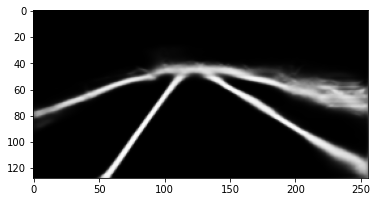

Train Epoch: 0 [5300/91660 (6%)]	Loss: 0.207258


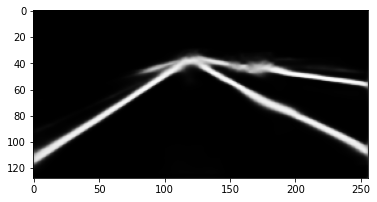

Train Epoch: 0 [5350/91660 (6%)]	Loss: 0.264509


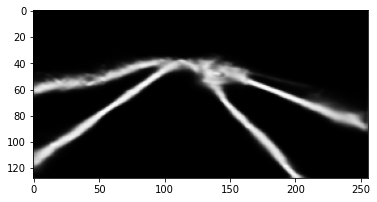

Train Epoch: 0 [5400/91660 (6%)]	Loss: 0.301201


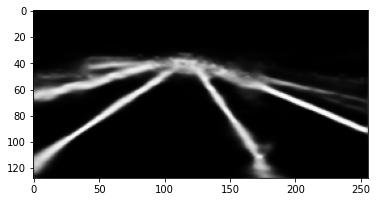

Train Epoch: 0 [5450/91660 (6%)]	Loss: 0.209527


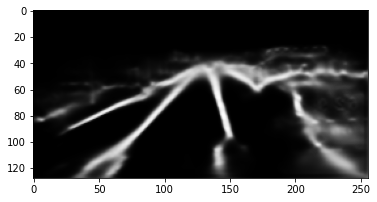

Train Epoch: 0 [5500/91660 (6%)]	Loss: 0.166548


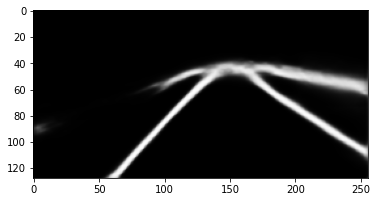

Train Epoch: 0 [5550/91660 (6%)]	Loss: 0.222352


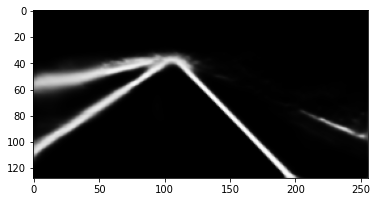

Train Epoch: 0 [5600/91660 (6%)]	Loss: 0.251379


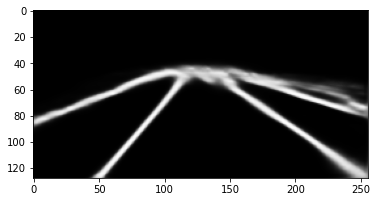

Train Epoch: 0 [5650/91660 (6%)]	Loss: 0.228190


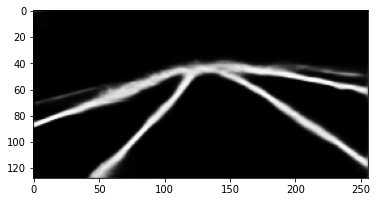

Train Epoch: 0 [5700/91660 (6%)]	Loss: 0.188187


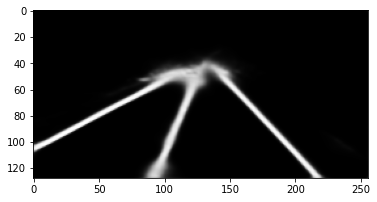

Train Epoch: 0 [5750/91660 (6%)]	Loss: 0.264728


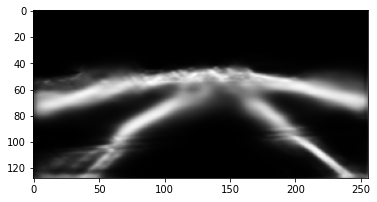

Train Epoch: 0 [5800/91660 (6%)]	Loss: 0.264355


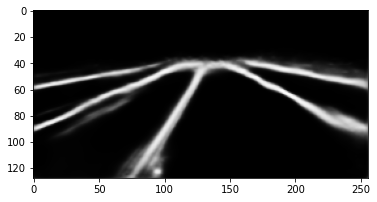

Train Epoch: 0 [5850/91660 (6%)]	Loss: 0.198474


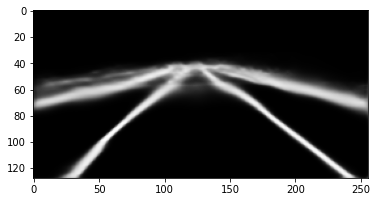

Train Epoch: 0 [5900/91660 (6%)]	Loss: 0.192597


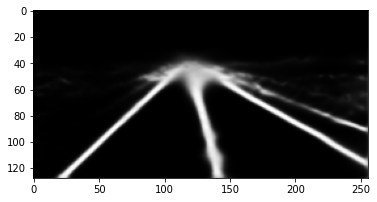

Train Epoch: 0 [5950/91660 (6%)]	Loss: 0.175512


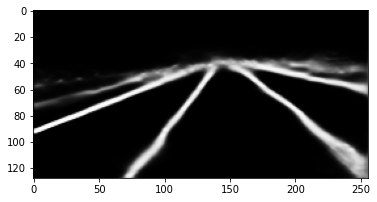

Train Epoch: 0 [6000/91660 (7%)]	Loss: 0.209469


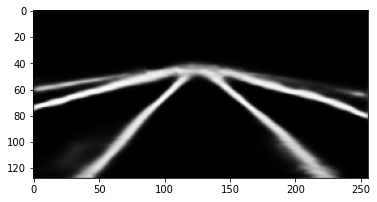

Train Epoch: 0 [6050/91660 (7%)]	Loss: 0.167810


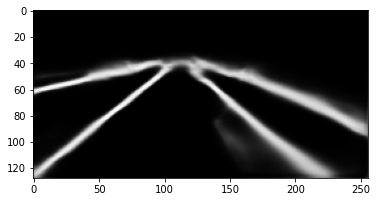

Train Epoch: 0 [6100/91660 (7%)]	Loss: 0.199809


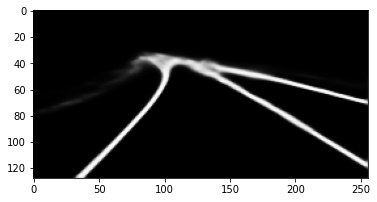

Train Epoch: 0 [6150/91660 (7%)]	Loss: 0.210682


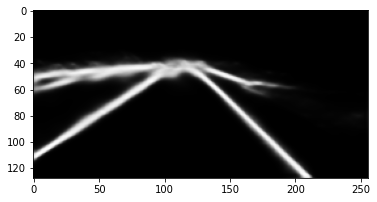

Train Epoch: 0 [6200/91660 (7%)]	Loss: 0.189178


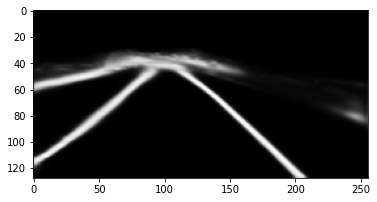

Train Epoch: 0 [6250/91660 (7%)]	Loss: 0.264642


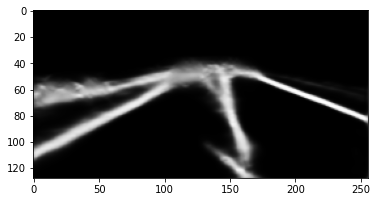

Train Epoch: 0 [6300/91660 (7%)]	Loss: 0.204949


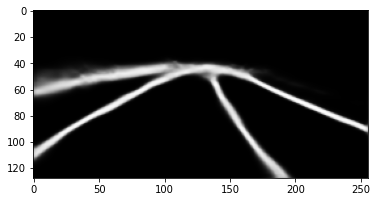

Train Epoch: 0 [6350/91660 (7%)]	Loss: 0.217938


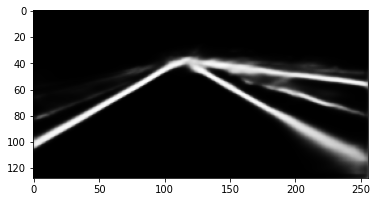

Train Epoch: 0 [6400/91660 (7%)]	Loss: 0.230370


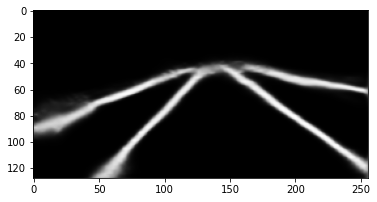

Train Epoch: 0 [6450/91660 (7%)]	Loss: 0.282416


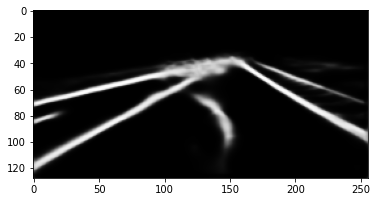

Train Epoch: 0 [6500/91660 (7%)]	Loss: 0.207736


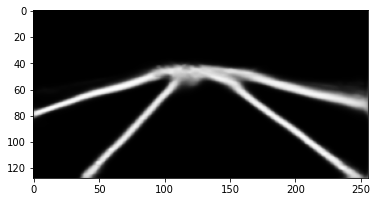

Train Epoch: 0 [6550/91660 (7%)]	Loss: 0.222080


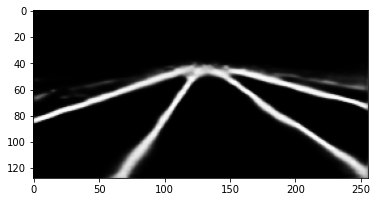

Train Epoch: 0 [6600/91660 (7%)]	Loss: 0.232912


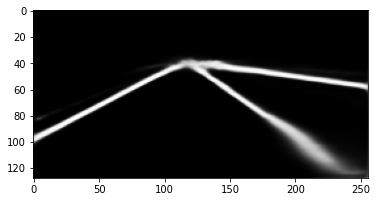

Train Epoch: 0 [6650/91660 (7%)]	Loss: 0.239089


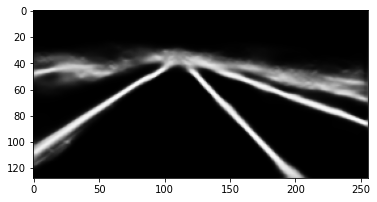

Train Epoch: 0 [6700/91660 (7%)]	Loss: 0.281177


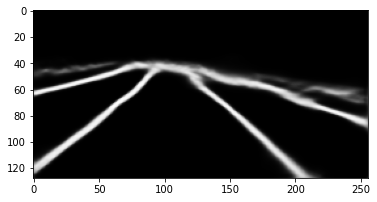

Train Epoch: 0 [6750/91660 (7%)]	Loss: 0.223914


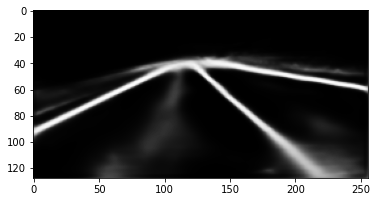

Train Epoch: 0 [6800/91660 (7%)]	Loss: 0.215774


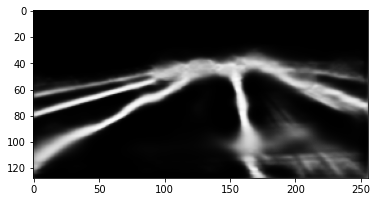

Train Epoch: 0 [6850/91660 (7%)]	Loss: 0.226621


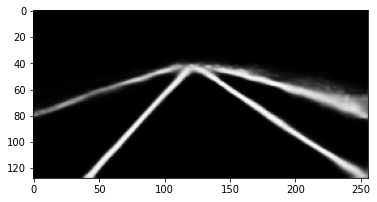

Train Epoch: 0 [6900/91660 (8%)]	Loss: 0.218009


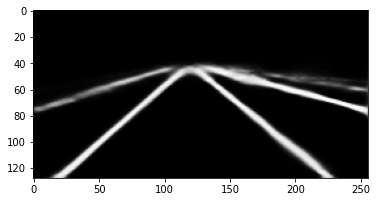

Train Epoch: 0 [6950/91660 (8%)]	Loss: 0.215904


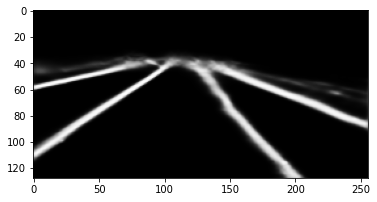

Train Epoch: 0 [7000/91660 (8%)]	Loss: 0.220010


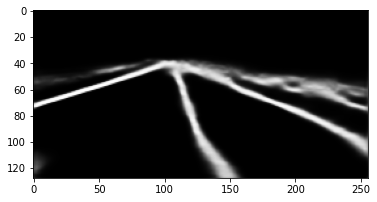

Train Epoch: 0 [7050/91660 (8%)]	Loss: 0.195364


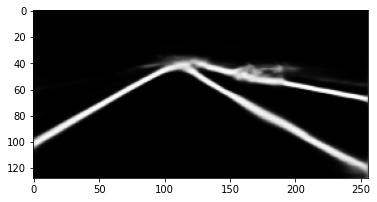

Train Epoch: 0 [7100/91660 (8%)]	Loss: 0.227293


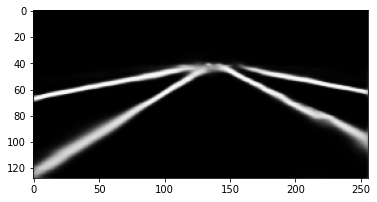

Train Epoch: 0 [7150/91660 (8%)]	Loss: 0.252896


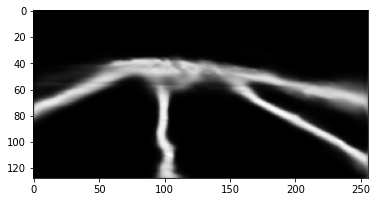

Train Epoch: 0 [7200/91660 (8%)]	Loss: 0.243079


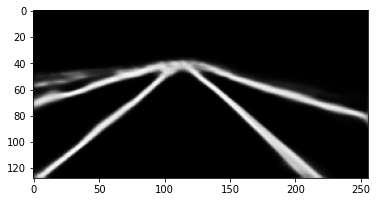

Train Epoch: 0 [7250/91660 (8%)]	Loss: 0.169799


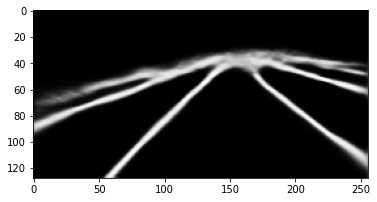

Train Epoch: 0 [7300/91660 (8%)]	Loss: 0.236745


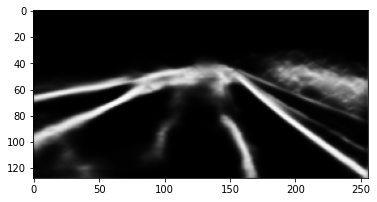

Train Epoch: 0 [7350/91660 (8%)]	Loss: 0.186588


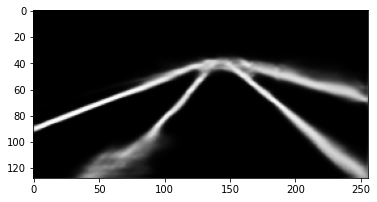

Train Epoch: 0 [7400/91660 (8%)]	Loss: 0.230905


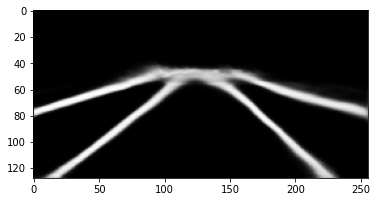

Train Epoch: 0 [7450/91660 (8%)]	Loss: 0.245261


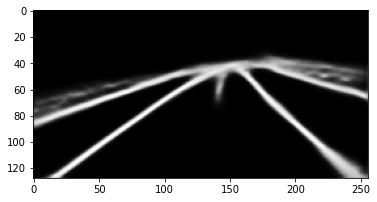

Train Epoch: 0 [7500/91660 (8%)]	Loss: 0.213133


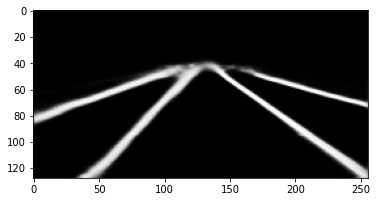

Train Epoch: 0 [7550/91660 (8%)]	Loss: 0.186200


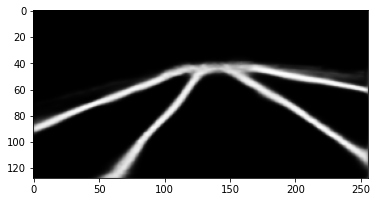

Train Epoch: 0 [7600/91660 (8%)]	Loss: 0.188005


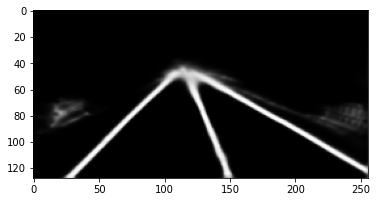

Train Epoch: 0 [7650/91660 (8%)]	Loss: 0.194793


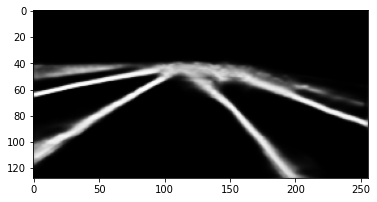

Train Epoch: 0 [7700/91660 (8%)]	Loss: 0.151705


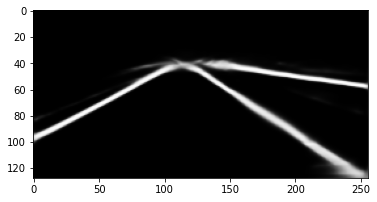

Train Epoch: 0 [7750/91660 (8%)]	Loss: 0.225121


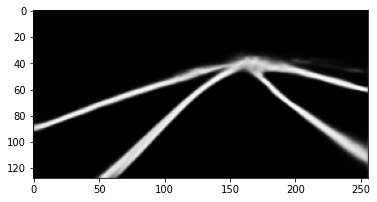

Train Epoch: 0 [7800/91660 (9%)]	Loss: 0.206667


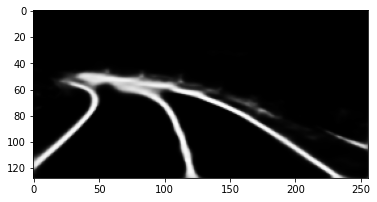

Train Epoch: 0 [7850/91660 (9%)]	Loss: 0.245752


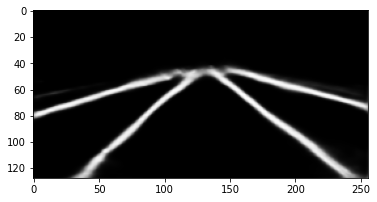

Train Epoch: 0 [7900/91660 (9%)]	Loss: 0.149676


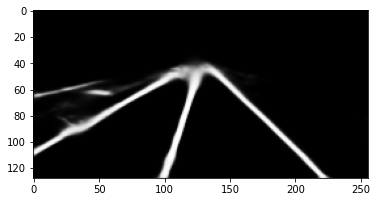

Train Epoch: 0 [7950/91660 (9%)]	Loss: 0.197672


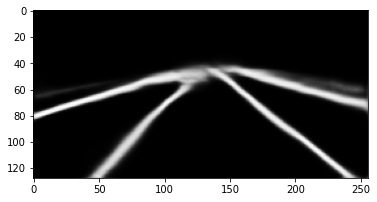

Train Epoch: 0 [8000/91660 (9%)]	Loss: 0.285288


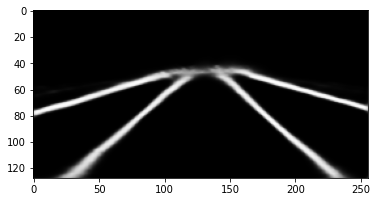

Train Epoch: 0 [8050/91660 (9%)]	Loss: 0.190753


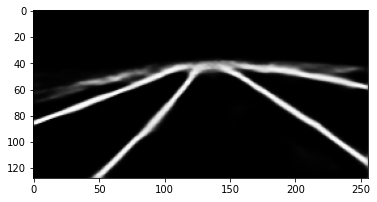

Train Epoch: 0 [8100/91660 (9%)]	Loss: 0.177123


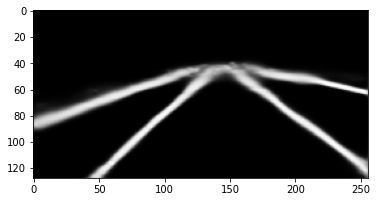

Train Epoch: 0 [8150/91660 (9%)]	Loss: 0.161399


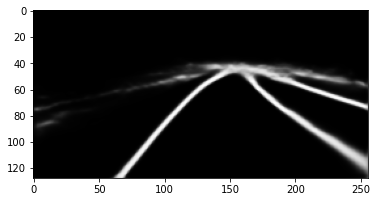

Train Epoch: 0 [8200/91660 (9%)]	Loss: 0.167068


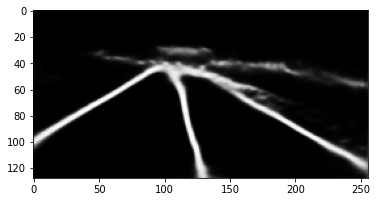

Train Epoch: 0 [8250/91660 (9%)]	Loss: 0.228792


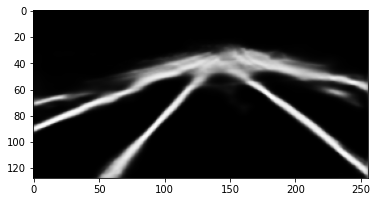

Train Epoch: 0 [8300/91660 (9%)]	Loss: 0.304611


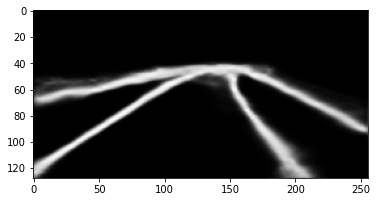

Train Epoch: 0 [8350/91660 (9%)]	Loss: 0.207093


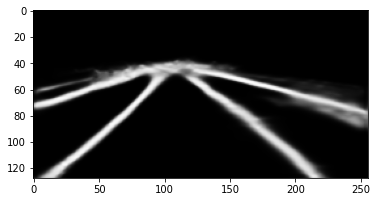

Train Epoch: 0 [8400/91660 (9%)]	Loss: 0.215304


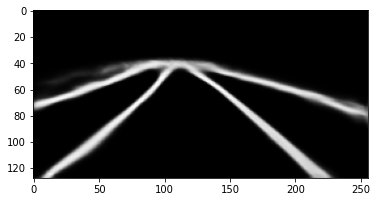

Train Epoch: 0 [8450/91660 (9%)]	Loss: 0.243076


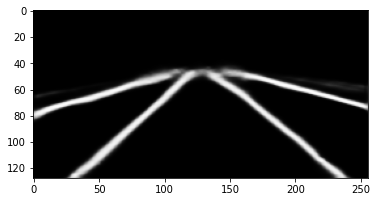

Train Epoch: 0 [8500/91660 (9%)]	Loss: 0.235589


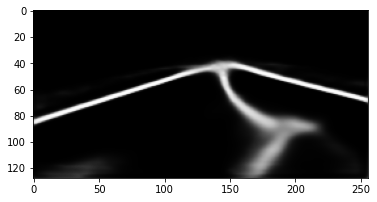

Train Epoch: 0 [8550/91660 (9%)]	Loss: 0.278849


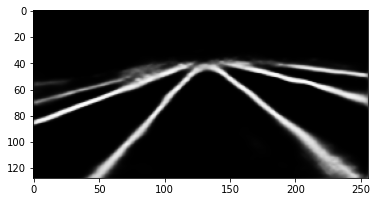

Train Epoch: 0 [8600/91660 (9%)]	Loss: 0.282654


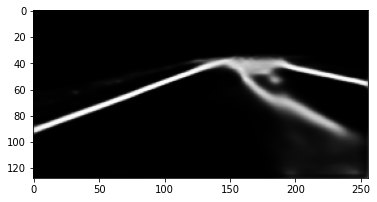

Train Epoch: 0 [8650/91660 (9%)]	Loss: 0.180607


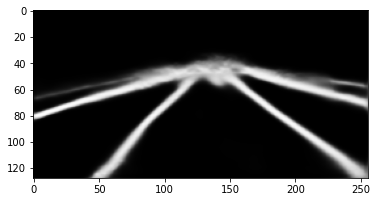

Train Epoch: 0 [8700/91660 (9%)]	Loss: 0.197923


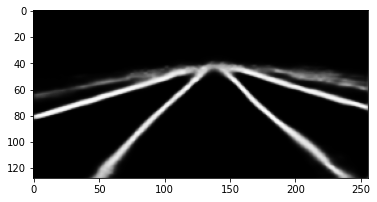

Train Epoch: 0 [8750/91660 (10%)]	Loss: 0.179896


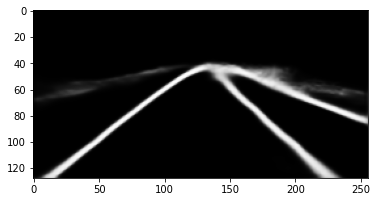

Train Epoch: 0 [8800/91660 (10%)]	Loss: 0.231855


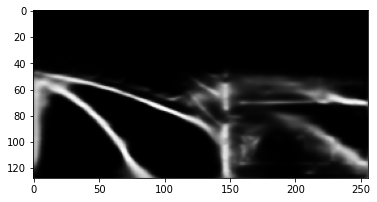

Train Epoch: 0 [8850/91660 (10%)]	Loss: 0.223021


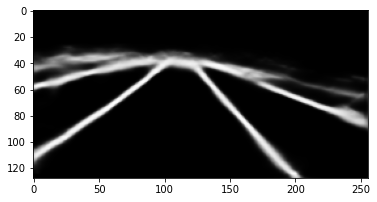

Train Epoch: 0 [8900/91660 (10%)]	Loss: 0.229799


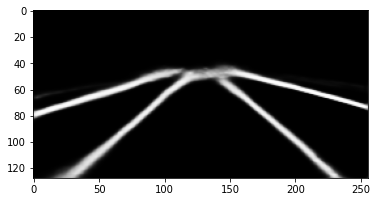

Train Epoch: 0 [8950/91660 (10%)]	Loss: 0.233517


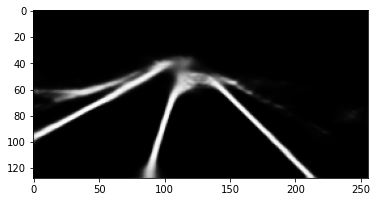

Train Epoch: 0 [9000/91660 (10%)]	Loss: 0.321305


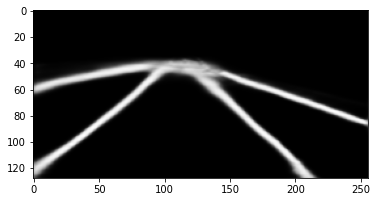

Train Epoch: 0 [9050/91660 (10%)]	Loss: 0.177011


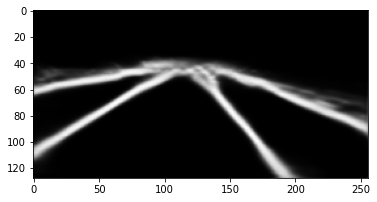

Train Epoch: 0 [9100/91660 (10%)]	Loss: 0.240596


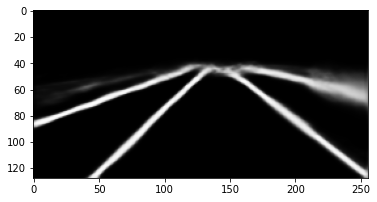

Train Epoch: 0 [9150/91660 (10%)]	Loss: 0.189064


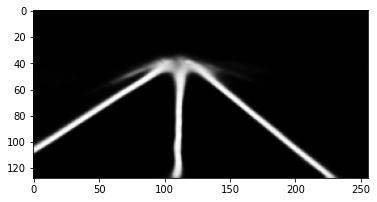

Train Epoch: 0 [9200/91660 (10%)]	Loss: 0.275684


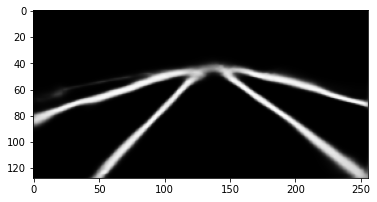

Train Epoch: 0 [9250/91660 (10%)]	Loss: 0.223332


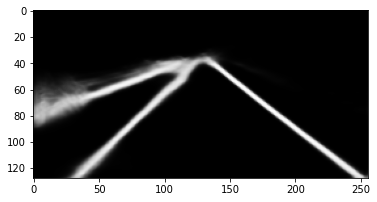

Train Epoch: 0 [9300/91660 (10%)]	Loss: 0.175357


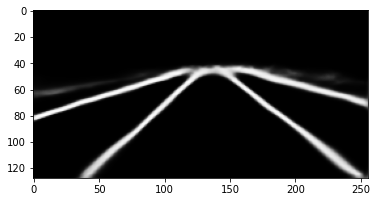

Train Epoch: 0 [9350/91660 (10%)]	Loss: 0.261481


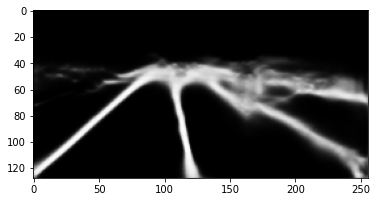

Train Epoch: 0 [9400/91660 (10%)]	Loss: 0.280129


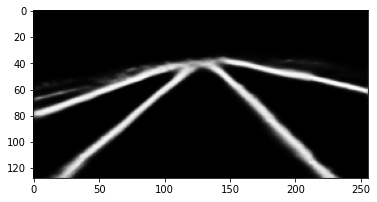

Train Epoch: 0 [9450/91660 (10%)]	Loss: 0.245177


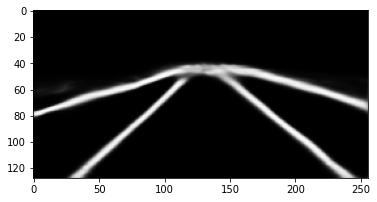

Train Epoch: 0 [9500/91660 (10%)]	Loss: 0.215449


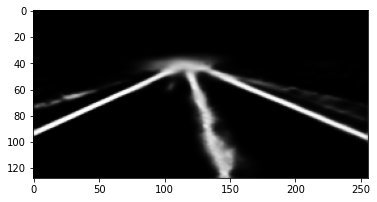

Train Epoch: 0 [9550/91660 (10%)]	Loss: 0.184777


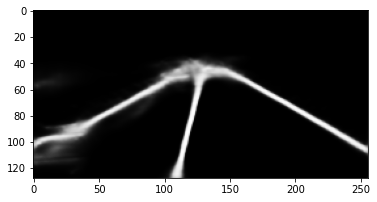

Train Epoch: 0 [9600/91660 (10%)]	Loss: 0.235820


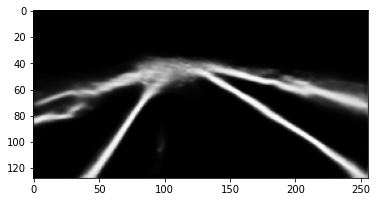

Train Epoch: 0 [9650/91660 (11%)]	Loss: 0.165359


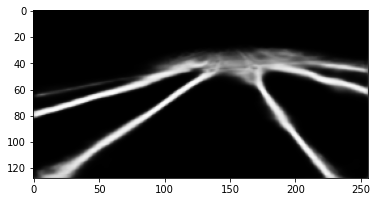

Train Epoch: 0 [9700/91660 (11%)]	Loss: 0.163601


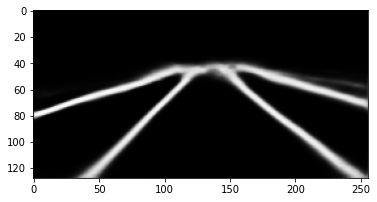

Train Epoch: 0 [9750/91660 (11%)]	Loss: 0.241315


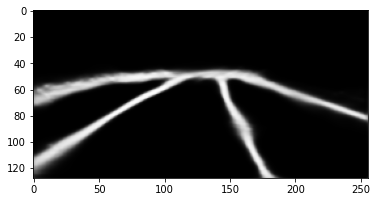

Train Epoch: 0 [9800/91660 (11%)]	Loss: 0.192041


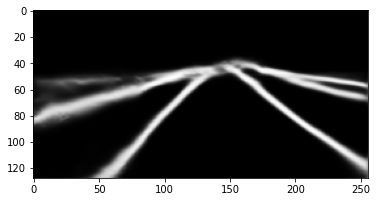

Train Epoch: 0 [9850/91660 (11%)]	Loss: 0.191296


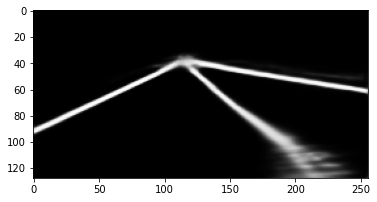

Train Epoch: 0 [9900/91660 (11%)]	Loss: 0.239768


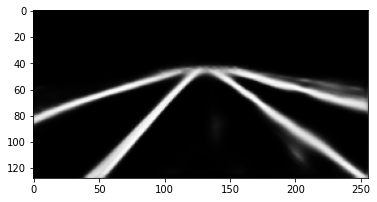

Train Epoch: 0 [9950/91660 (11%)]	Loss: 0.184453


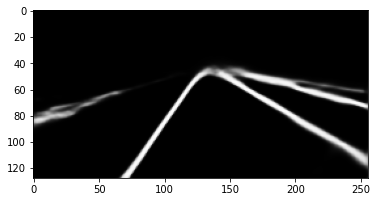

Train Epoch: 0 [10000/91660 (11%)]	Loss: 0.185633


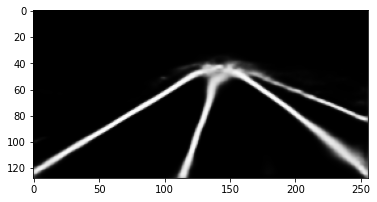

Train Epoch: 0 [10050/91660 (11%)]	Loss: 0.274167


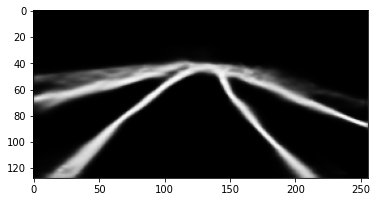

Train Epoch: 0 [10100/91660 (11%)]	Loss: 0.304699


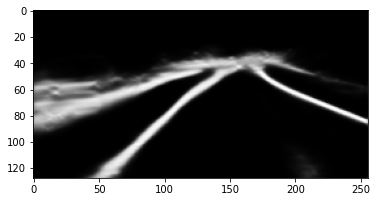

Train Epoch: 0 [10150/91660 (11%)]	Loss: 0.233803


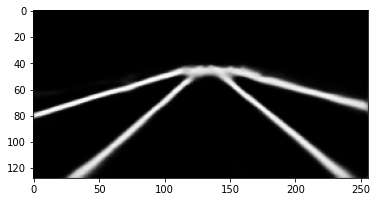

Train Epoch: 0 [10200/91660 (11%)]	Loss: 0.212922


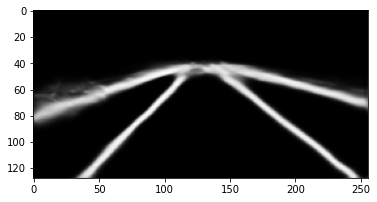

Train Epoch: 0 [10250/91660 (11%)]	Loss: 0.189137


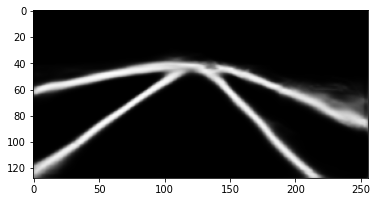

Train Epoch: 0 [10300/91660 (11%)]	Loss: 0.211085


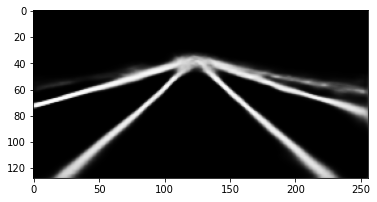

Train Epoch: 0 [10350/91660 (11%)]	Loss: 0.209629


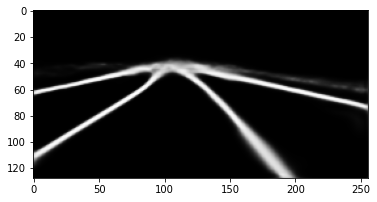

Train Epoch: 0 [10400/91660 (11%)]	Loss: 0.287550


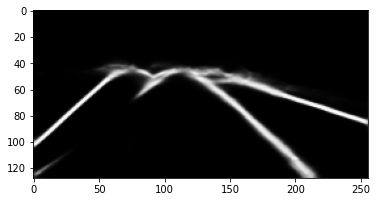

Train Epoch: 0 [10450/91660 (11%)]	Loss: 0.170065


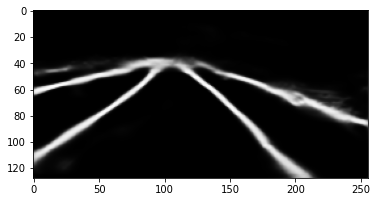

Train Epoch: 0 [10500/91660 (11%)]	Loss: 0.226178


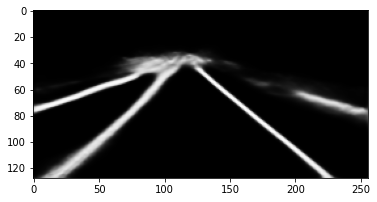

Train Epoch: 0 [10550/91660 (12%)]	Loss: 0.261631


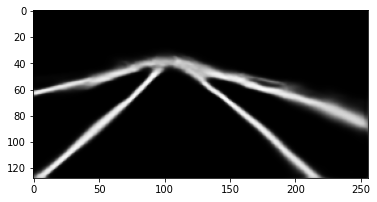

Train Epoch: 0 [10600/91660 (12%)]	Loss: 0.239007


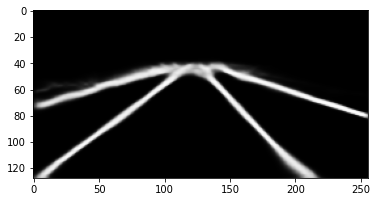

Train Epoch: 0 [10650/91660 (12%)]	Loss: 0.182481


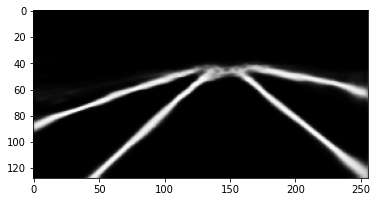

Train Epoch: 0 [10700/91660 (12%)]	Loss: 0.262874


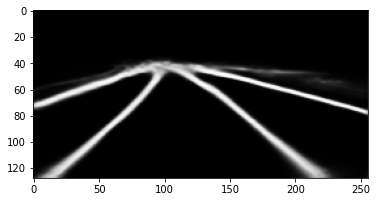

Train Epoch: 0 [10750/91660 (12%)]	Loss: 0.223056


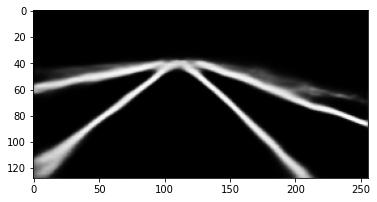

Train Epoch: 0 [10800/91660 (12%)]	Loss: 0.160850


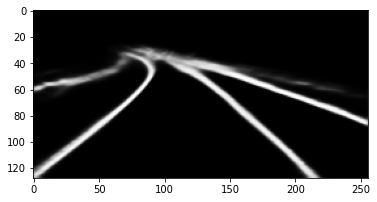

Train Epoch: 0 [10850/91660 (12%)]	Loss: 0.166646


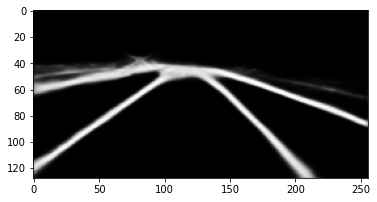

Train Epoch: 0 [10900/91660 (12%)]	Loss: 0.229302


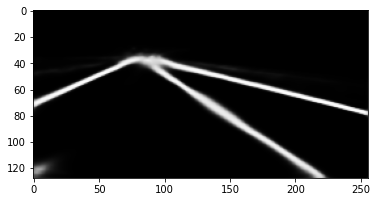

Train Epoch: 0 [10950/91660 (12%)]	Loss: 0.167616


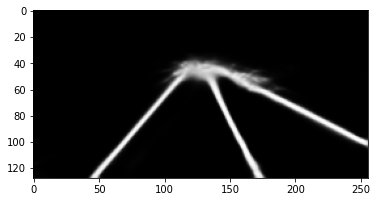

Train Epoch: 0 [11000/91660 (12%)]	Loss: 0.176702


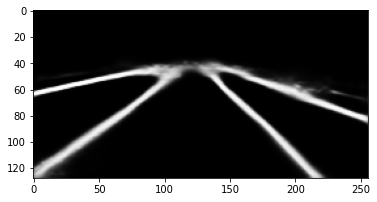

Train Epoch: 0 [11050/91660 (12%)]	Loss: 0.211191


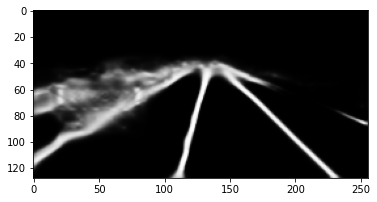

Train Epoch: 0 [11100/91660 (12%)]	Loss: 0.235016


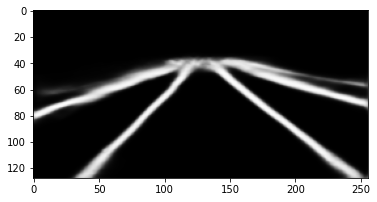

Train Epoch: 0 [11150/91660 (12%)]	Loss: 0.210572


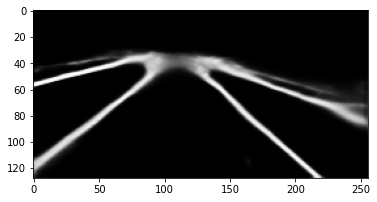

Train Epoch: 0 [11200/91660 (12%)]	Loss: 0.210992


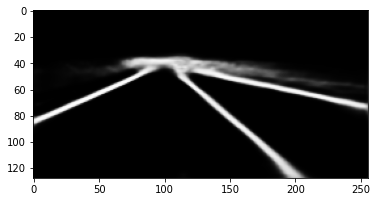

Train Epoch: 0 [11250/91660 (12%)]	Loss: 0.152904


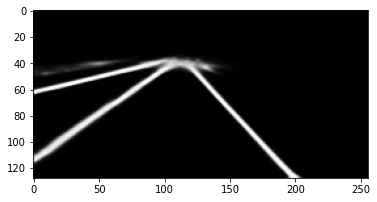

Train Epoch: 0 [11300/91660 (12%)]	Loss: 0.242688


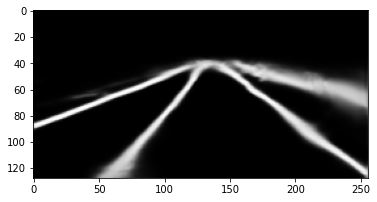

Train Epoch: 0 [11350/91660 (12%)]	Loss: 0.214171


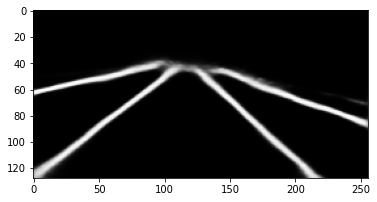

Train Epoch: 0 [11400/91660 (12%)]	Loss: 0.233335


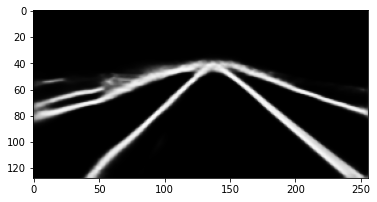

Train Epoch: 0 [11450/91660 (12%)]	Loss: 0.136917


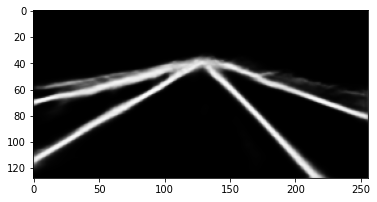

Train Epoch: 0 [11500/91660 (13%)]	Loss: 0.234784


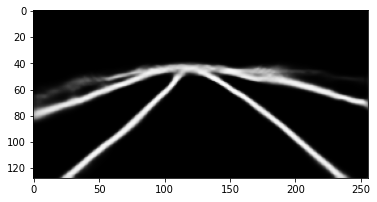

Train Epoch: 0 [11550/91660 (13%)]	Loss: 0.296246


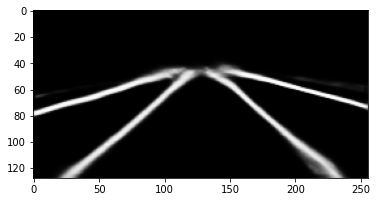

Train Epoch: 0 [11600/91660 (13%)]	Loss: 0.193463


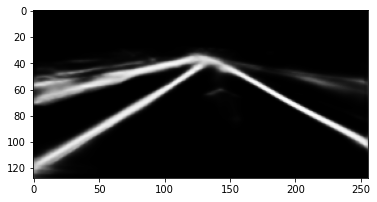

Train Epoch: 0 [11650/91660 (13%)]	Loss: 0.160930


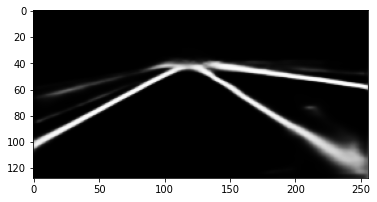

Train Epoch: 0 [11700/91660 (13%)]	Loss: 0.173218


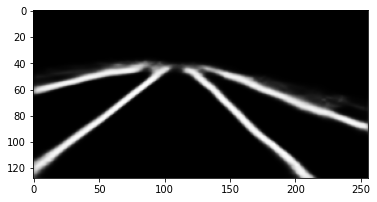

Train Epoch: 0 [11750/91660 (13%)]	Loss: 0.249632


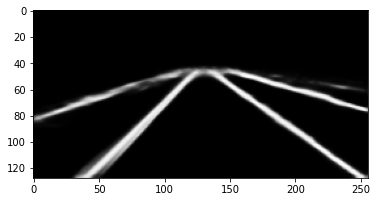

Train Epoch: 0 [11800/91660 (13%)]	Loss: 0.165762


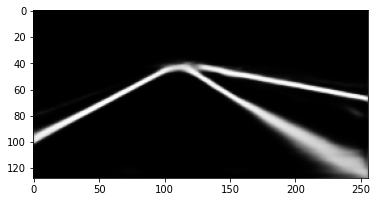

Train Epoch: 0 [11850/91660 (13%)]	Loss: 0.213000


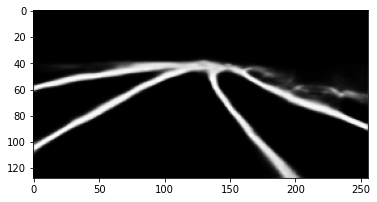

Train Epoch: 0 [11900/91660 (13%)]	Loss: 0.195949


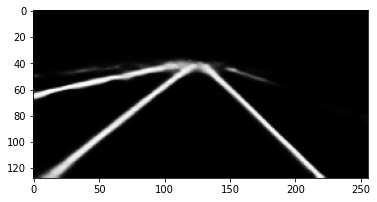

Train Epoch: 0 [11950/91660 (13%)]	Loss: 0.247615


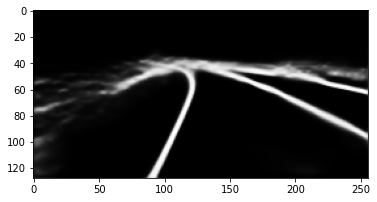

Train Epoch: 0 [12000/91660 (13%)]	Loss: 0.191325


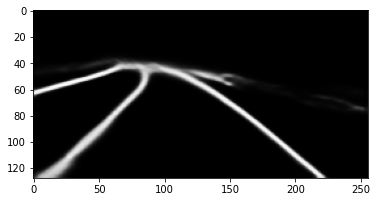

Train Epoch: 0 [12050/91660 (13%)]	Loss: 0.160481


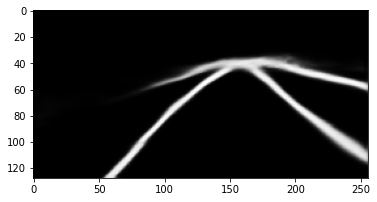

Train Epoch: 0 [12100/91660 (13%)]	Loss: 0.252457


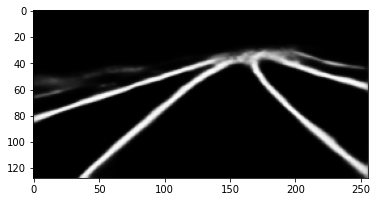

Train Epoch: 0 [12150/91660 (13%)]	Loss: 0.168764


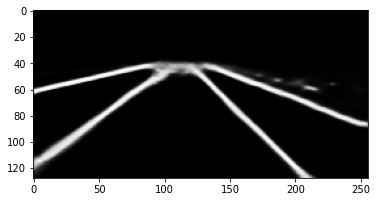

Train Epoch: 0 [12200/91660 (13%)]	Loss: 0.223316


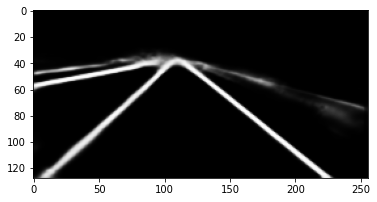

Train Epoch: 0 [12250/91660 (13%)]	Loss: 0.219481


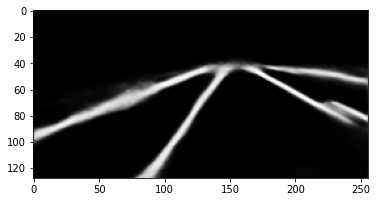

Train Epoch: 0 [12300/91660 (13%)]	Loss: 0.185069


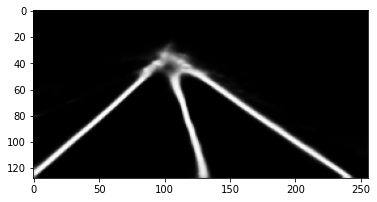

Train Epoch: 0 [12350/91660 (13%)]	Loss: 0.281845


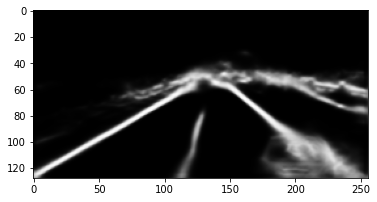

Train Epoch: 0 [12400/91660 (14%)]	Loss: 0.192618


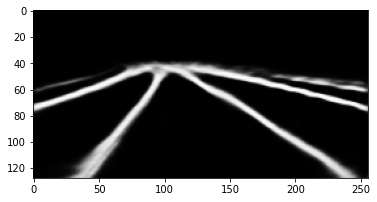

Train Epoch: 0 [12450/91660 (14%)]	Loss: 0.192840


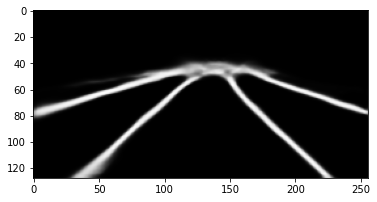

Train Epoch: 0 [12500/91660 (14%)]	Loss: 0.162559


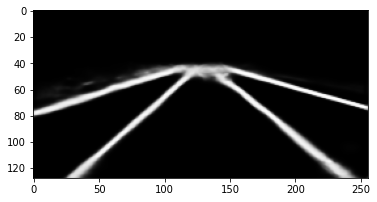

Train Epoch: 0 [12550/91660 (14%)]	Loss: 0.196182


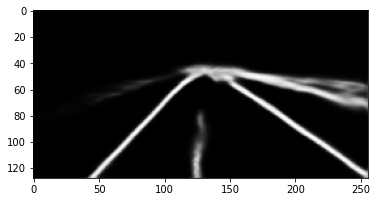

Train Epoch: 0 [12600/91660 (14%)]	Loss: 0.186742


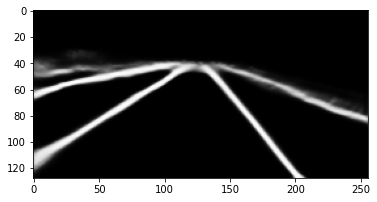

Train Epoch: 0 [12650/91660 (14%)]	Loss: 0.208906


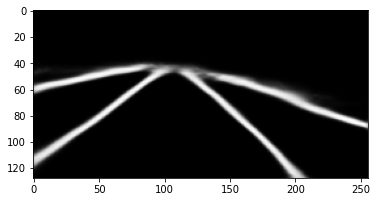

Train Epoch: 0 [12700/91660 (14%)]	Loss: 0.180049


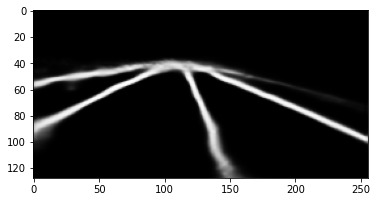

Train Epoch: 0 [12750/91660 (14%)]	Loss: 0.202948


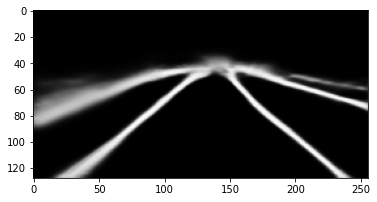

Train Epoch: 0 [12800/91660 (14%)]	Loss: 0.188082


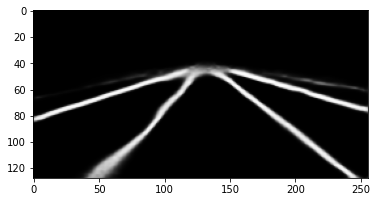

Train Epoch: 0 [12850/91660 (14%)]	Loss: 0.174734


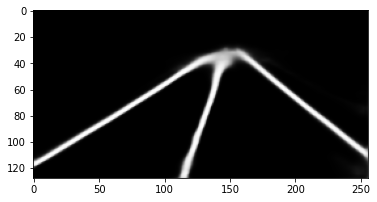

Train Epoch: 0 [12900/91660 (14%)]	Loss: 0.203267


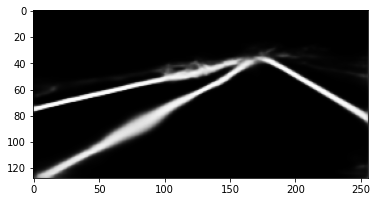

Train Epoch: 0 [12950/91660 (14%)]	Loss: 0.200069


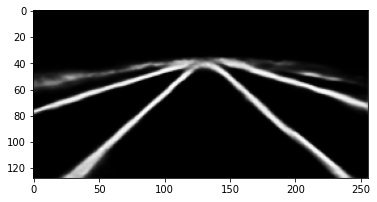

Train Epoch: 0 [13000/91660 (14%)]	Loss: 0.213661


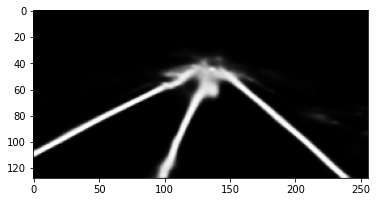

Train Epoch: 0 [13050/91660 (14%)]	Loss: 0.229203


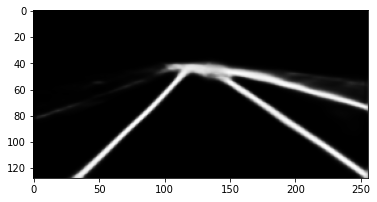

Train Epoch: 0 [13100/91660 (14%)]	Loss: 0.157665


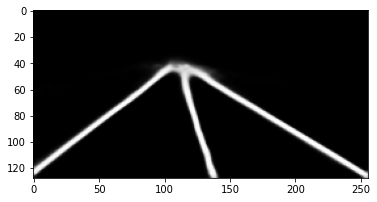

Train Epoch: 0 [13150/91660 (14%)]	Loss: 0.235449


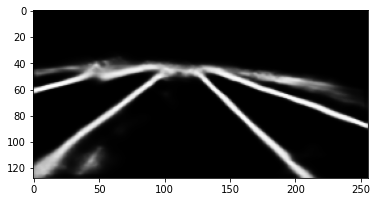

Train Epoch: 0 [13200/91660 (14%)]	Loss: 0.143461


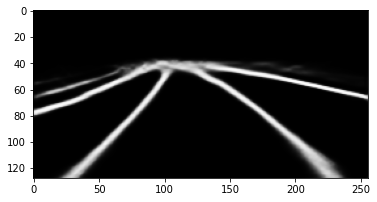

Train Epoch: 0 [13250/91660 (14%)]	Loss: 0.185206


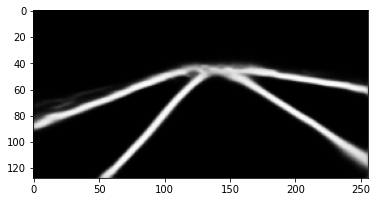

Train Epoch: 0 [13300/91660 (15%)]	Loss: 0.221753


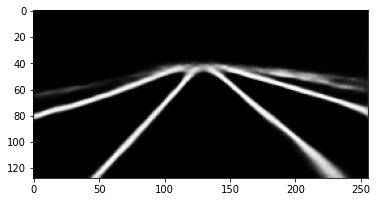

Train Epoch: 0 [13350/91660 (15%)]	Loss: 0.220715


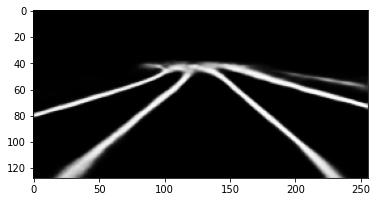

Train Epoch: 0 [13400/91660 (15%)]	Loss: 0.318048


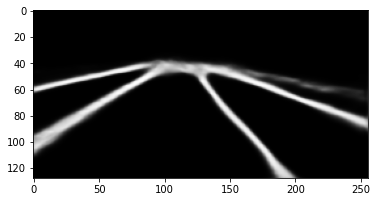

Train Epoch: 0 [13450/91660 (15%)]	Loss: 0.196594


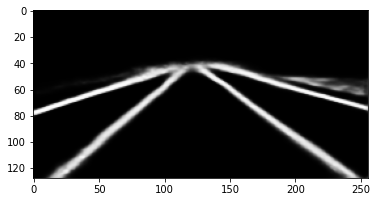

Train Epoch: 0 [13500/91660 (15%)]	Loss: 0.223744


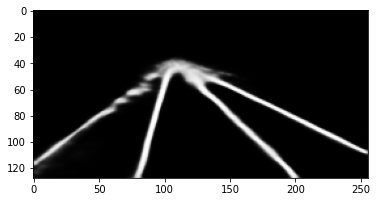

Train Epoch: 0 [13550/91660 (15%)]	Loss: 0.213519


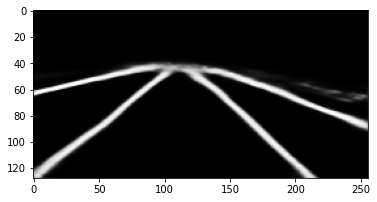

Train Epoch: 0 [13600/91660 (15%)]	Loss: 0.197052


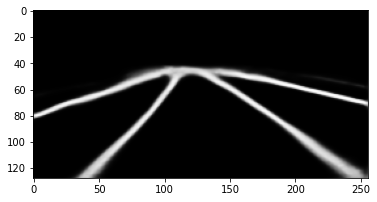

Train Epoch: 0 [13650/91660 (15%)]	Loss: 0.167355


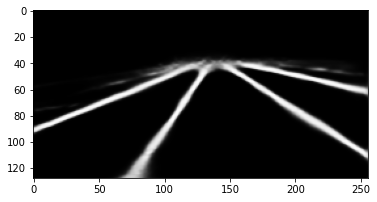

Train Epoch: 0 [13700/91660 (15%)]	Loss: 0.217105


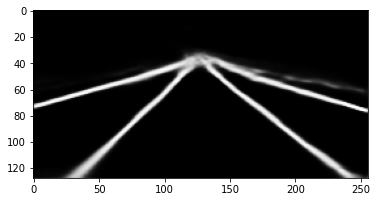

Train Epoch: 0 [13750/91660 (15%)]	Loss: 0.270909


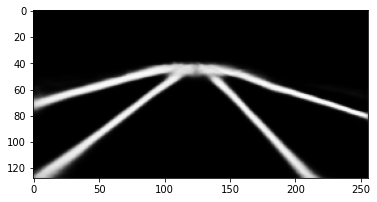

Train Epoch: 0 [13800/91660 (15%)]	Loss: 0.171353


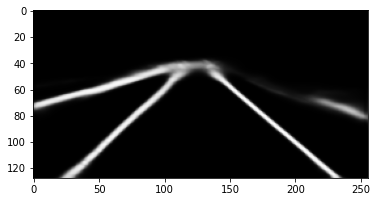

Train Epoch: 0 [13850/91660 (15%)]	Loss: 0.197453


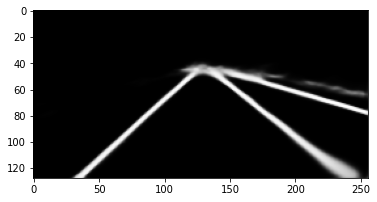

Train Epoch: 0 [13900/91660 (15%)]	Loss: 0.179355


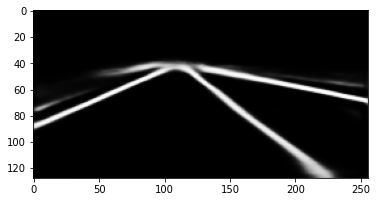

Train Epoch: 0 [13950/91660 (15%)]	Loss: 0.216311


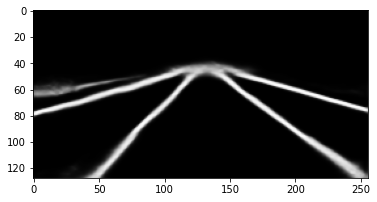

Train Epoch: 0 [14000/91660 (15%)]	Loss: 0.225264


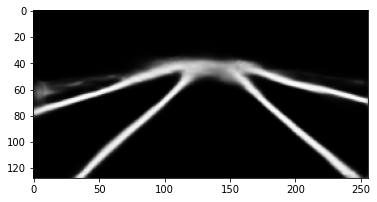

Train Epoch: 0 [14050/91660 (15%)]	Loss: 0.180776


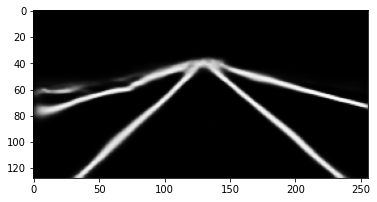

Train Epoch: 0 [14100/91660 (15%)]	Loss: 0.228013


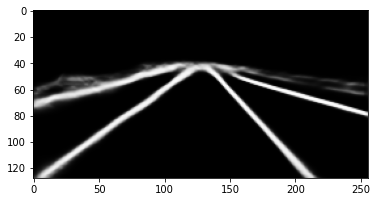

Train Epoch: 0 [14150/91660 (15%)]	Loss: 0.228887


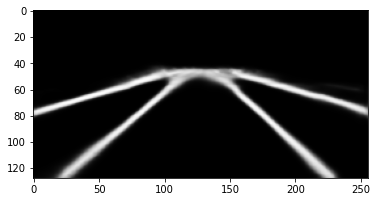

Train Epoch: 0 [14200/91660 (15%)]	Loss: 0.210844


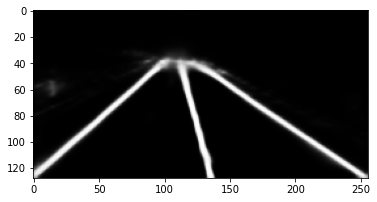

Train Epoch: 0 [14250/91660 (16%)]	Loss: 0.209956


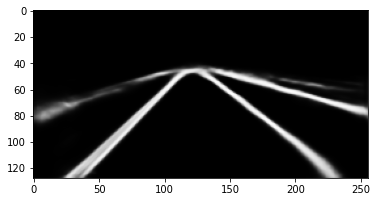

Train Epoch: 0 [14300/91660 (16%)]	Loss: 0.165443


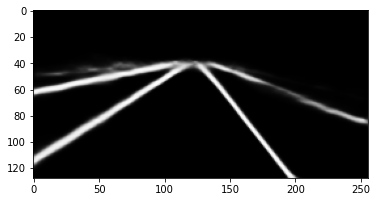

Train Epoch: 0 [14350/91660 (16%)]	Loss: 0.396633


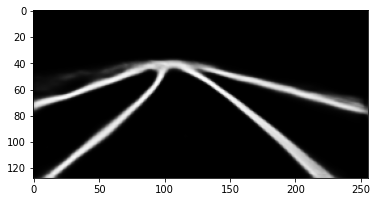

Train Epoch: 0 [14400/91660 (16%)]	Loss: 0.226207


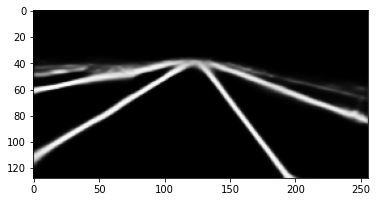

Train Epoch: 0 [14450/91660 (16%)]	Loss: 0.199055


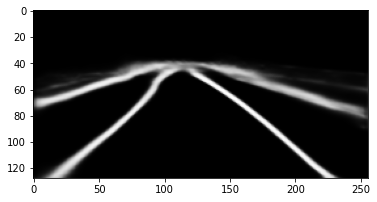

Train Epoch: 0 [14500/91660 (16%)]	Loss: 0.229918


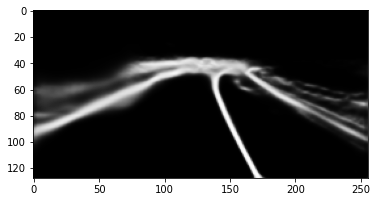

Train Epoch: 0 [14550/91660 (16%)]	Loss: 0.180752


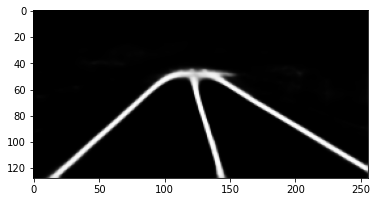

Train Epoch: 0 [14600/91660 (16%)]	Loss: 0.161483


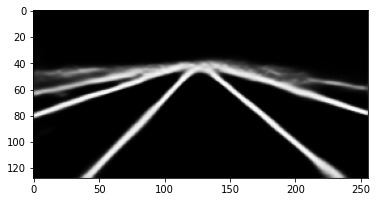

Train Epoch: 0 [14650/91660 (16%)]	Loss: 0.246780


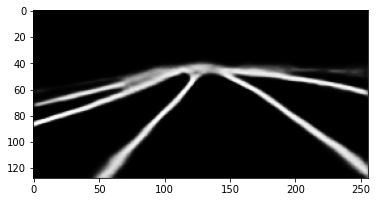

Train Epoch: 0 [14700/91660 (16%)]	Loss: 0.186941


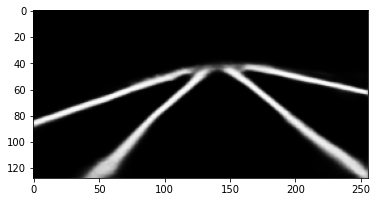

Train Epoch: 0 [14750/91660 (16%)]	Loss: 0.180036


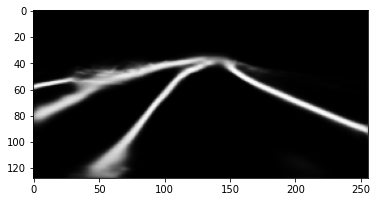

Train Epoch: 0 [14800/91660 (16%)]	Loss: 0.224688


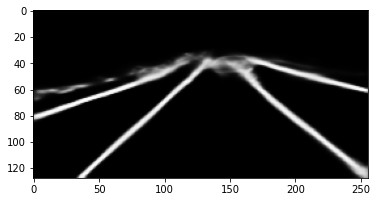

Train Epoch: 0 [14850/91660 (16%)]	Loss: 0.170920


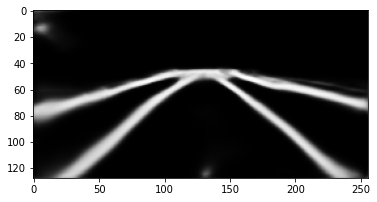

Train Epoch: 0 [14900/91660 (16%)]	Loss: 0.236792


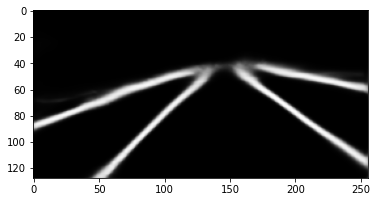

Train Epoch: 0 [14950/91660 (16%)]	Loss: 0.150687


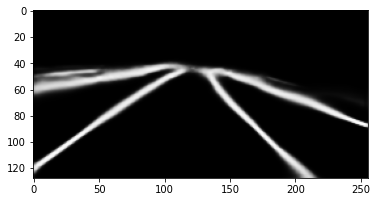

Train Epoch: 0 [15000/91660 (16%)]	Loss: 0.196381


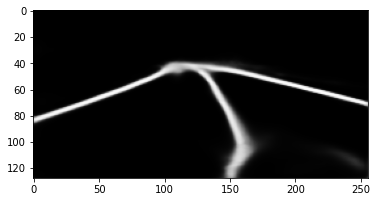

Train Epoch: 0 [15050/91660 (16%)]	Loss: 0.218878


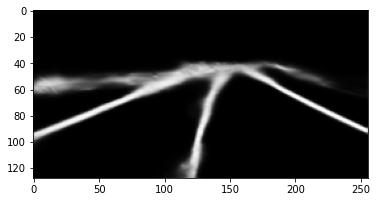

Train Epoch: 0 [15100/91660 (16%)]	Loss: 0.168920


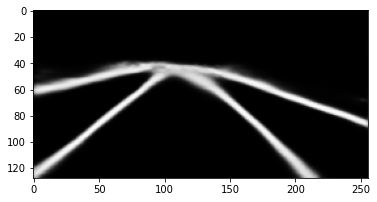

Train Epoch: 0 [15150/91660 (17%)]	Loss: 0.298682


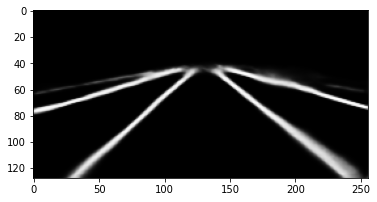

Train Epoch: 0 [15200/91660 (17%)]	Loss: 0.223712


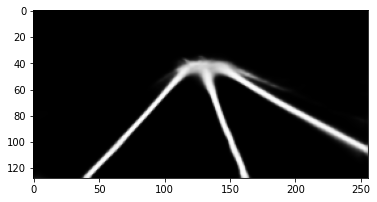

Train Epoch: 0 [15250/91660 (17%)]	Loss: 0.170679


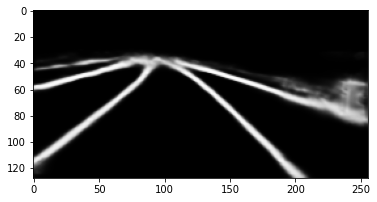

Train Epoch: 0 [15300/91660 (17%)]	Loss: 0.206282


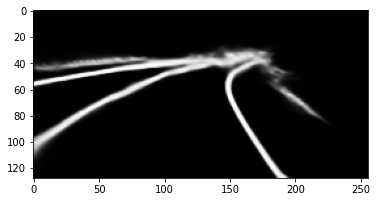

Train Epoch: 0 [15350/91660 (17%)]	Loss: 0.203514


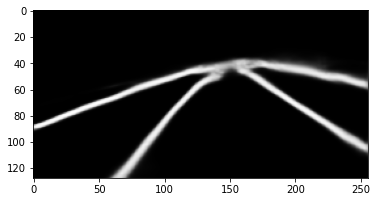

Train Epoch: 0 [15400/91660 (17%)]	Loss: 0.186993


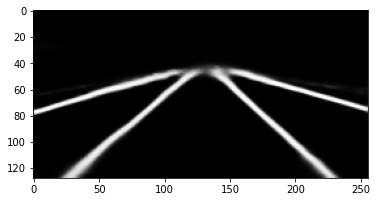

Train Epoch: 0 [15450/91660 (17%)]	Loss: 0.206842


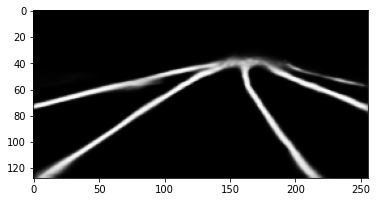

Train Epoch: 0 [15500/91660 (17%)]	Loss: 0.175321


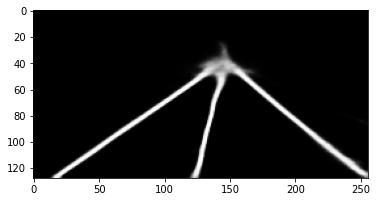

Train Epoch: 0 [15550/91660 (17%)]	Loss: 0.137786


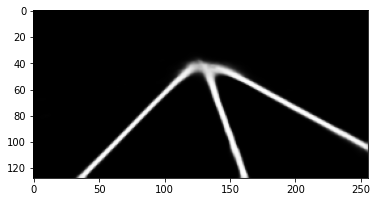

Train Epoch: 0 [15600/91660 (17%)]	Loss: 0.209110


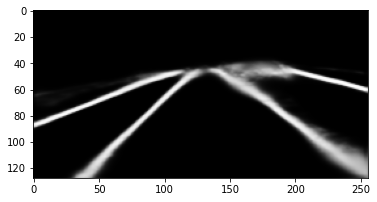

Train Epoch: 0 [15650/91660 (17%)]	Loss: 0.304488


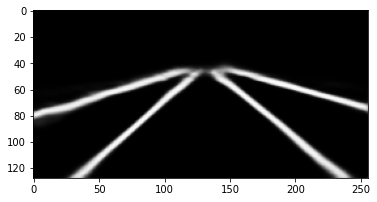

Train Epoch: 0 [15700/91660 (17%)]	Loss: 0.217340


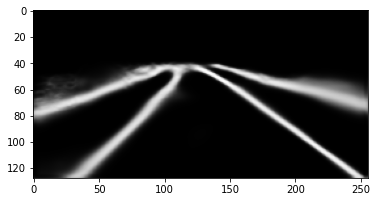

Train Epoch: 0 [15750/91660 (17%)]	Loss: 0.212762


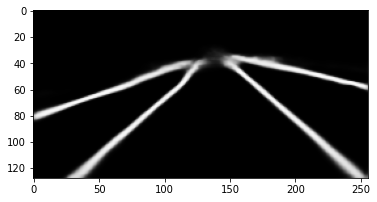

Train Epoch: 0 [15800/91660 (17%)]	Loss: 0.207910


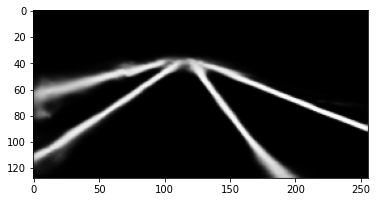

Train Epoch: 0 [15850/91660 (17%)]	Loss: 0.192705


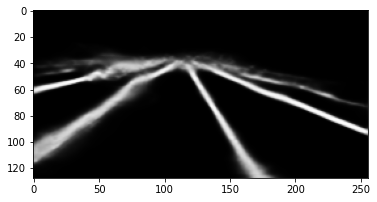

Train Epoch: 0 [15900/91660 (17%)]	Loss: 0.157930


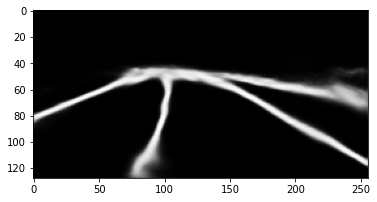

Train Epoch: 0 [15950/91660 (17%)]	Loss: 0.201818


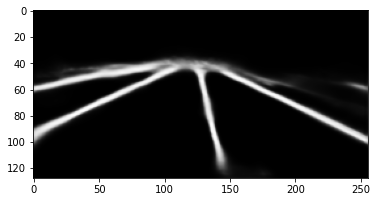

Train Epoch: 0 [16000/91660 (17%)]	Loss: 0.182678


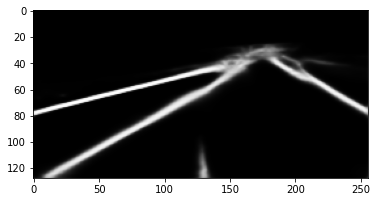

Train Epoch: 0 [16050/91660 (18%)]	Loss: 0.152711


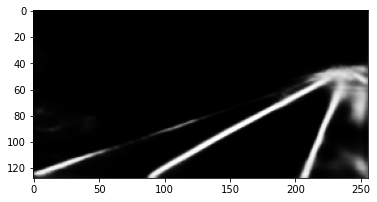

Train Epoch: 0 [16100/91660 (18%)]	Loss: 0.151271


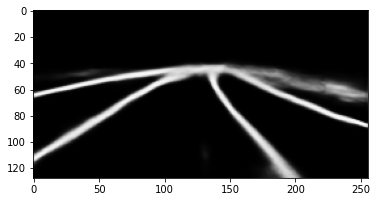

Train Epoch: 0 [16150/91660 (18%)]	Loss: 0.184782


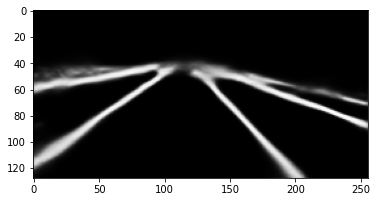

Train Epoch: 0 [16200/91660 (18%)]	Loss: 0.195141


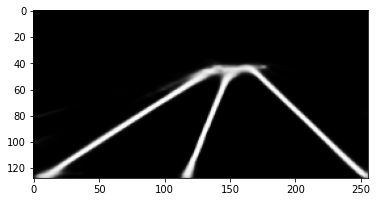

Train Epoch: 0 [16250/91660 (18%)]	Loss: 0.163527


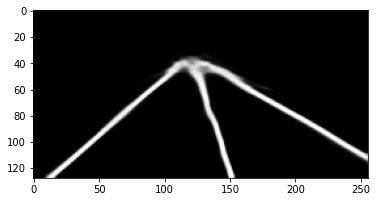

Train Epoch: 0 [16300/91660 (18%)]	Loss: 0.184168


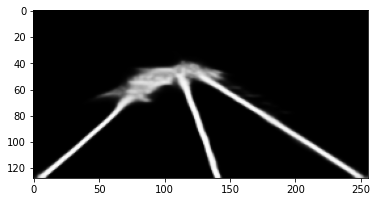

Train Epoch: 0 [16350/91660 (18%)]	Loss: 0.185721


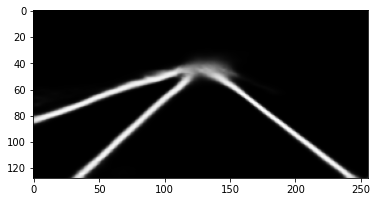

Train Epoch: 0 [16400/91660 (18%)]	Loss: 0.172790


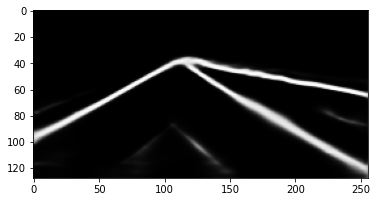

Train Epoch: 0 [16450/91660 (18%)]	Loss: 0.141997


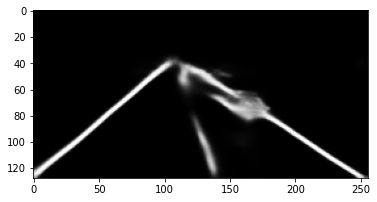

Train Epoch: 0 [16500/91660 (18%)]	Loss: 0.233738


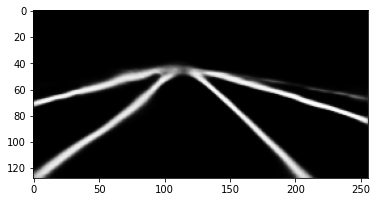

Train Epoch: 0 [16550/91660 (18%)]	Loss: 0.188004


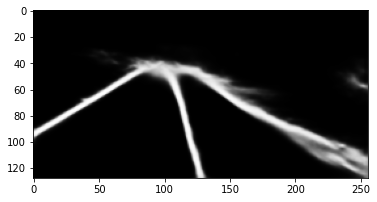

Train Epoch: 0 [16600/91660 (18%)]	Loss: 0.182815


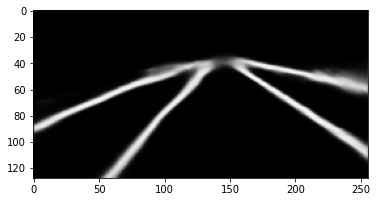

Train Epoch: 0 [16650/91660 (18%)]	Loss: 0.160187


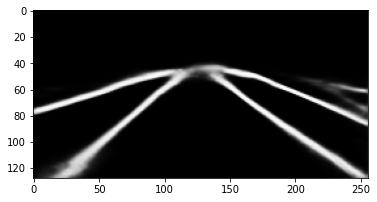

Train Epoch: 0 [16700/91660 (18%)]	Loss: 0.134540


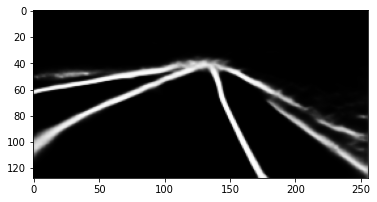

Train Epoch: 0 [16750/91660 (18%)]	Loss: 0.187429


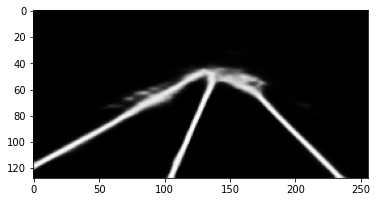

Train Epoch: 0 [16800/91660 (18%)]	Loss: 0.216274


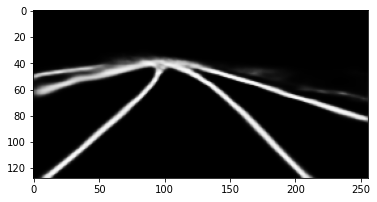

Train Epoch: 0 [16850/91660 (18%)]	Loss: 0.159196


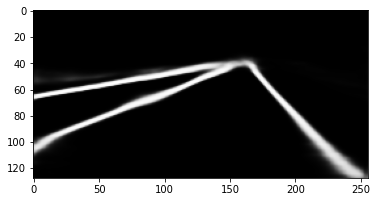

Train Epoch: 0 [16900/91660 (18%)]	Loss: 0.247020


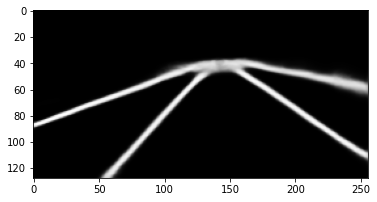

Train Epoch: 0 [16950/91660 (18%)]	Loss: 0.160034


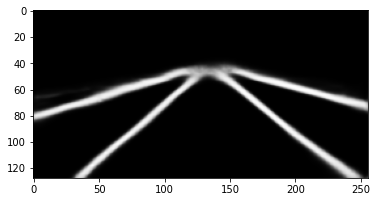

Train Epoch: 0 [17000/91660 (19%)]	Loss: 0.166091


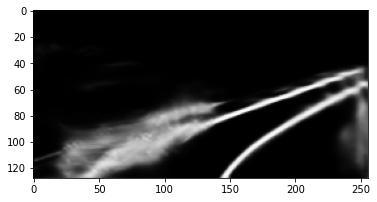

Train Epoch: 0 [17050/91660 (19%)]	Loss: 0.222514


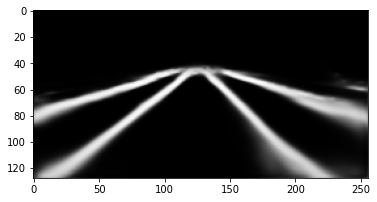

Train Epoch: 0 [17100/91660 (19%)]	Loss: 0.189592


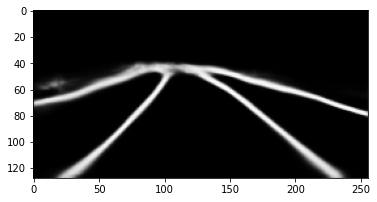

Train Epoch: 0 [17150/91660 (19%)]	Loss: 0.164864


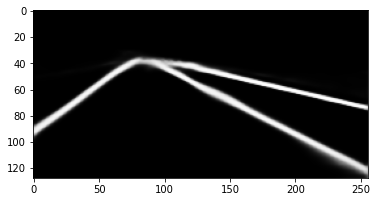

Train Epoch: 0 [17200/91660 (19%)]	Loss: 0.225217


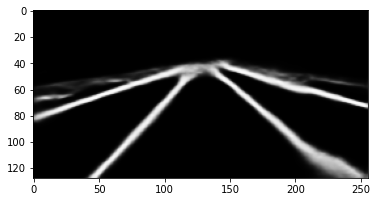

Train Epoch: 0 [17250/91660 (19%)]	Loss: 0.166382


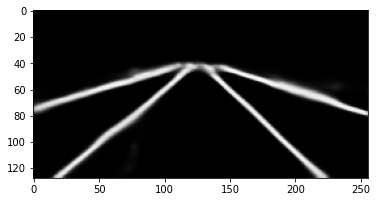

Train Epoch: 0 [17300/91660 (19%)]	Loss: 0.202827


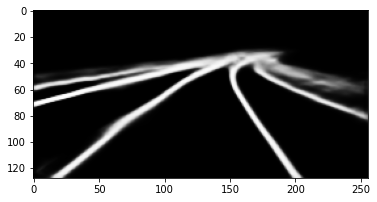

Train Epoch: 0 [17350/91660 (19%)]	Loss: 0.159862


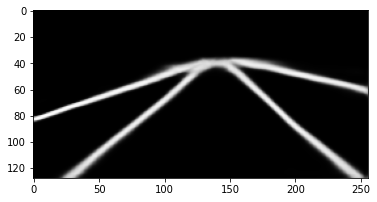

Train Epoch: 0 [17400/91660 (19%)]	Loss: 0.231126


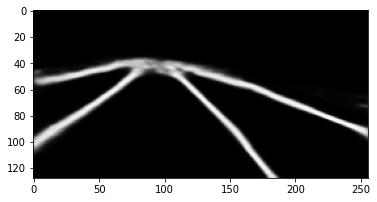

Train Epoch: 0 [17450/91660 (19%)]	Loss: 0.297826


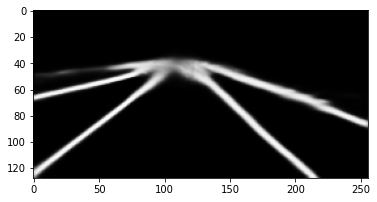

Train Epoch: 0 [17500/91660 (19%)]	Loss: 0.197337


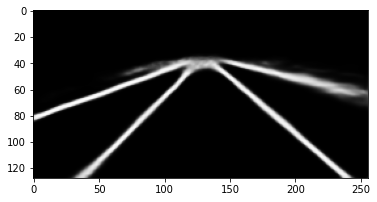

Train Epoch: 0 [17550/91660 (19%)]	Loss: 0.181593


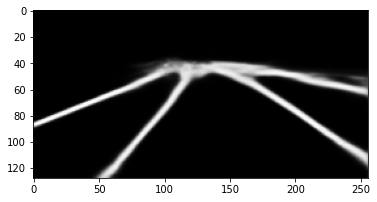

Train Epoch: 0 [17600/91660 (19%)]	Loss: 0.192904


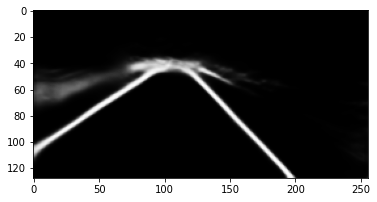

Train Epoch: 0 [17650/91660 (19%)]	Loss: 0.154762


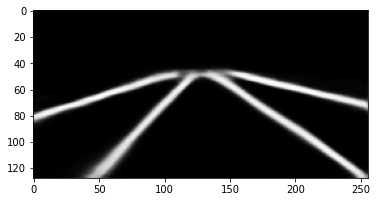

Train Epoch: 0 [17700/91660 (19%)]	Loss: 0.181027


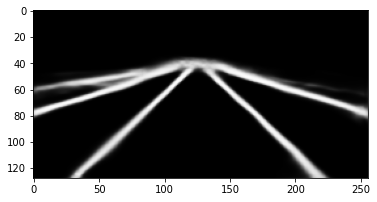

Train Epoch: 0 [17750/91660 (19%)]	Loss: 0.216742


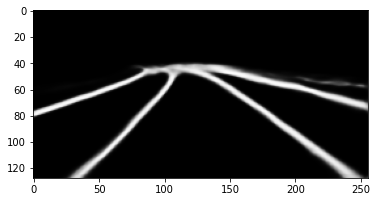

Train Epoch: 0 [17800/91660 (19%)]	Loss: 0.186637


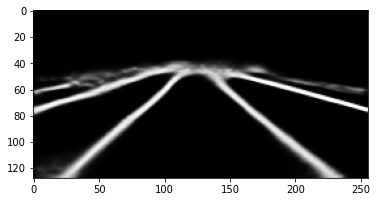

Train Epoch: 0 [17850/91660 (19%)]	Loss: 0.166315


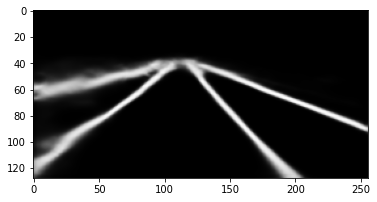

Train Epoch: 0 [17900/91660 (20%)]	Loss: 0.243962


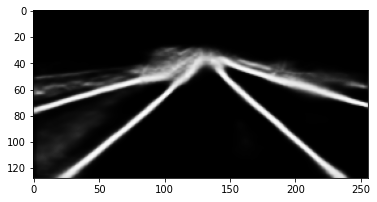

Train Epoch: 0 [17950/91660 (20%)]	Loss: 0.198130


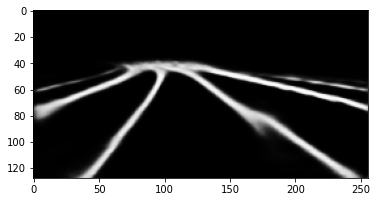

Train Epoch: 0 [18000/91660 (20%)]	Loss: 0.219033


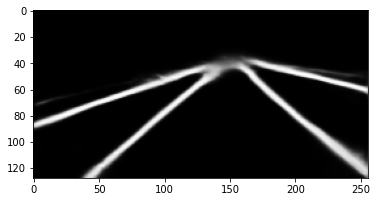

Train Epoch: 0 [18050/91660 (20%)]	Loss: 0.197715


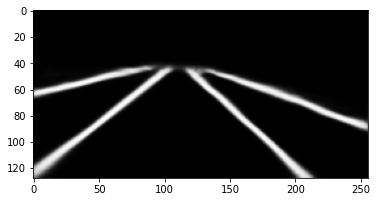

Train Epoch: 0 [18100/91660 (20%)]	Loss: 0.204703


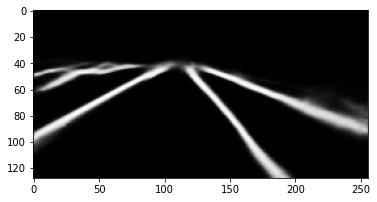

Train Epoch: 0 [18150/91660 (20%)]	Loss: 0.148598


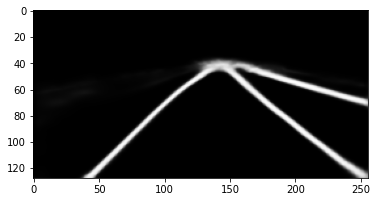

Train Epoch: 0 [18200/91660 (20%)]	Loss: 0.204139


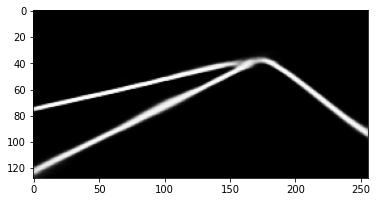

Train Epoch: 0 [18250/91660 (20%)]	Loss: 0.190186


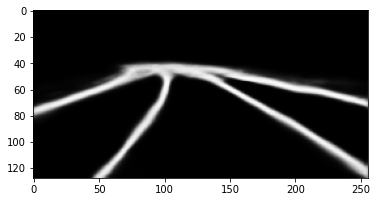

Train Epoch: 0 [18300/91660 (20%)]	Loss: 0.201680


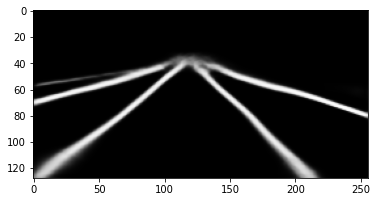

Train Epoch: 0 [18350/91660 (20%)]	Loss: 0.212637


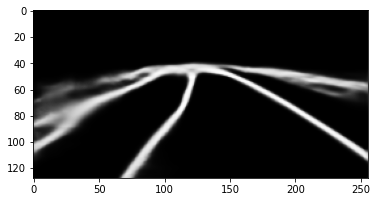

Train Epoch: 0 [18400/91660 (20%)]	Loss: 0.195376


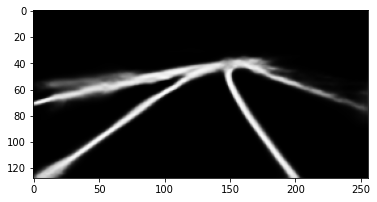

Train Epoch: 0 [18450/91660 (20%)]	Loss: 0.222896


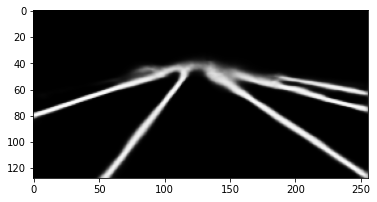

Train Epoch: 0 [18500/91660 (20%)]	Loss: 0.148715


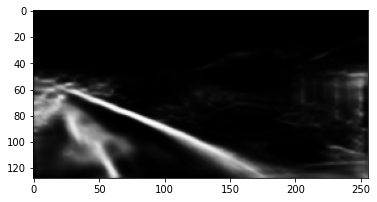

Train Epoch: 0 [18550/91660 (20%)]	Loss: 0.140806


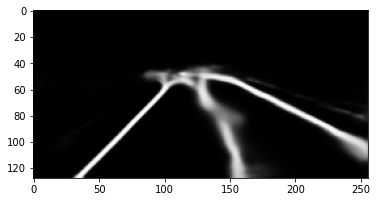

Train Epoch: 0 [18600/91660 (20%)]	Loss: 0.150594


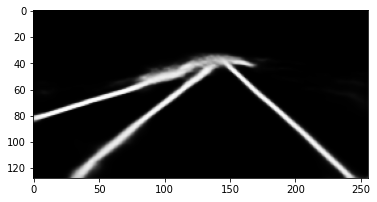

Train Epoch: 0 [18650/91660 (20%)]	Loss: 0.164891


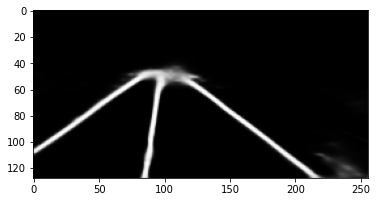

Train Epoch: 0 [18700/91660 (20%)]	Loss: 0.189658


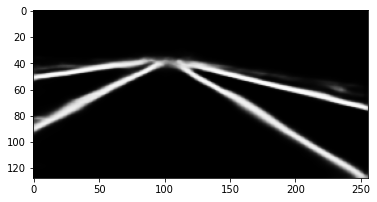

Train Epoch: 0 [18750/91660 (20%)]	Loss: 0.199436


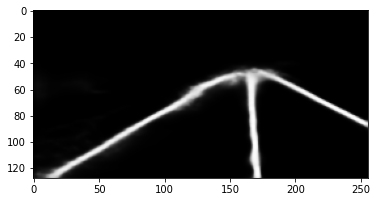

Train Epoch: 0 [18800/91660 (21%)]	Loss: 0.162816


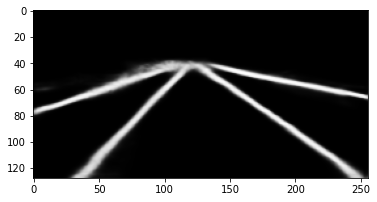

Train Epoch: 0 [18850/91660 (21%)]	Loss: 0.191918


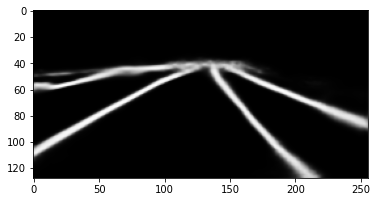

Train Epoch: 0 [18900/91660 (21%)]	Loss: 0.230373


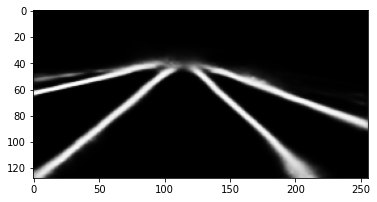

Train Epoch: 0 [18950/91660 (21%)]	Loss: 0.214933


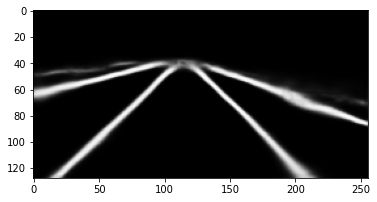

Train Epoch: 0 [19000/91660 (21%)]	Loss: 0.159316


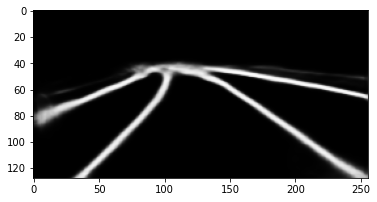

Train Epoch: 0 [19050/91660 (21%)]	Loss: 0.157720


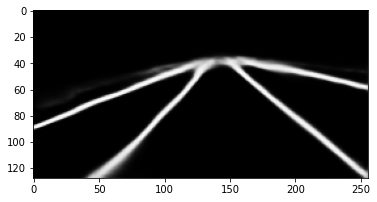

Train Epoch: 0 [19100/91660 (21%)]	Loss: 0.188927


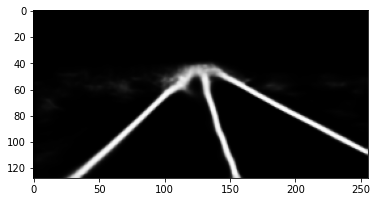

Train Epoch: 0 [19150/91660 (21%)]	Loss: 0.162968


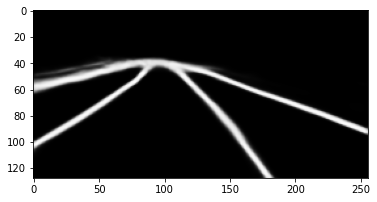

Train Epoch: 0 [19200/91660 (21%)]	Loss: 0.204919


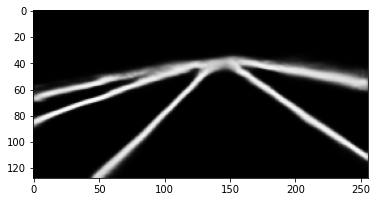

Train Epoch: 0 [19250/91660 (21%)]	Loss: 0.188889


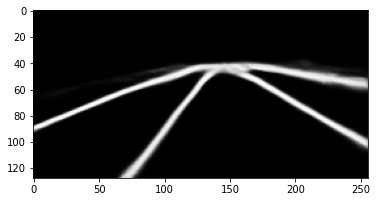

Train Epoch: 0 [19300/91660 (21%)]	Loss: 0.175520


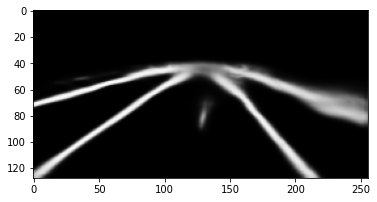

Train Epoch: 0 [19350/91660 (21%)]	Loss: 0.192807


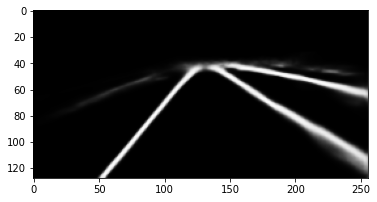

Train Epoch: 0 [19400/91660 (21%)]	Loss: 0.150069


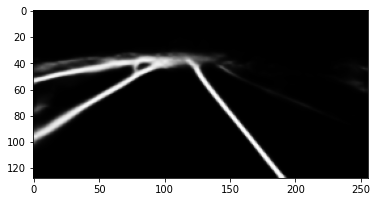

Train Epoch: 0 [19450/91660 (21%)]	Loss: 0.134055


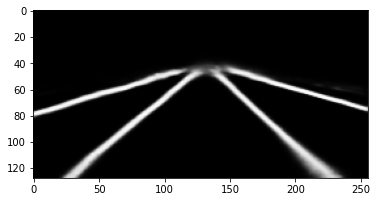

Train Epoch: 0 [19500/91660 (21%)]	Loss: 0.169959


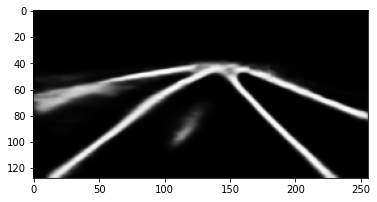

Train Epoch: 0 [19550/91660 (21%)]	Loss: 0.201915


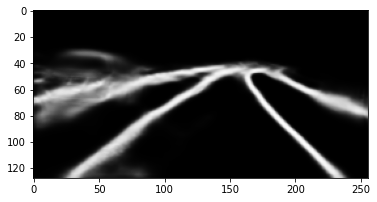

Train Epoch: 0 [19600/91660 (21%)]	Loss: 0.184708


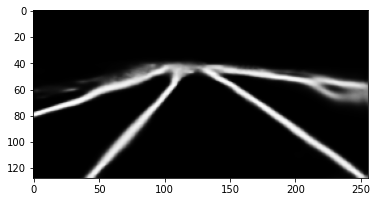

Train Epoch: 0 [19650/91660 (21%)]	Loss: 0.219597


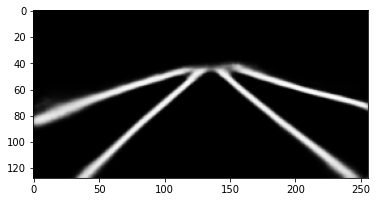

Train Epoch: 0 [19700/91660 (21%)]	Loss: 0.164674


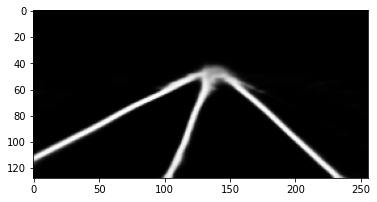

Train Epoch: 0 [19750/91660 (22%)]	Loss: 0.173259


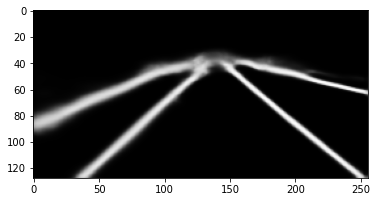

Train Epoch: 0 [19800/91660 (22%)]	Loss: 0.197642


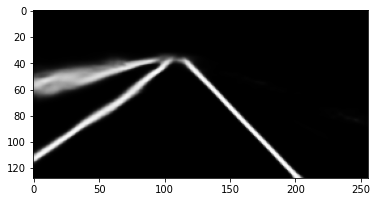

Train Epoch: 0 [19850/91660 (22%)]	Loss: 0.194776


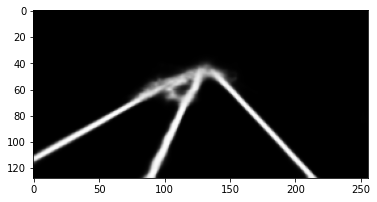

Train Epoch: 0 [19900/91660 (22%)]	Loss: 0.227671


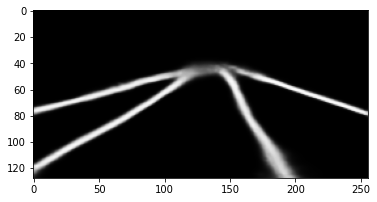

Train Epoch: 0 [19950/91660 (22%)]	Loss: 0.173240


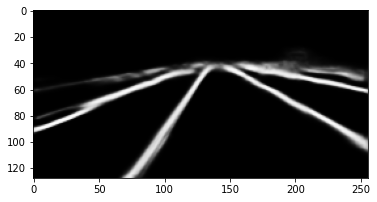

Train Epoch: 0 [20000/91660 (22%)]	Loss: 0.220225


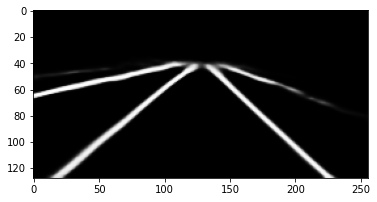

Train Epoch: 0 [20050/91660 (22%)]	Loss: 0.201693


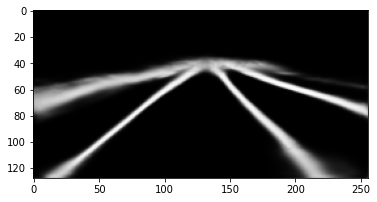

Train Epoch: 0 [20100/91660 (22%)]	Loss: 0.241857


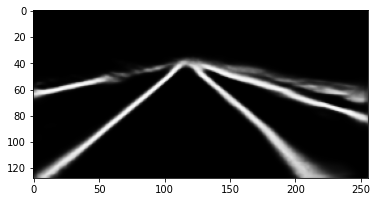

Train Epoch: 0 [20150/91660 (22%)]	Loss: 0.206440


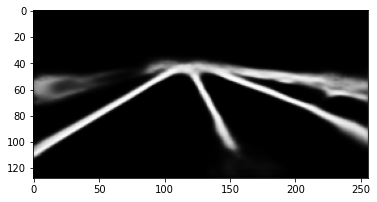

Train Epoch: 0 [20200/91660 (22%)]	Loss: 0.164617


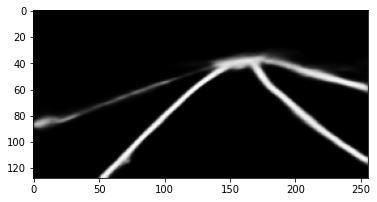

Train Epoch: 0 [20250/91660 (22%)]	Loss: 0.205719


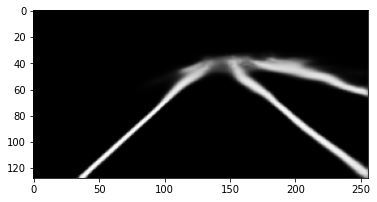

Train Epoch: 0 [20300/91660 (22%)]	Loss: 0.138257


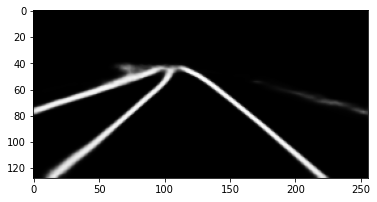

Train Epoch: 0 [20350/91660 (22%)]	Loss: 0.155003


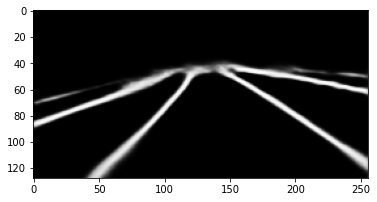

Train Epoch: 0 [20400/91660 (22%)]	Loss: 0.152912


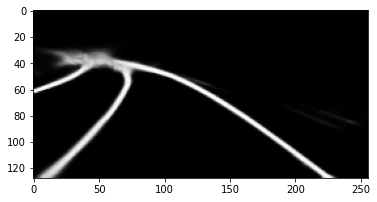

Train Epoch: 0 [20450/91660 (22%)]	Loss: 0.205793


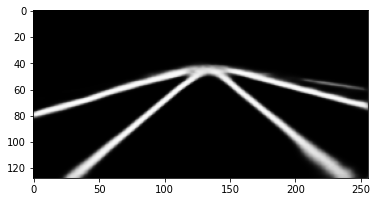

Train Epoch: 0 [20500/91660 (22%)]	Loss: 0.203040


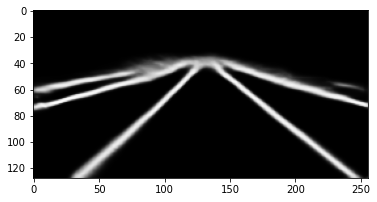

Train Epoch: 0 [20550/91660 (22%)]	Loss: 0.193717


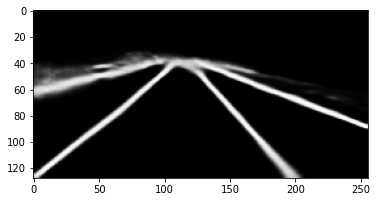

Train Epoch: 0 [20600/91660 (22%)]	Loss: 0.141922


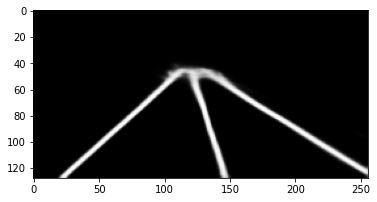

Train Epoch: 0 [20650/91660 (23%)]	Loss: 0.153349


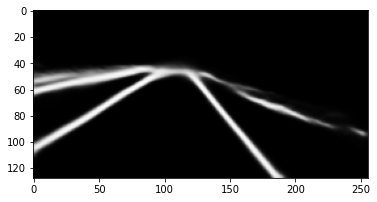

Train Epoch: 0 [20700/91660 (23%)]	Loss: 0.157609


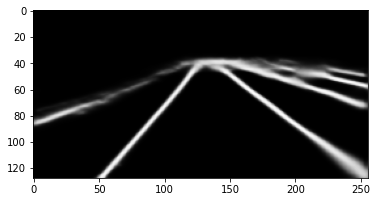

Train Epoch: 0 [20750/91660 (23%)]	Loss: 0.241600


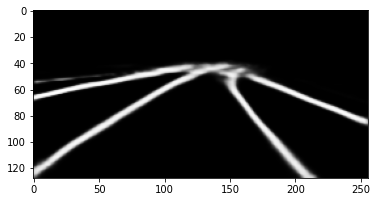

Train Epoch: 0 [20800/91660 (23%)]	Loss: 0.183957


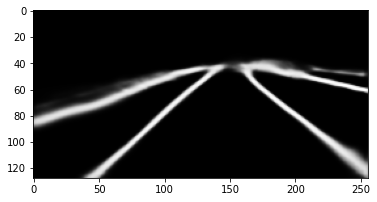

Train Epoch: 0 [20850/91660 (23%)]	Loss: 0.194658


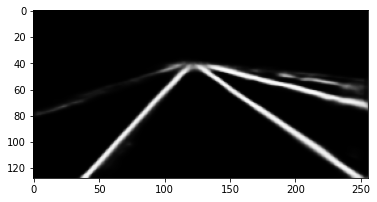

Train Epoch: 0 [20900/91660 (23%)]	Loss: 0.209871


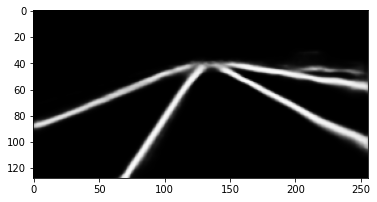

Train Epoch: 0 [20950/91660 (23%)]	Loss: 0.155558


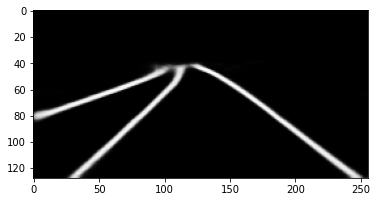

Train Epoch: 0 [21000/91660 (23%)]	Loss: 0.196001


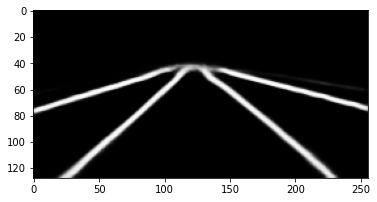

Train Epoch: 0 [21050/91660 (23%)]	Loss: 0.161937


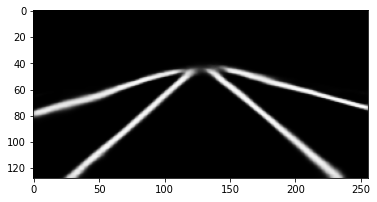

Train Epoch: 0 [21100/91660 (23%)]	Loss: 0.150055


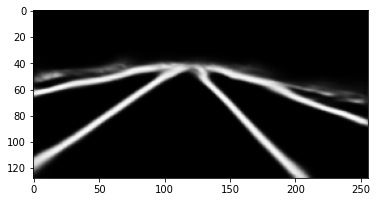

Train Epoch: 0 [21150/91660 (23%)]	Loss: 0.245566


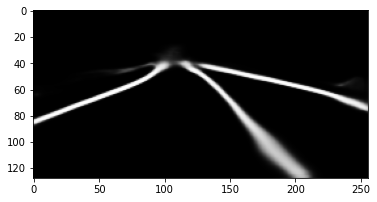

Train Epoch: 0 [21200/91660 (23%)]	Loss: 0.229370


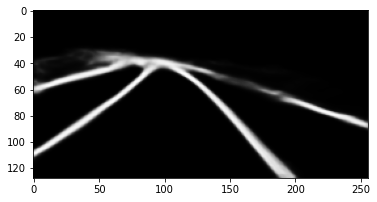

Train Epoch: 0 [21250/91660 (23%)]	Loss: 0.154373


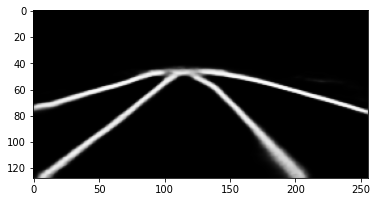

Train Epoch: 0 [21300/91660 (23%)]	Loss: 0.247465


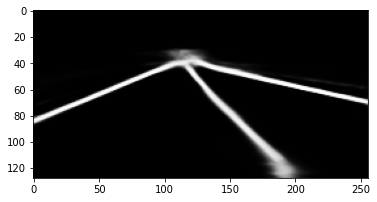

Train Epoch: 0 [21350/91660 (23%)]	Loss: 0.187339


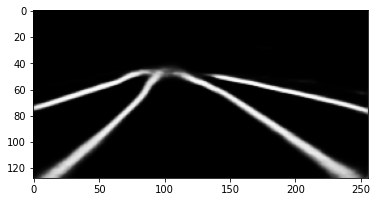

Train Epoch: 0 [21400/91660 (23%)]	Loss: 0.138617


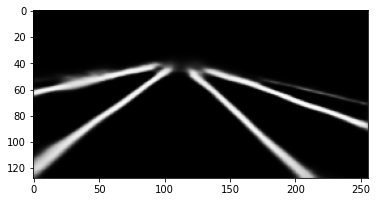

Train Epoch: 0 [21450/91660 (23%)]	Loss: 0.206235


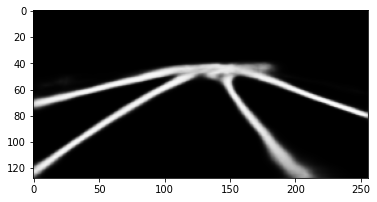

Train Epoch: 0 [21500/91660 (23%)]	Loss: 0.192046


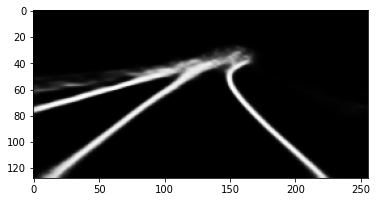

Train Epoch: 0 [21550/91660 (24%)]	Loss: 0.242154


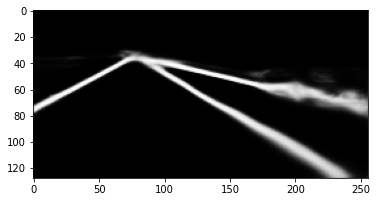

Train Epoch: 0 [21600/91660 (24%)]	Loss: 0.177218


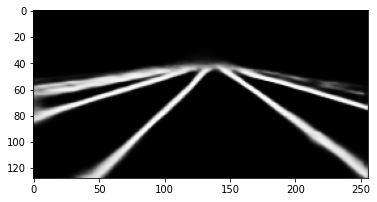

Train Epoch: 0 [21650/91660 (24%)]	Loss: 0.318590


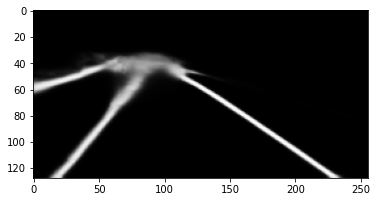

Train Epoch: 0 [21700/91660 (24%)]	Loss: 0.216950


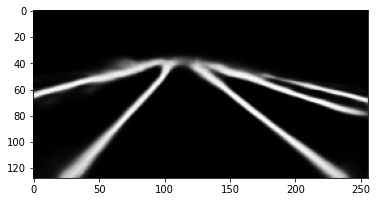

Train Epoch: 0 [21750/91660 (24%)]	Loss: 0.205855


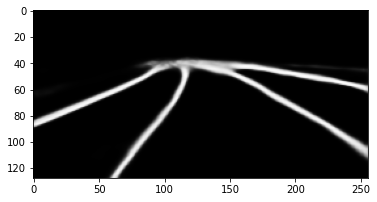

Train Epoch: 0 [21800/91660 (24%)]	Loss: 0.168640


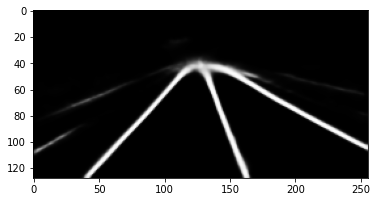

Train Epoch: 0 [21850/91660 (24%)]	Loss: 0.143517


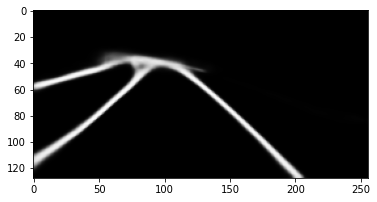

Train Epoch: 0 [21900/91660 (24%)]	Loss: 0.178958


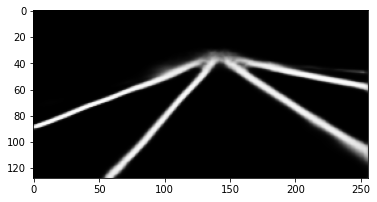

Train Epoch: 0 [21950/91660 (24%)]	Loss: 0.164635


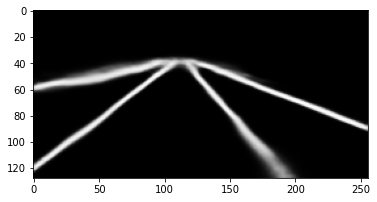

Train Epoch: 0 [22000/91660 (24%)]	Loss: 0.184363


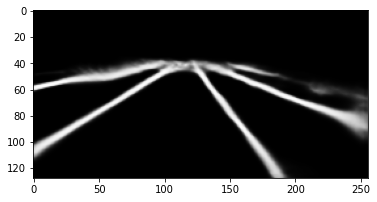

Train Epoch: 0 [22050/91660 (24%)]	Loss: 0.222217


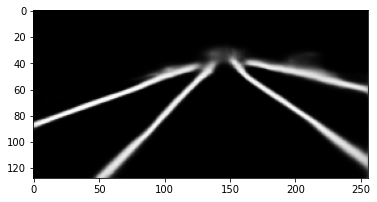

Train Epoch: 0 [22100/91660 (24%)]	Loss: 0.187638


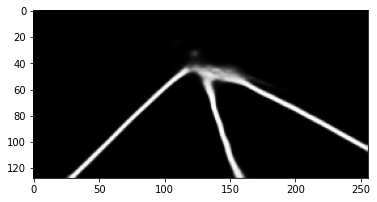

Train Epoch: 0 [22150/91660 (24%)]	Loss: 0.137410


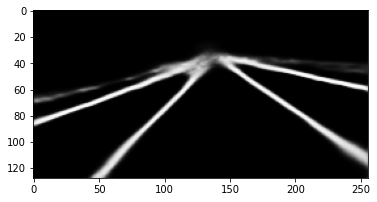

Train Epoch: 0 [22200/91660 (24%)]	Loss: 0.231636


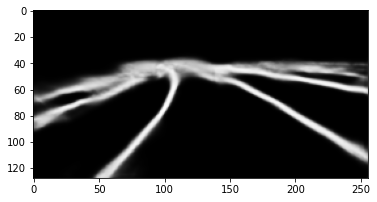

Train Epoch: 0 [22250/91660 (24%)]	Loss: 0.190234


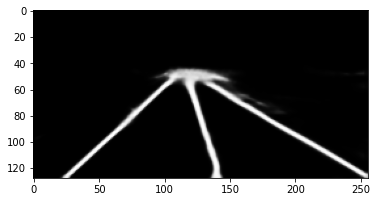

Train Epoch: 0 [22300/91660 (24%)]	Loss: 0.173147


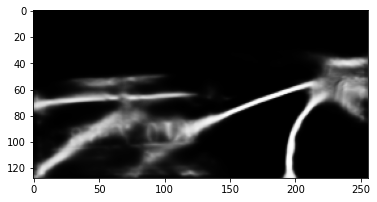

Train Epoch: 0 [22350/91660 (24%)]	Loss: 0.217225


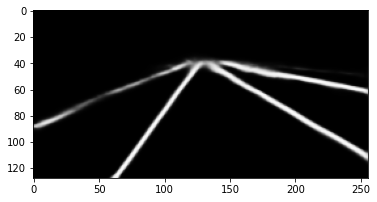

Train Epoch: 0 [22400/91660 (24%)]	Loss: 0.200729


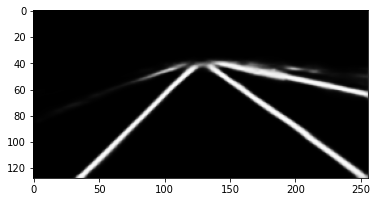

Train Epoch: 0 [22450/91660 (24%)]	Loss: 0.160633


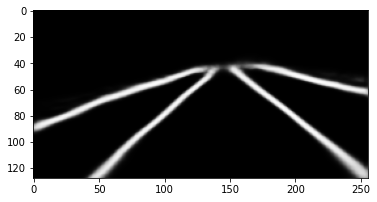

Train Epoch: 0 [22500/91660 (25%)]	Loss: 0.152537


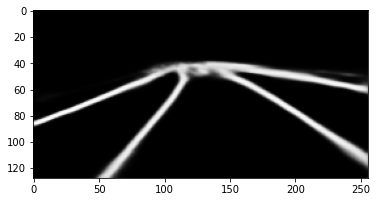

Train Epoch: 0 [22550/91660 (25%)]	Loss: 0.173138


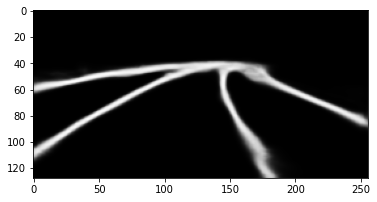

Train Epoch: 0 [22600/91660 (25%)]	Loss: 0.210112


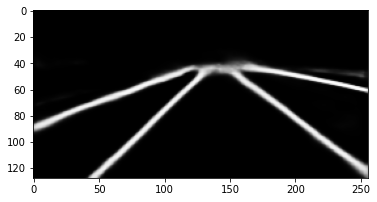

Train Epoch: 0 [22650/91660 (25%)]	Loss: 0.255771


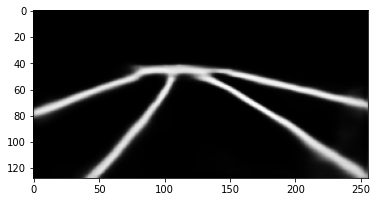

Train Epoch: 0 [22700/91660 (25%)]	Loss: 0.141369


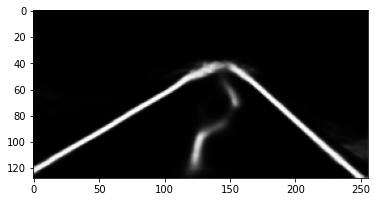

Train Epoch: 0 [22750/91660 (25%)]	Loss: 0.241385


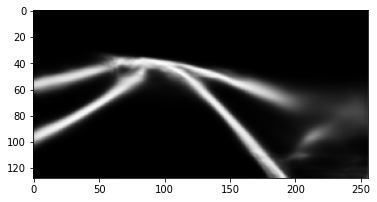

Train Epoch: 0 [22800/91660 (25%)]	Loss: 0.153753


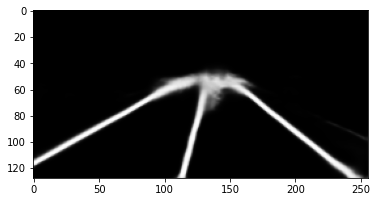

Train Epoch: 0 [22850/91660 (25%)]	Loss: 0.154893


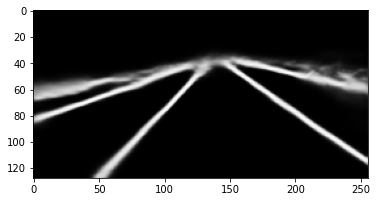

Train Epoch: 0 [22900/91660 (25%)]	Loss: 0.173203


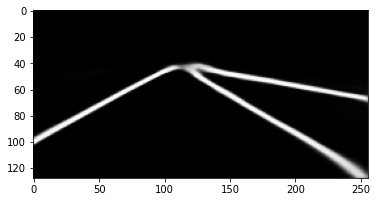

Train Epoch: 0 [22950/91660 (25%)]	Loss: 0.223733


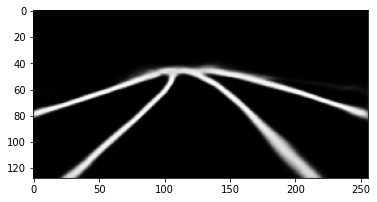

Train Epoch: 0 [23000/91660 (25%)]	Loss: 0.226379


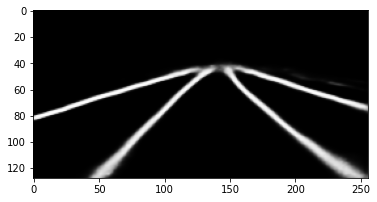

Train Epoch: 0 [23050/91660 (25%)]	Loss: 0.180845


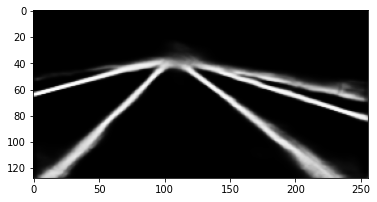

Train Epoch: 0 [23100/91660 (25%)]	Loss: 0.174720


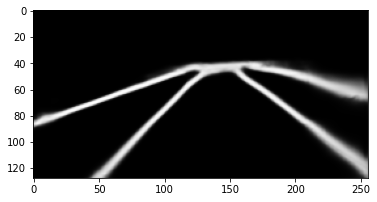

Train Epoch: 0 [23150/91660 (25%)]	Loss: 0.122446


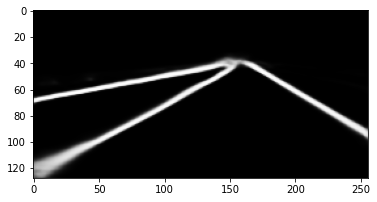

Train Epoch: 0 [23200/91660 (25%)]	Loss: 0.203064


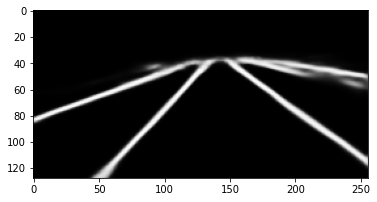

Train Epoch: 0 [23250/91660 (25%)]	Loss: 0.161439


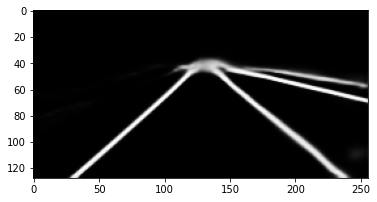

Train Epoch: 0 [23300/91660 (25%)]	Loss: 0.169703


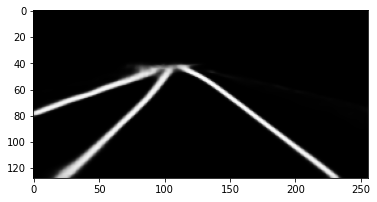

Train Epoch: 0 [23350/91660 (25%)]	Loss: 0.253620


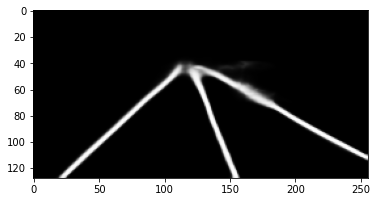

Train Epoch: 0 [23400/91660 (26%)]	Loss: 0.180189


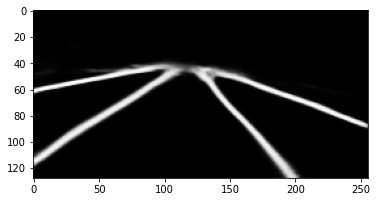

Train Epoch: 0 [23450/91660 (26%)]	Loss: 0.227795


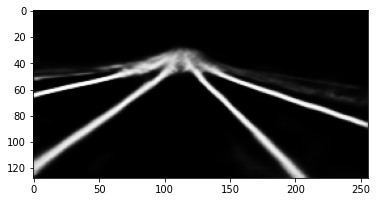

Train Epoch: 0 [23500/91660 (26%)]	Loss: 0.190894


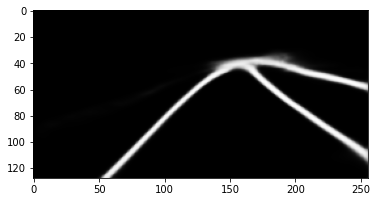

Train Epoch: 0 [23550/91660 (26%)]	Loss: 0.230552


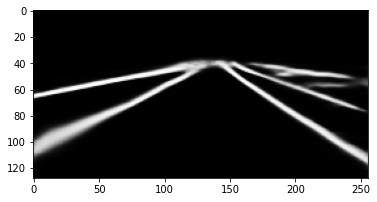

Train Epoch: 0 [23600/91660 (26%)]	Loss: 0.192479


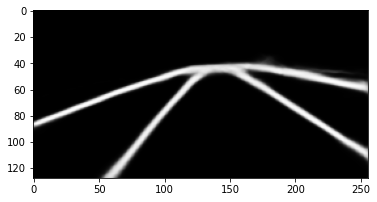

Train Epoch: 0 [23650/91660 (26%)]	Loss: 0.234346


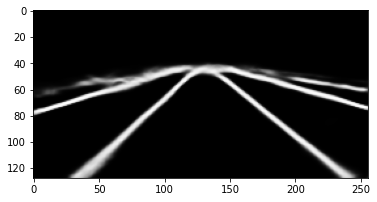

Train Epoch: 0 [23700/91660 (26%)]	Loss: 0.187460


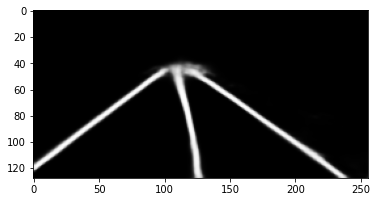

Train Epoch: 0 [23750/91660 (26%)]	Loss: 0.170519


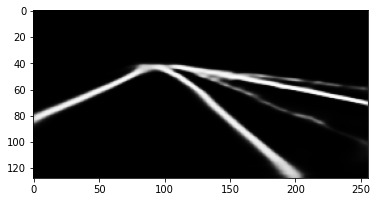

Train Epoch: 0 [23800/91660 (26%)]	Loss: 0.177251


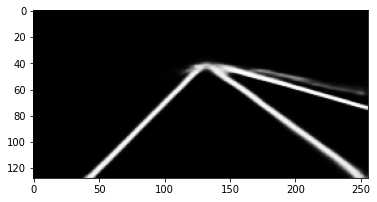

Train Epoch: 0 [23850/91660 (26%)]	Loss: 0.173219


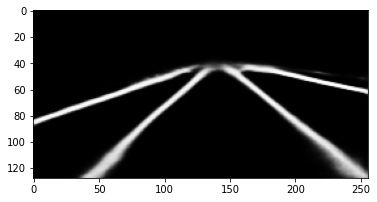

Train Epoch: 0 [23900/91660 (26%)]	Loss: 0.180432


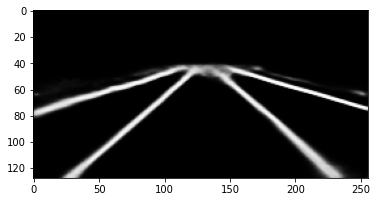

Train Epoch: 0 [23950/91660 (26%)]	Loss: 0.176026


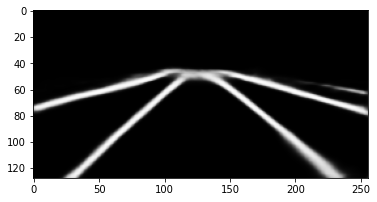

Train Epoch: 0 [24000/91660 (26%)]	Loss: 0.174164


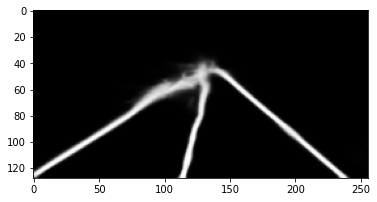

Train Epoch: 0 [24050/91660 (26%)]	Loss: 0.227720


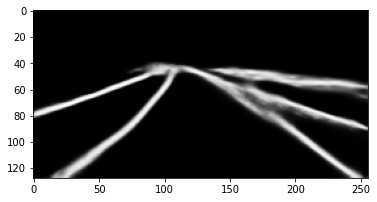

Train Epoch: 0 [24100/91660 (26%)]	Loss: 0.199540


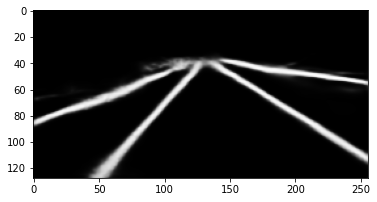

Train Epoch: 0 [24150/91660 (26%)]	Loss: 0.167506


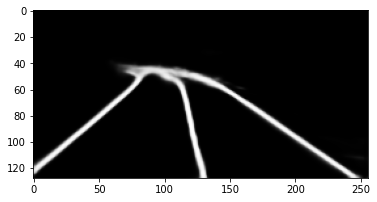

Train Epoch: 0 [24200/91660 (26%)]	Loss: 0.173590


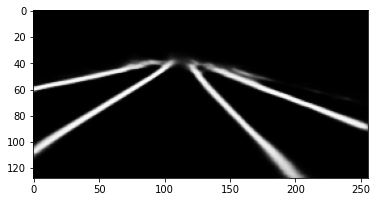

Train Epoch: 0 [24250/91660 (26%)]	Loss: 0.136971


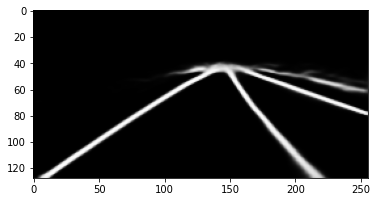

Train Epoch: 0 [24300/91660 (27%)]	Loss: 0.169332


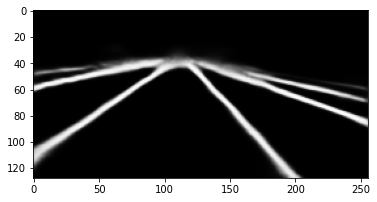

Train Epoch: 0 [24350/91660 (27%)]	Loss: 0.215948


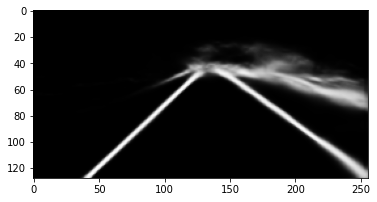

Train Epoch: 0 [24400/91660 (27%)]	Loss: 0.161488


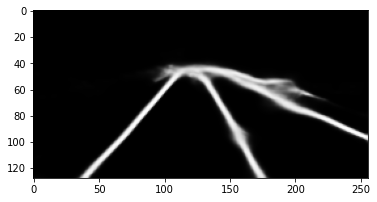

Train Epoch: 0 [24450/91660 (27%)]	Loss: 0.189119


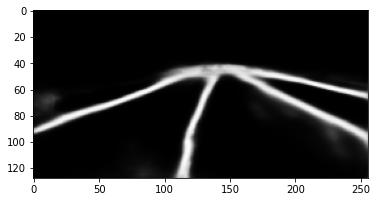

Train Epoch: 0 [24500/91660 (27%)]	Loss: 0.180643


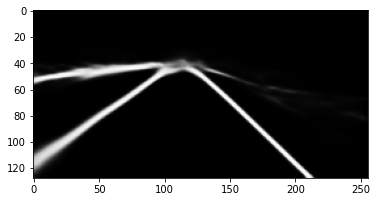

Train Epoch: 0 [24550/91660 (27%)]	Loss: 0.181193


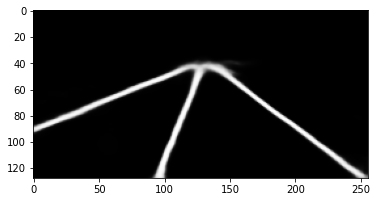

Train Epoch: 0 [24600/91660 (27%)]	Loss: 0.195203


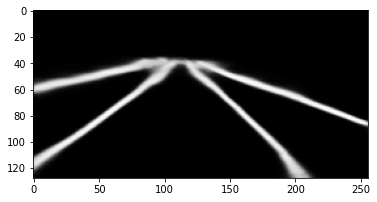

Train Epoch: 0 [24650/91660 (27%)]	Loss: 0.139881


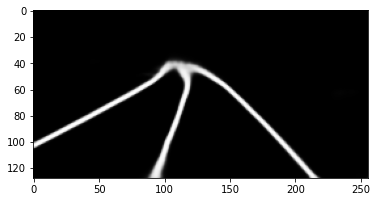

Train Epoch: 0 [24700/91660 (27%)]	Loss: 0.175291


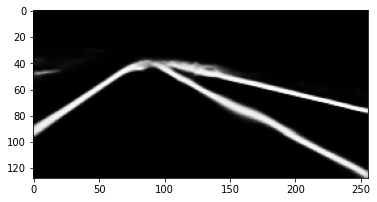

Train Epoch: 0 [24750/91660 (27%)]	Loss: 0.214955


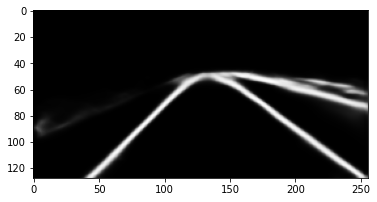

Train Epoch: 0 [24800/91660 (27%)]	Loss: 0.191447


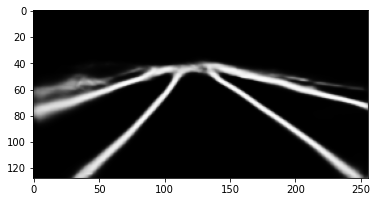

Train Epoch: 0 [24850/91660 (27%)]	Loss: 0.163579


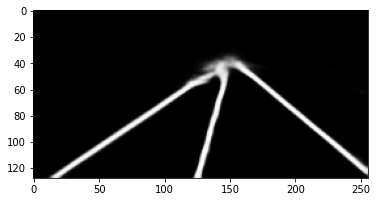

Train Epoch: 0 [24900/91660 (27%)]	Loss: 0.186753


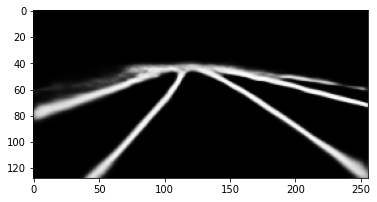

Train Epoch: 0 [24950/91660 (27%)]	Loss: 0.213827


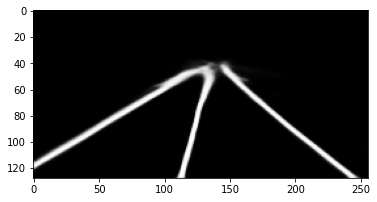

Train Epoch: 0 [25000/91660 (27%)]	Loss: 0.179222


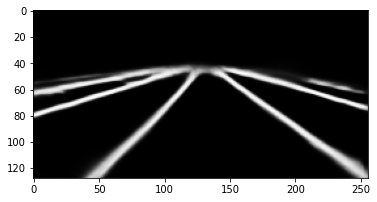

Train Epoch: 0 [25050/91660 (27%)]	Loss: 0.149233


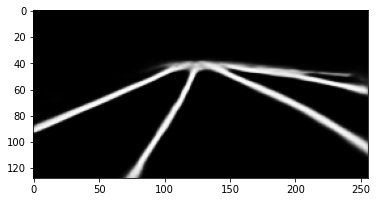

Train Epoch: 0 [25100/91660 (27%)]	Loss: 0.160391


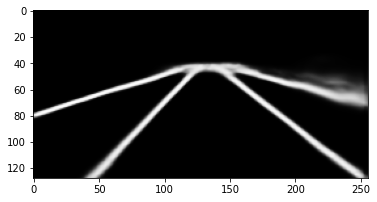

Train Epoch: 0 [25150/91660 (27%)]	Loss: 0.132563


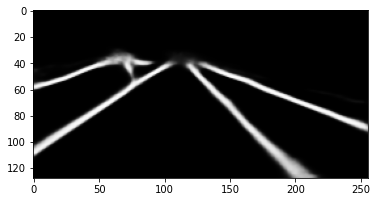

Train Epoch: 0 [25200/91660 (27%)]	Loss: 0.213873


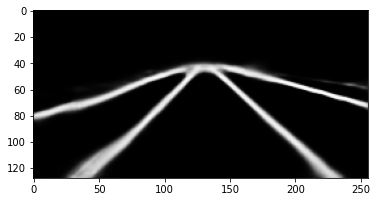

Train Epoch: 0 [25250/91660 (28%)]	Loss: 0.150212


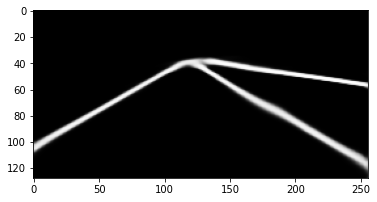

Train Epoch: 0 [25300/91660 (28%)]	Loss: 0.222670


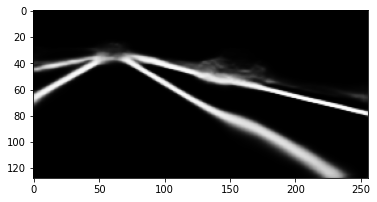

Train Epoch: 0 [25350/91660 (28%)]	Loss: 0.142928


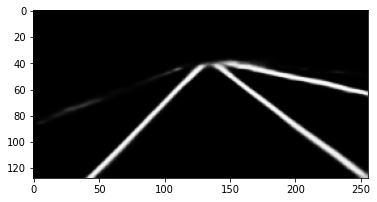

Train Epoch: 0 [25400/91660 (28%)]	Loss: 0.221832


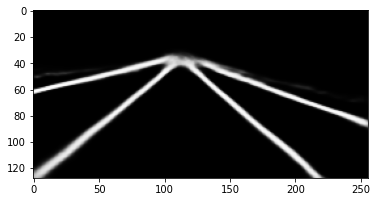

Train Epoch: 0 [25450/91660 (28%)]	Loss: 0.144816


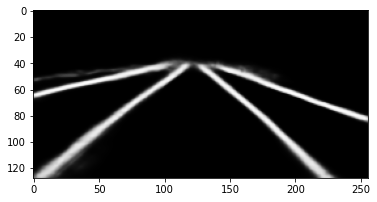

Train Epoch: 0 [25500/91660 (28%)]	Loss: 0.185313


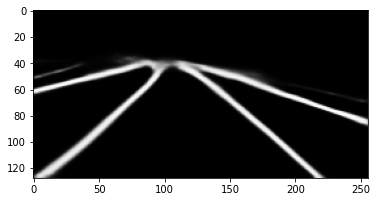

Train Epoch: 0 [25550/91660 (28%)]	Loss: 0.173780


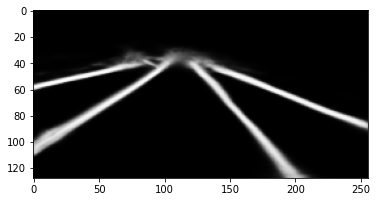

Train Epoch: 0 [25600/91660 (28%)]	Loss: 0.233821


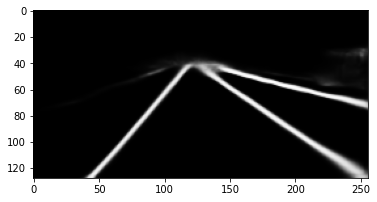

Train Epoch: 0 [25650/91660 (28%)]	Loss: 0.198753


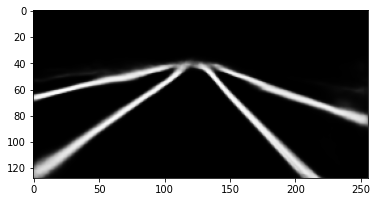

Train Epoch: 0 [25700/91660 (28%)]	Loss: 0.148915


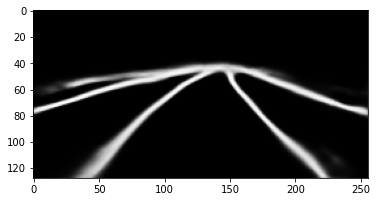

Train Epoch: 0 [25750/91660 (28%)]	Loss: 0.233335


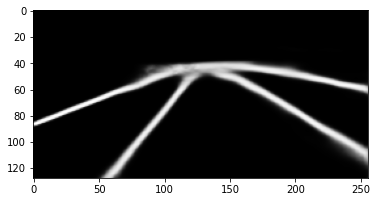

Train Epoch: 0 [25800/91660 (28%)]	Loss: 0.199969


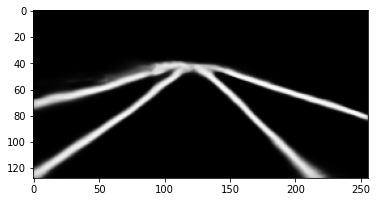

Train Epoch: 0 [25850/91660 (28%)]	Loss: 0.199466


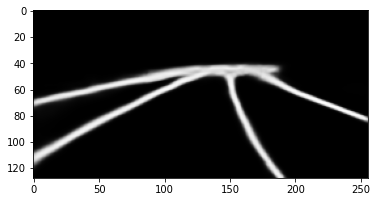

Train Epoch: 0 [25900/91660 (28%)]	Loss: 0.156698


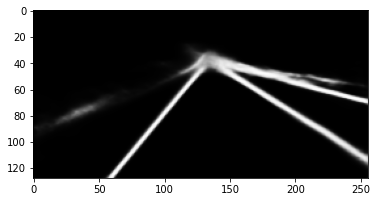

Train Epoch: 0 [25950/91660 (28%)]	Loss: 0.239233


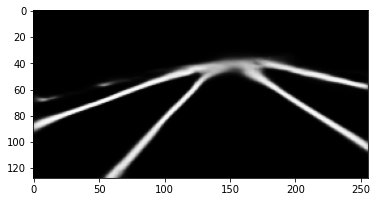

Train Epoch: 0 [26000/91660 (28%)]	Loss: 0.191791


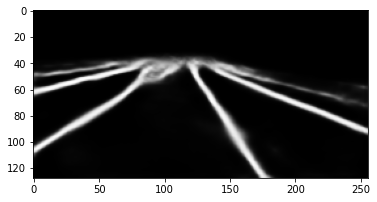

Train Epoch: 0 [26050/91660 (28%)]	Loss: 0.186324


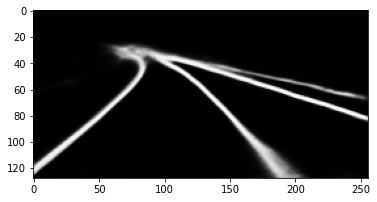

Train Epoch: 0 [26100/91660 (28%)]	Loss: 0.134746


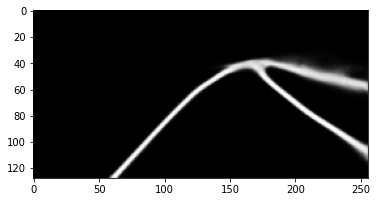

Train Epoch: 0 [26150/91660 (29%)]	Loss: 0.164901


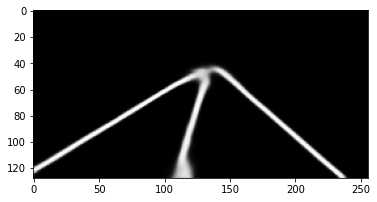

Train Epoch: 0 [26200/91660 (29%)]	Loss: 0.135122


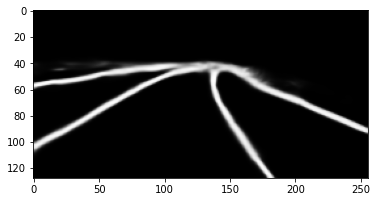

Train Epoch: 0 [26250/91660 (29%)]	Loss: 0.143175


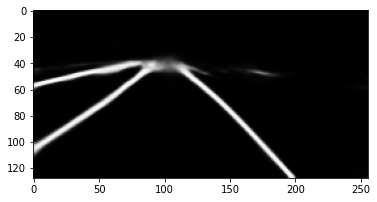

Train Epoch: 0 [26300/91660 (29%)]	Loss: 0.157643


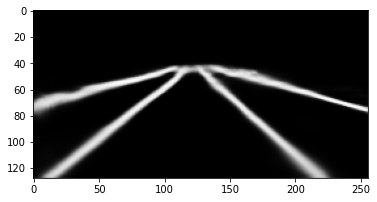

Train Epoch: 0 [26350/91660 (29%)]	Loss: 0.255452


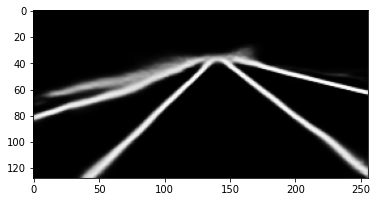

Train Epoch: 0 [26400/91660 (29%)]	Loss: 0.167033


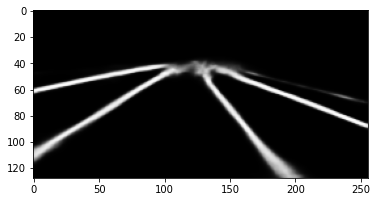

Train Epoch: 0 [26450/91660 (29%)]	Loss: 0.160404


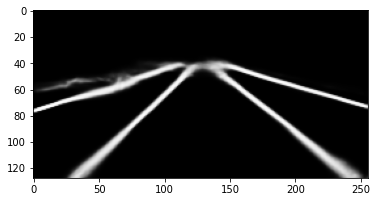

Train Epoch: 0 [26500/91660 (29%)]	Loss: 0.220308


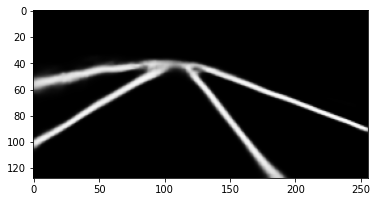

Train Epoch: 0 [26550/91660 (29%)]	Loss: 0.217137


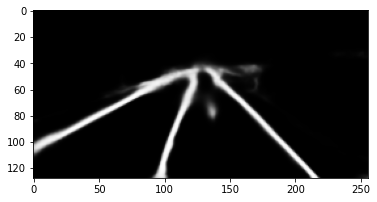

Train Epoch: 0 [26600/91660 (29%)]	Loss: 0.199916


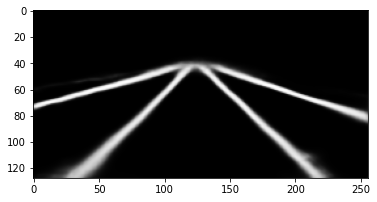

Train Epoch: 0 [26650/91660 (29%)]	Loss: 0.192637


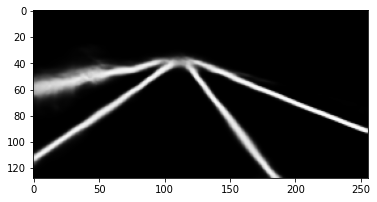

Train Epoch: 0 [26700/91660 (29%)]	Loss: 0.175748


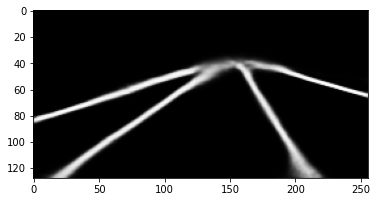

Train Epoch: 0 [26750/91660 (29%)]	Loss: 0.189494


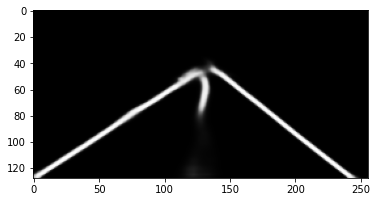

Train Epoch: 0 [26800/91660 (29%)]	Loss: 0.166295


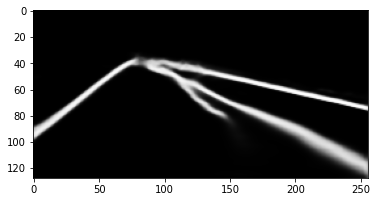

Train Epoch: 0 [26850/91660 (29%)]	Loss: 0.259284


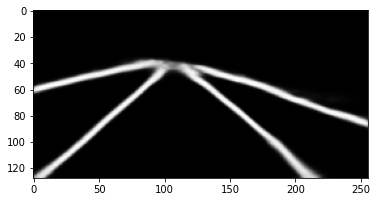

Train Epoch: 0 [26900/91660 (29%)]	Loss: 0.219162


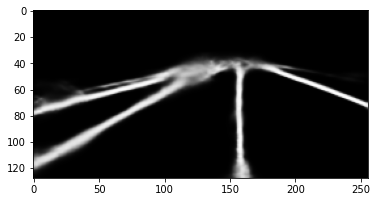

Train Epoch: 0 [26950/91660 (29%)]	Loss: 0.156840


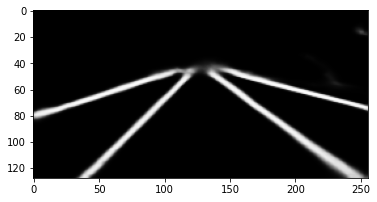

Train Epoch: 0 [27000/91660 (29%)]	Loss: 0.187942


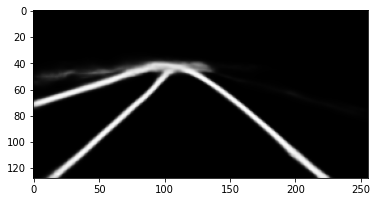

Train Epoch: 0 [27050/91660 (30%)]	Loss: 0.277299


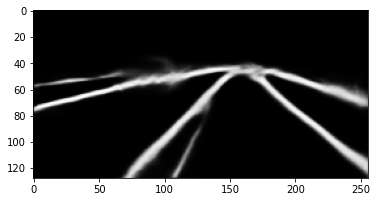

Train Epoch: 0 [27100/91660 (30%)]	Loss: 0.190744


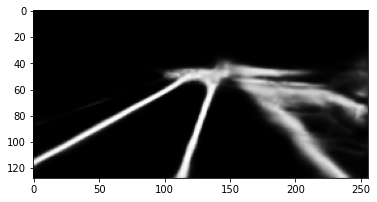

Train Epoch: 0 [27150/91660 (30%)]	Loss: 0.168211


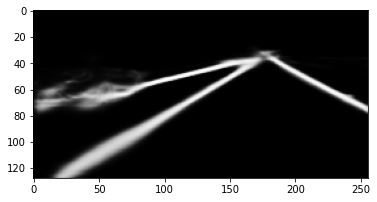

Train Epoch: 0 [27200/91660 (30%)]	Loss: 0.140601


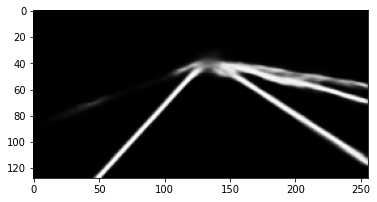

Train Epoch: 0 [27250/91660 (30%)]	Loss: 0.209685


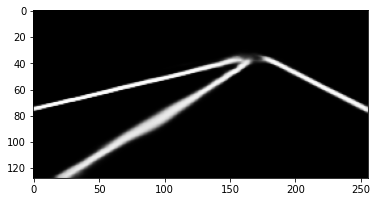

Train Epoch: 0 [27300/91660 (30%)]	Loss: 0.141020


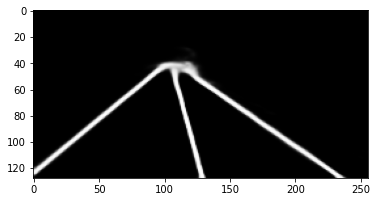

Train Epoch: 0 [27350/91660 (30%)]	Loss: 0.158104


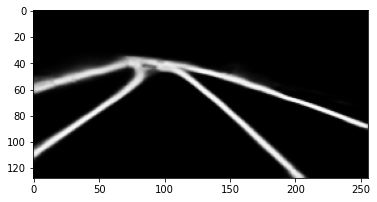

Train Epoch: 0 [27400/91660 (30%)]	Loss: 0.176323


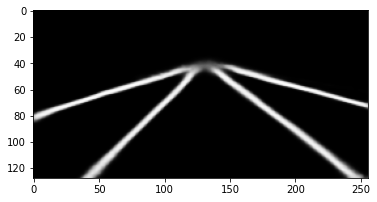

Train Epoch: 0 [27450/91660 (30%)]	Loss: 0.163819


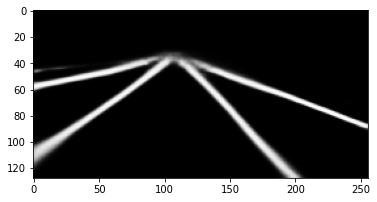

Train Epoch: 0 [27500/91660 (30%)]	Loss: 0.208250


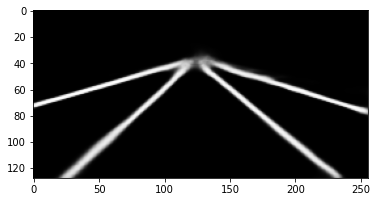

Train Epoch: 0 [27550/91660 (30%)]	Loss: 0.167857


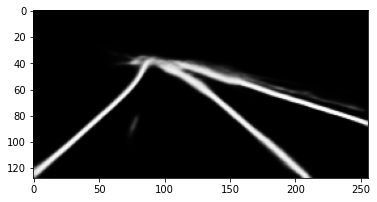

Train Epoch: 0 [27600/91660 (30%)]	Loss: 0.203120


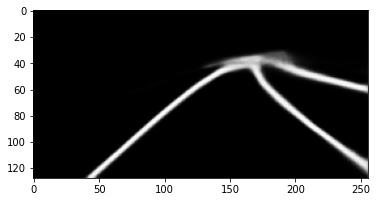

Train Epoch: 0 [27650/91660 (30%)]	Loss: 0.177651


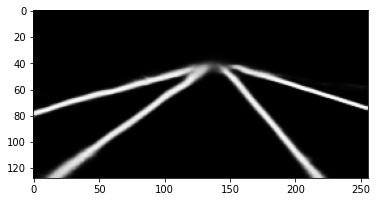

Train Epoch: 0 [27700/91660 (30%)]	Loss: 0.164812


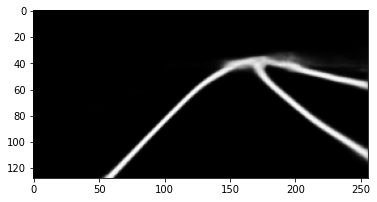

Train Epoch: 0 [27750/91660 (30%)]	Loss: 0.182953


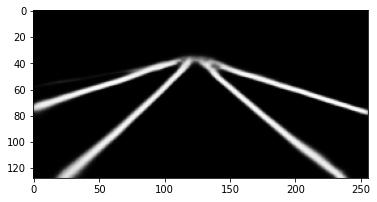

Train Epoch: 0 [27800/91660 (30%)]	Loss: 0.147708


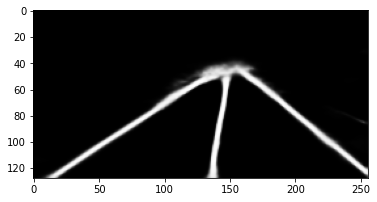

Train Epoch: 0 [27850/91660 (30%)]	Loss: 0.239186


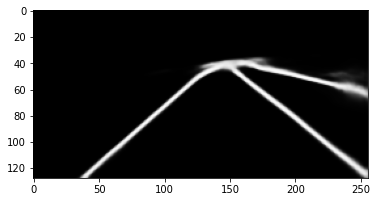

Train Epoch: 0 [27900/91660 (30%)]	Loss: 0.160526


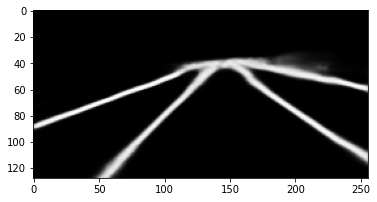

Train Epoch: 0 [27950/91660 (30%)]	Loss: 0.170221


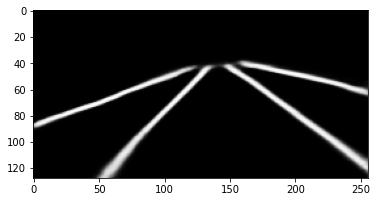

Train Epoch: 0 [28000/91660 (31%)]	Loss: 0.166073


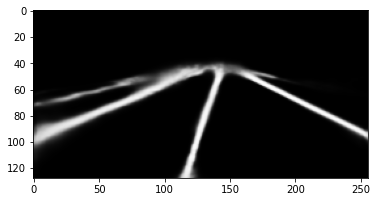

Train Epoch: 0 [28050/91660 (31%)]	Loss: 0.150505


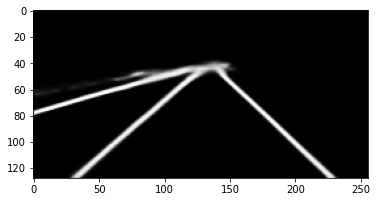

Train Epoch: 0 [28100/91660 (31%)]	Loss: 0.164785


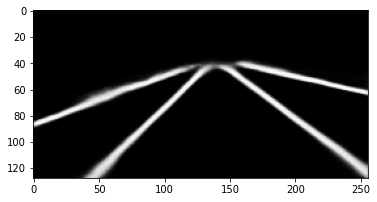

Train Epoch: 0 [28150/91660 (31%)]	Loss: 0.168958


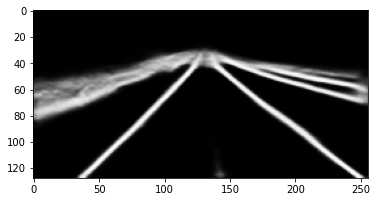

Train Epoch: 0 [28200/91660 (31%)]	Loss: 0.154882


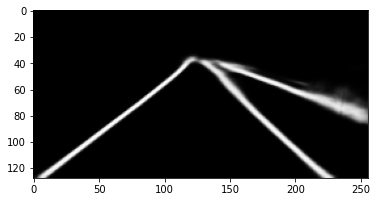

Train Epoch: 0 [28250/91660 (31%)]	Loss: 0.182055


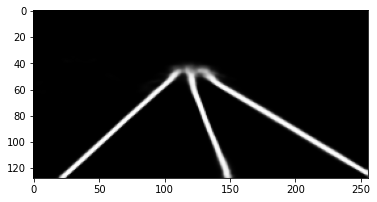

Train Epoch: 0 [28300/91660 (31%)]	Loss: 0.189608


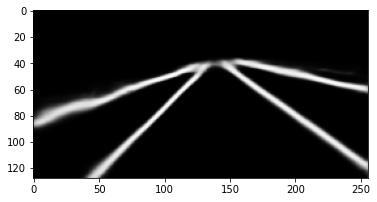

Train Epoch: 0 [28350/91660 (31%)]	Loss: 0.202387


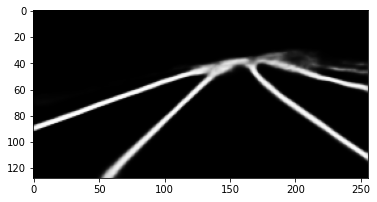

Train Epoch: 0 [28400/91660 (31%)]	Loss: 0.236674


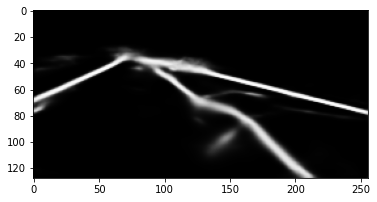

Train Epoch: 0 [28450/91660 (31%)]	Loss: 0.327604


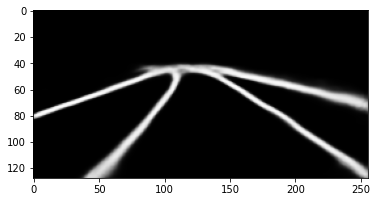

Train Epoch: 0 [28500/91660 (31%)]	Loss: 0.222632


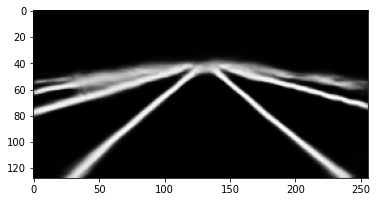

Train Epoch: 0 [28550/91660 (31%)]	Loss: 0.166070


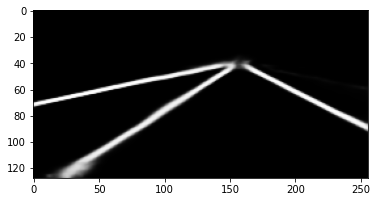

Train Epoch: 0 [28600/91660 (31%)]	Loss: 0.148708


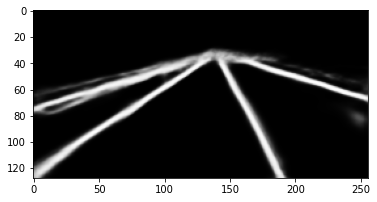

Train Epoch: 0 [28650/91660 (31%)]	Loss: 0.172542


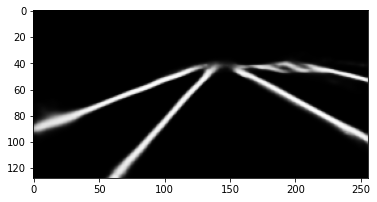

Train Epoch: 0 [28700/91660 (31%)]	Loss: 0.149450


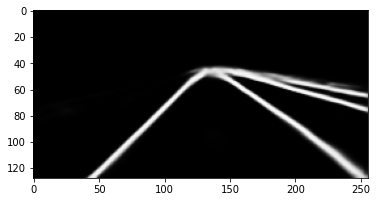

Train Epoch: 0 [28750/91660 (31%)]	Loss: 0.184557


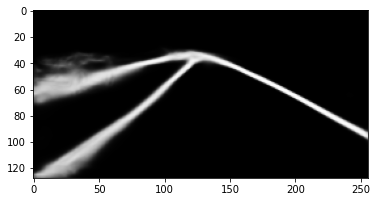

Train Epoch: 0 [28800/91660 (31%)]	Loss: 0.134697


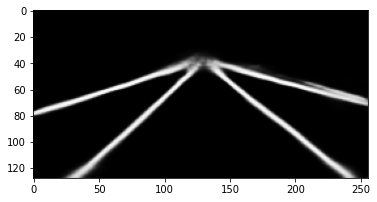

Train Epoch: 0 [28850/91660 (31%)]	Loss: 0.171800


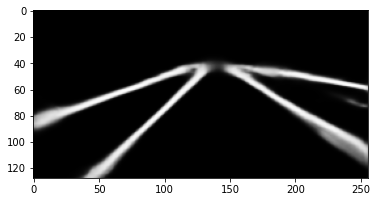

Train Epoch: 0 [28900/91660 (32%)]	Loss: 0.175085


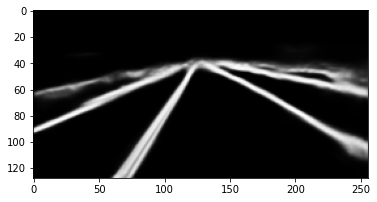

Train Epoch: 0 [28950/91660 (32%)]	Loss: 0.152101


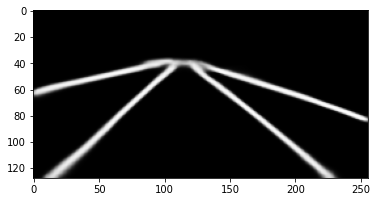

Train Epoch: 0 [29000/91660 (32%)]	Loss: 0.126412


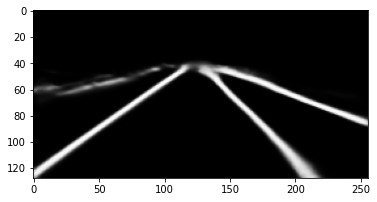

Train Epoch: 0 [29050/91660 (32%)]	Loss: 0.207795


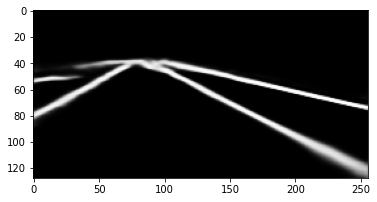

Train Epoch: 0 [29100/91660 (32%)]	Loss: 0.151204


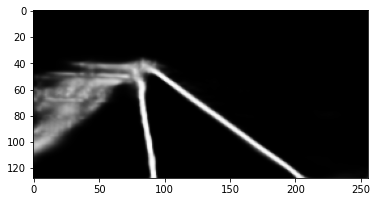

Train Epoch: 0 [29150/91660 (32%)]	Loss: 0.173367


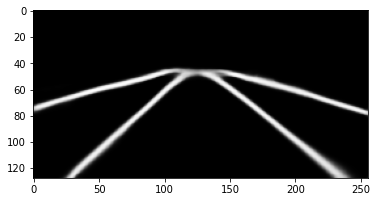

Train Epoch: 0 [29200/91660 (32%)]	Loss: 0.176745


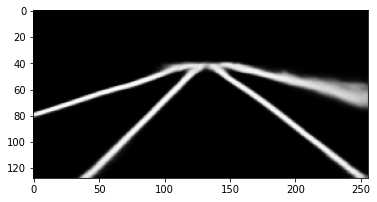

Train Epoch: 0 [29250/91660 (32%)]	Loss: 0.166764


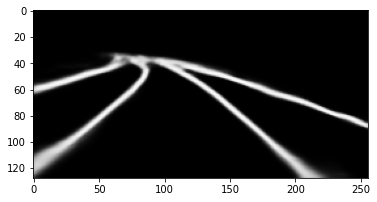

Train Epoch: 0 [29300/91660 (32%)]	Loss: 0.227757


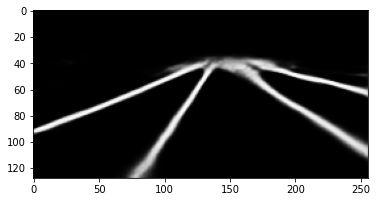

Train Epoch: 0 [29350/91660 (32%)]	Loss: 0.145912


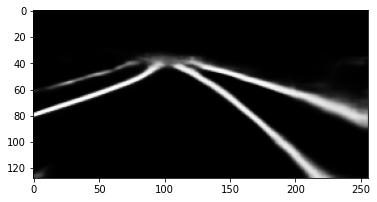

Train Epoch: 0 [29400/91660 (32%)]	Loss: 0.179807


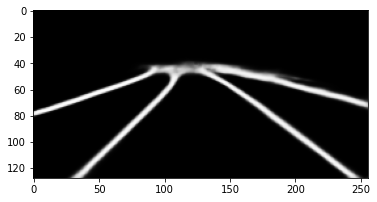

Train Epoch: 0 [29450/91660 (32%)]	Loss: 0.149640


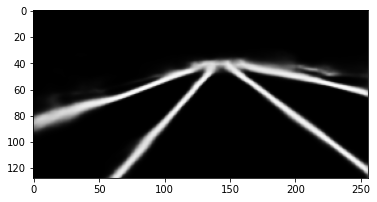

Train Epoch: 0 [29500/91660 (32%)]	Loss: 0.188890


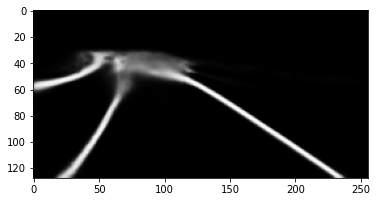

Train Epoch: 0 [29550/91660 (32%)]	Loss: 0.147938


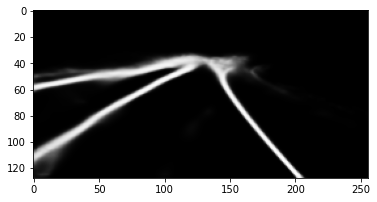

Train Epoch: 0 [29600/91660 (32%)]	Loss: 0.162360


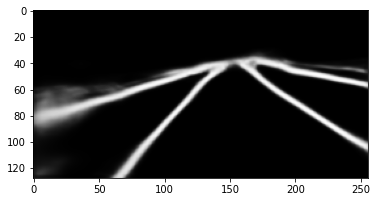

Train Epoch: 0 [29650/91660 (32%)]	Loss: 0.140905


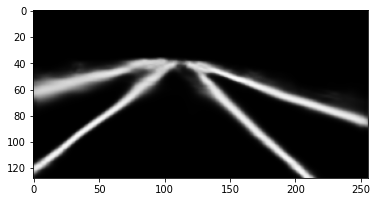

Train Epoch: 0 [29700/91660 (32%)]	Loss: 0.169801


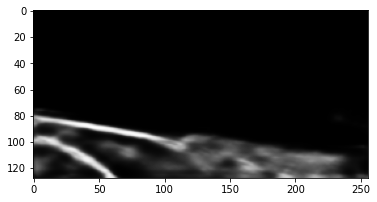

Train Epoch: 0 [29750/91660 (32%)]	Loss: 0.130776


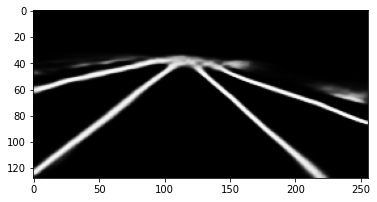

Train Epoch: 0 [29800/91660 (33%)]	Loss: 0.129023


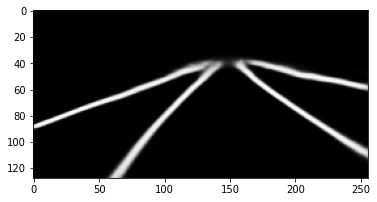

Train Epoch: 0 [29850/91660 (33%)]	Loss: 0.154799


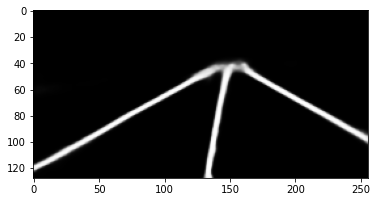

Train Epoch: 0 [29900/91660 (33%)]	Loss: 0.183113


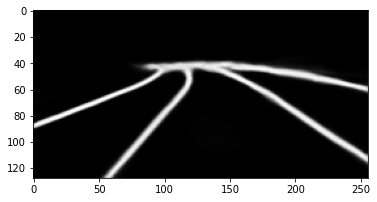

Train Epoch: 0 [29950/91660 (33%)]	Loss: 0.211869


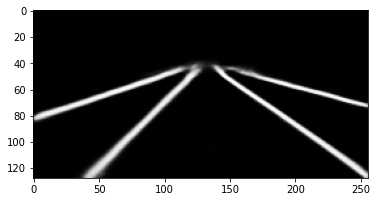

Train Epoch: 0 [30000/91660 (33%)]	Loss: 0.198375


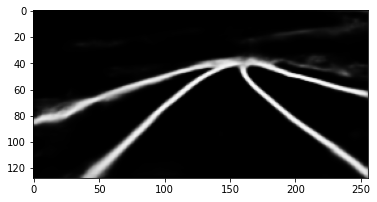

Train Epoch: 0 [30050/91660 (33%)]	Loss: 0.133472


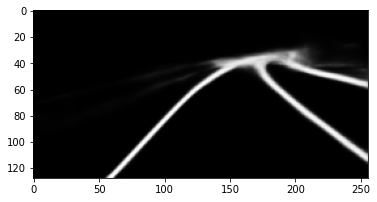

Train Epoch: 0 [30100/91660 (33%)]	Loss: 0.157725


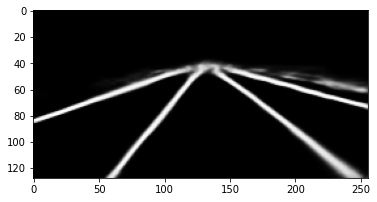

Train Epoch: 0 [30150/91660 (33%)]	Loss: 0.157042


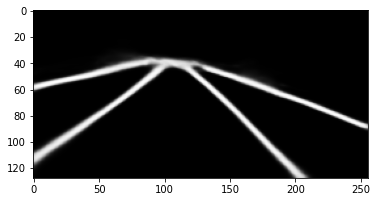

Train Epoch: 0 [30200/91660 (33%)]	Loss: 0.190457


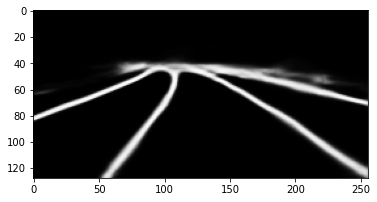

Train Epoch: 0 [30250/91660 (33%)]	Loss: 0.164533


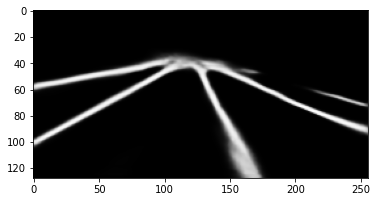

Train Epoch: 0 [30300/91660 (33%)]	Loss: 0.275884


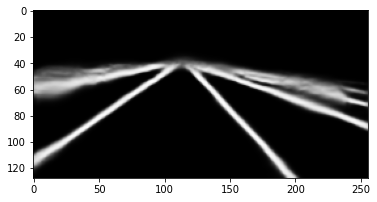

Train Epoch: 0 [30350/91660 (33%)]	Loss: 0.182467


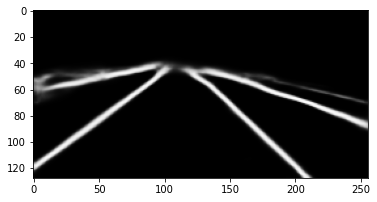

Train Epoch: 0 [30400/91660 (33%)]	Loss: 0.154022


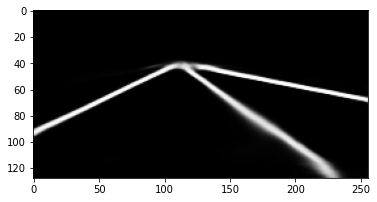

Train Epoch: 0 [30450/91660 (33%)]	Loss: 0.145911


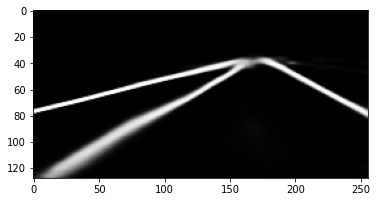

Train Epoch: 0 [30500/91660 (33%)]	Loss: 0.147183


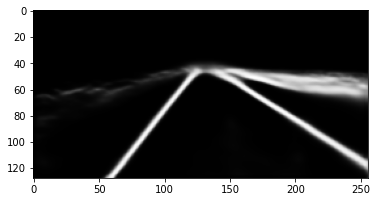

Train Epoch: 0 [30550/91660 (33%)]	Loss: 0.166678


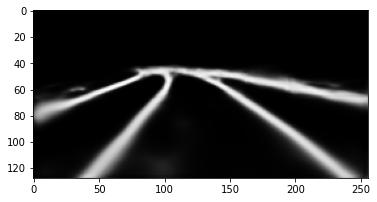

Train Epoch: 0 [30600/91660 (33%)]	Loss: 0.129066


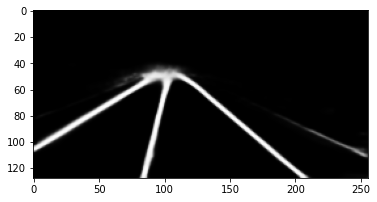

Train Epoch: 0 [30650/91660 (33%)]	Loss: 0.196690


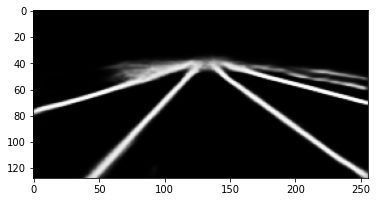

Train Epoch: 0 [30700/91660 (33%)]	Loss: 0.179025


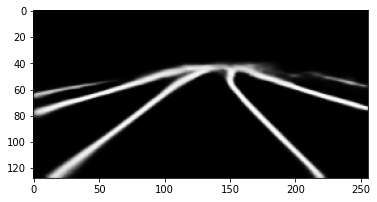

Train Epoch: 0 [30750/91660 (34%)]	Loss: 0.148327


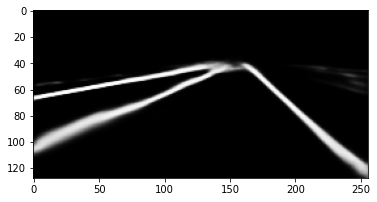

Train Epoch: 0 [30800/91660 (34%)]	Loss: 0.186633


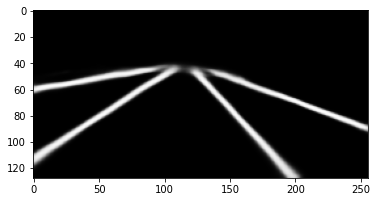

Train Epoch: 0 [30850/91660 (34%)]	Loss: 0.146055


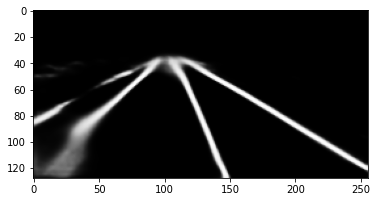

Train Epoch: 0 [30900/91660 (34%)]	Loss: 0.150417


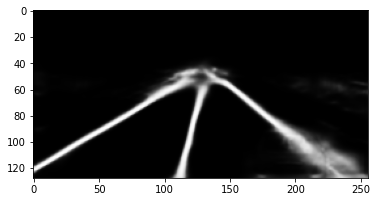

Train Epoch: 0 [30950/91660 (34%)]	Loss: 0.192968


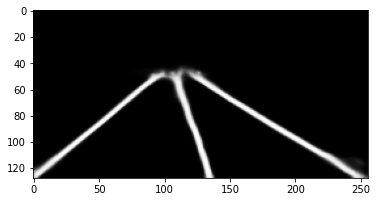

Train Epoch: 0 [31000/91660 (34%)]	Loss: 0.199188


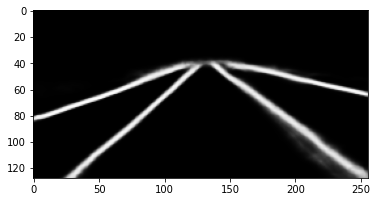

Train Epoch: 0 [31050/91660 (34%)]	Loss: 0.216531


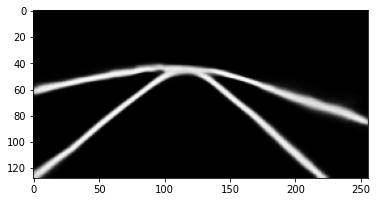

Train Epoch: 0 [31100/91660 (34%)]	Loss: 0.147413


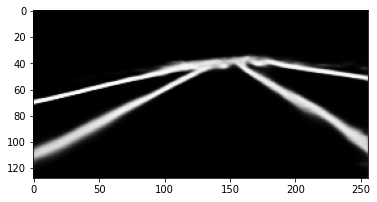

Train Epoch: 0 [31150/91660 (34%)]	Loss: 0.161996


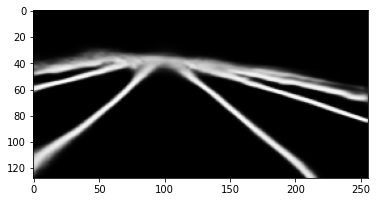

Train Epoch: 0 [31200/91660 (34%)]	Loss: 0.144927


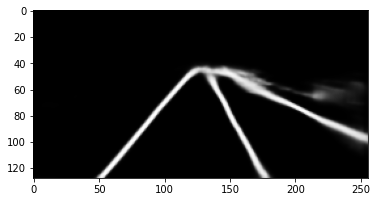

Train Epoch: 0 [31250/91660 (34%)]	Loss: 0.160422


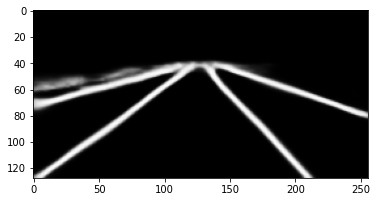

Train Epoch: 0 [31300/91660 (34%)]	Loss: 0.161797


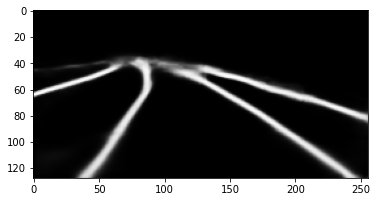

Train Epoch: 0 [31350/91660 (34%)]	Loss: 0.136527


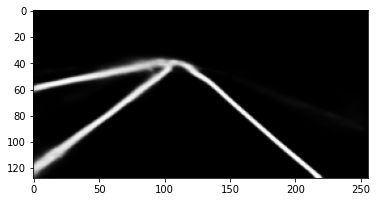

Train Epoch: 0 [31400/91660 (34%)]	Loss: 0.122260


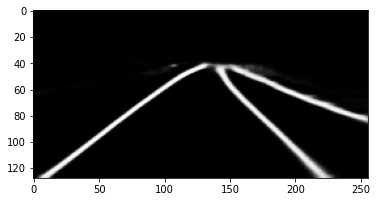

Train Epoch: 0 [31450/91660 (34%)]	Loss: 0.147217


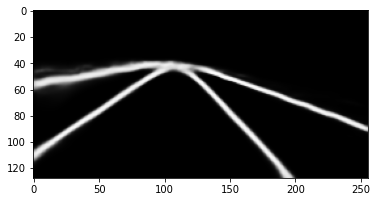

Train Epoch: 0 [31500/91660 (34%)]	Loss: 0.177492


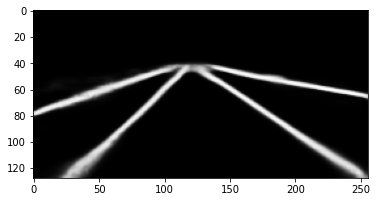

Train Epoch: 0 [31550/91660 (34%)]	Loss: 0.143220


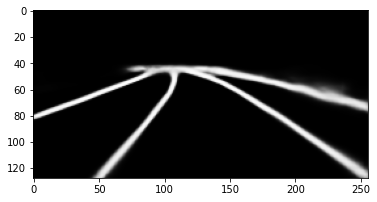

Train Epoch: 0 [31600/91660 (34%)]	Loss: 0.174235


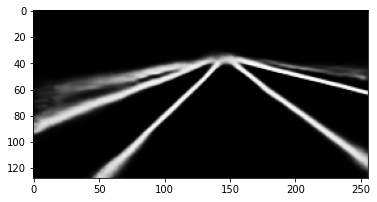

Train Epoch: 0 [31650/91660 (35%)]	Loss: 0.202248


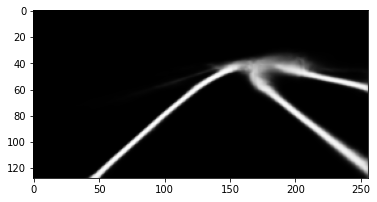

Train Epoch: 0 [31700/91660 (35%)]	Loss: 0.135491


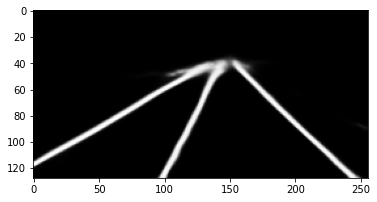

Train Epoch: 0 [31750/91660 (35%)]	Loss: 0.172950


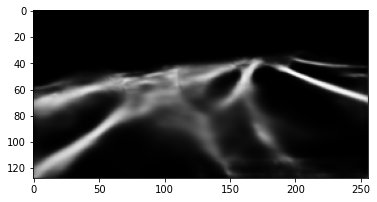

Train Epoch: 0 [31800/91660 (35%)]	Loss: 0.183514


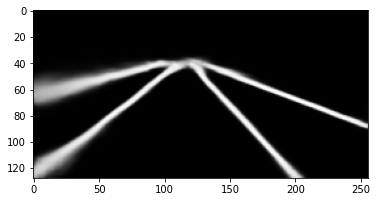

Train Epoch: 0 [31850/91660 (35%)]	Loss: 0.176919


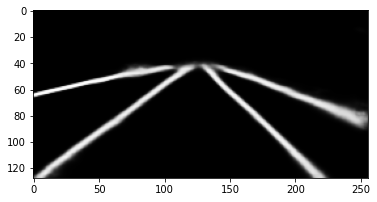

Train Epoch: 0 [31900/91660 (35%)]	Loss: 0.163862


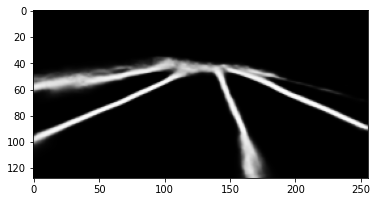

Train Epoch: 0 [31950/91660 (35%)]	Loss: 0.154193


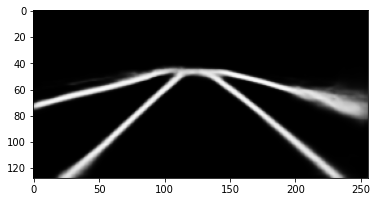

Train Epoch: 0 [32000/91660 (35%)]	Loss: 0.139728


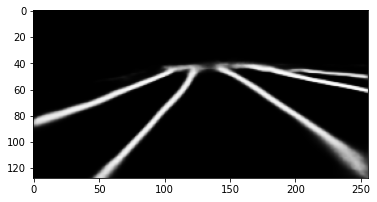

Train Epoch: 0 [32050/91660 (35%)]	Loss: 0.152613


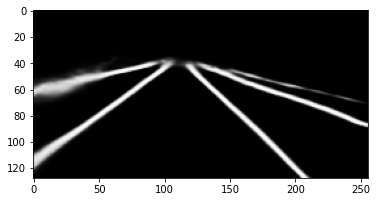

Train Epoch: 0 [32100/91660 (35%)]	Loss: 0.133623


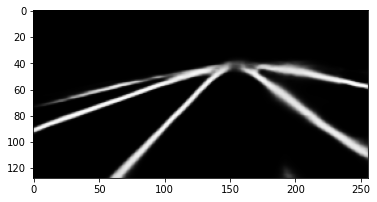

Train Epoch: 0 [32150/91660 (35%)]	Loss: 0.143614


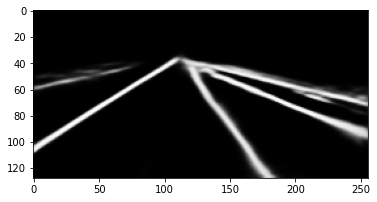

Train Epoch: 0 [32200/91660 (35%)]	Loss: 0.163836


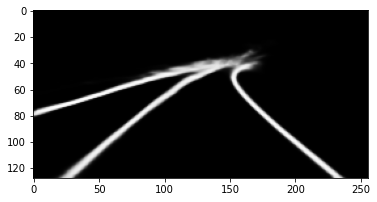

Train Epoch: 0 [32250/91660 (35%)]	Loss: 0.185443


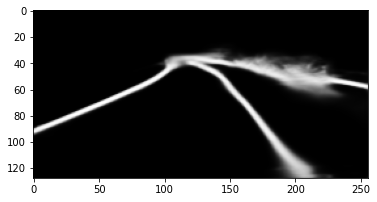

Train Epoch: 0 [32300/91660 (35%)]	Loss: 0.153761


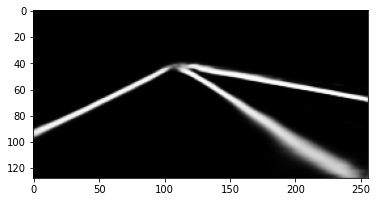

Train Epoch: 0 [32350/91660 (35%)]	Loss: 0.154813


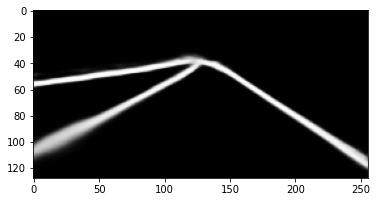

Train Epoch: 0 [32400/91660 (35%)]	Loss: 0.194276


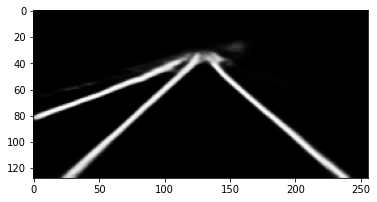

Train Epoch: 0 [32450/91660 (35%)]	Loss: 0.277470


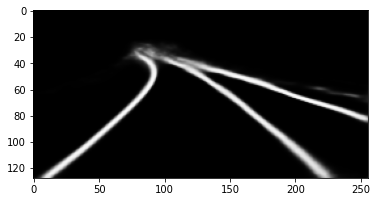

Train Epoch: 0 [32500/91660 (35%)]	Loss: 0.181228


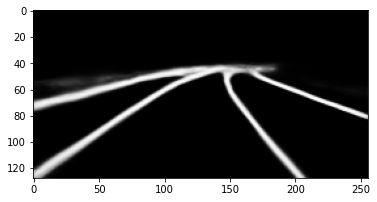

Train Epoch: 0 [32550/91660 (36%)]	Loss: 0.146953


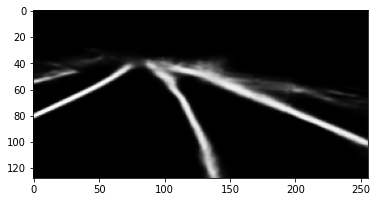

Train Epoch: 0 [32600/91660 (36%)]	Loss: 0.142784


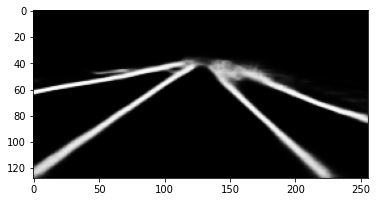

Train Epoch: 0 [32650/91660 (36%)]	Loss: 0.180954


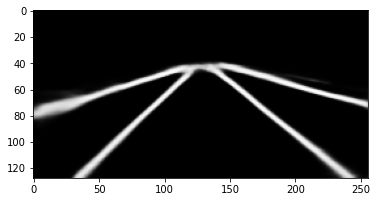

Train Epoch: 0 [32700/91660 (36%)]	Loss: 0.277312


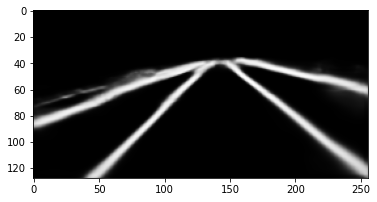

Train Epoch: 0 [32750/91660 (36%)]	Loss: 0.165844


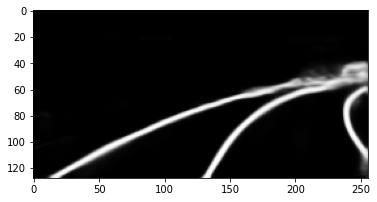

Train Epoch: 0 [32800/91660 (36%)]	Loss: 0.227017


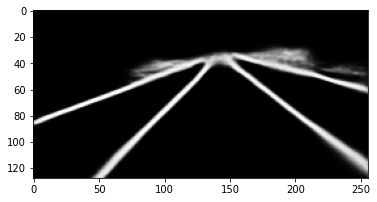

Train Epoch: 0 [32850/91660 (36%)]	Loss: 0.191860


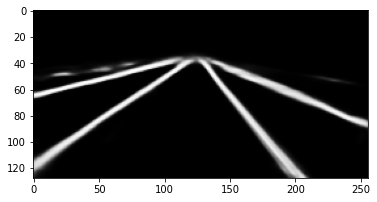

Train Epoch: 0 [32900/91660 (36%)]	Loss: 0.271074


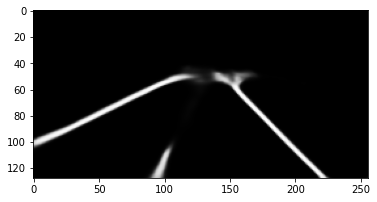

Train Epoch: 0 [32950/91660 (36%)]	Loss: 0.207821


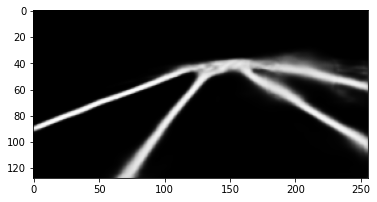

Train Epoch: 0 [33000/91660 (36%)]	Loss: 0.180244


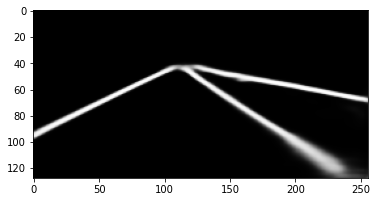

Train Epoch: 0 [33050/91660 (36%)]	Loss: 0.180462


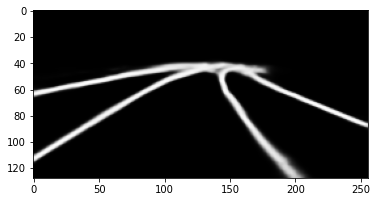

Train Epoch: 0 [33100/91660 (36%)]	Loss: 0.145217


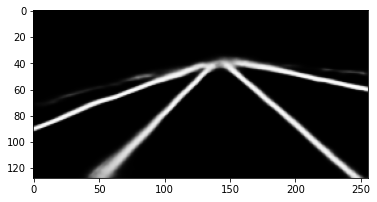

Train Epoch: 0 [33150/91660 (36%)]	Loss: 0.144477


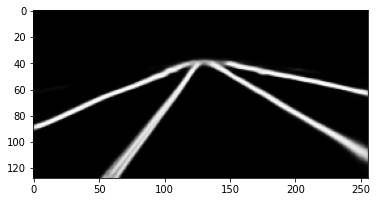

Train Epoch: 0 [33200/91660 (36%)]	Loss: 0.176550


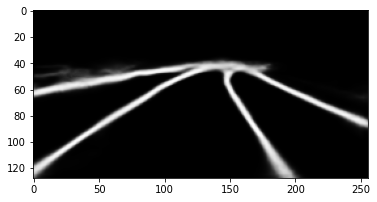

Train Epoch: 0 [33250/91660 (36%)]	Loss: 0.148345


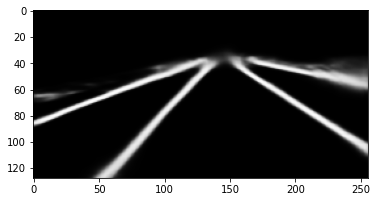

Train Epoch: 0 [33300/91660 (36%)]	Loss: 0.149751


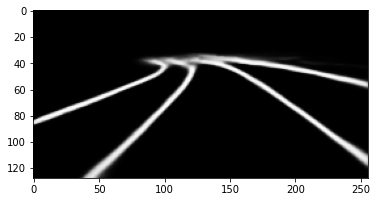

Train Epoch: 0 [33350/91660 (36%)]	Loss: 0.137435


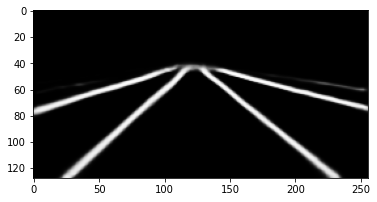

Train Epoch: 0 [33400/91660 (36%)]	Loss: 0.127418


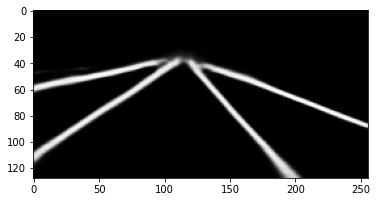

Train Epoch: 0 [33450/91660 (36%)]	Loss: 0.156221


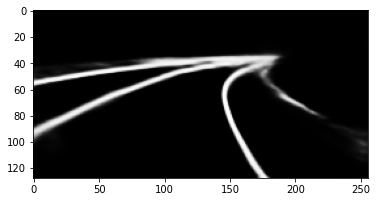

Train Epoch: 0 [33500/91660 (37%)]	Loss: 0.174153


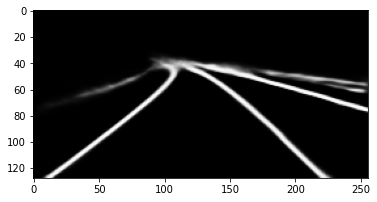

Train Epoch: 0 [33550/91660 (37%)]	Loss: 0.120530


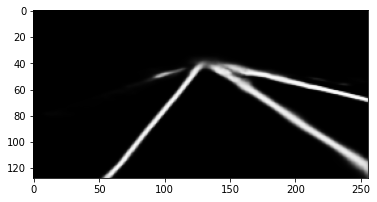

Train Epoch: 0 [33600/91660 (37%)]	Loss: 0.144225


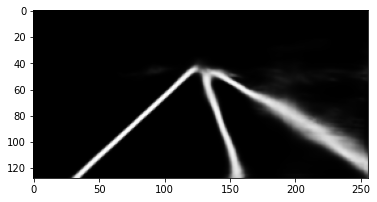

Train Epoch: 0 [33650/91660 (37%)]	Loss: 0.158644


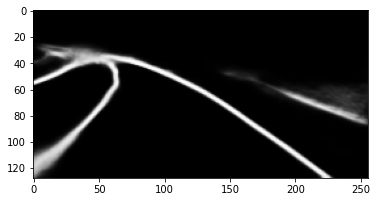

Train Epoch: 0 [33700/91660 (37%)]	Loss: 0.162481


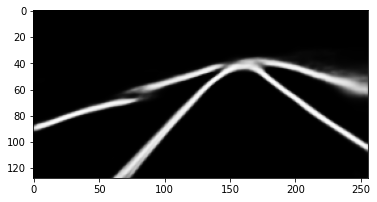

Train Epoch: 0 [33750/91660 (37%)]	Loss: 0.212443


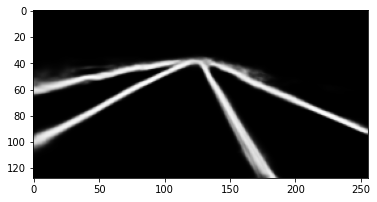

Train Epoch: 0 [33800/91660 (37%)]	Loss: 0.180372


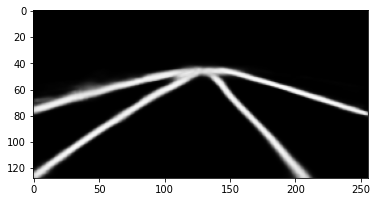

Train Epoch: 0 [33850/91660 (37%)]	Loss: 0.165363


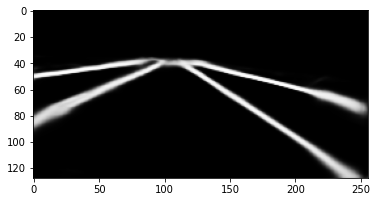

Train Epoch: 0 [33900/91660 (37%)]	Loss: 0.146611


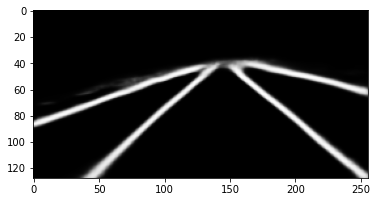

Train Epoch: 0 [33950/91660 (37%)]	Loss: 0.148945


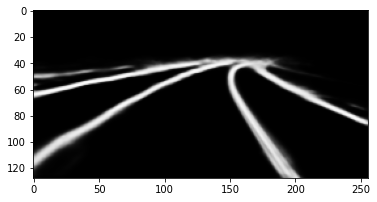

Train Epoch: 0 [34000/91660 (37%)]	Loss: 0.182993


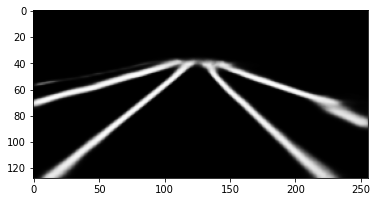

Train Epoch: 0 [34050/91660 (37%)]	Loss: 0.200113


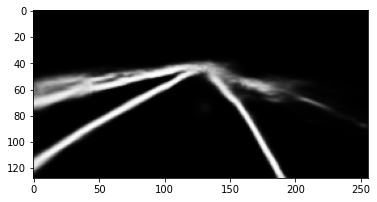

Train Epoch: 0 [34100/91660 (37%)]	Loss: 0.166515


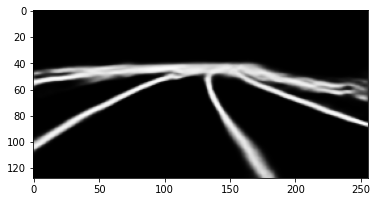

Train Epoch: 0 [34150/91660 (37%)]	Loss: 0.182711


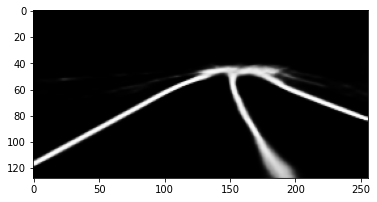

Train Epoch: 0 [34200/91660 (37%)]	Loss: 0.161033


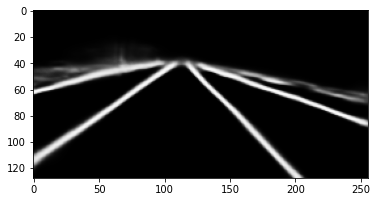

Train Epoch: 0 [34250/91660 (37%)]	Loss: 0.148735


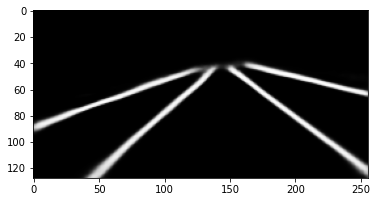

Train Epoch: 0 [34300/91660 (37%)]	Loss: 0.170990


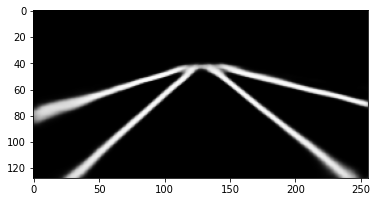

Train Epoch: 0 [34350/91660 (37%)]	Loss: 0.139537


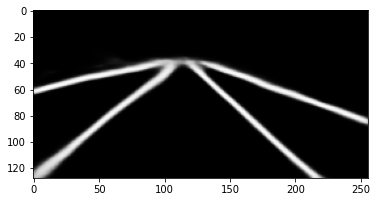

Train Epoch: 0 [34400/91660 (38%)]	Loss: 0.167870


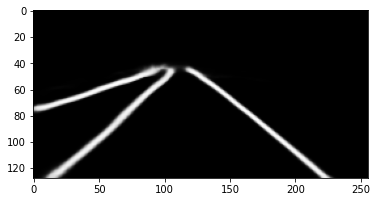

Train Epoch: 0 [34450/91660 (38%)]	Loss: 0.159714


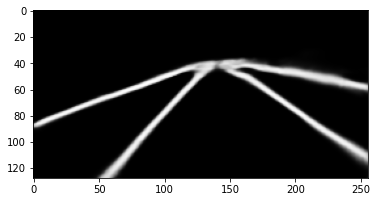

Train Epoch: 0 [34500/91660 (38%)]	Loss: 0.182604


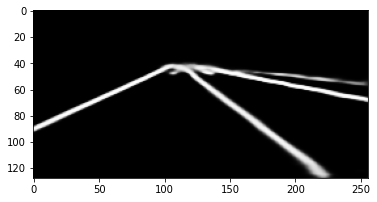

Train Epoch: 0 [34550/91660 (38%)]	Loss: 0.140885


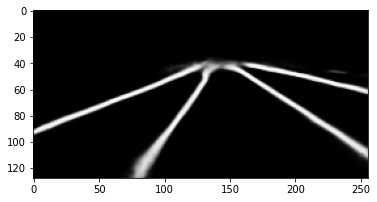

Train Epoch: 0 [34600/91660 (38%)]	Loss: 0.175115


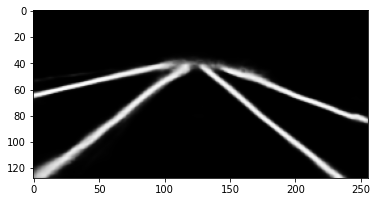

Train Epoch: 0 [34650/91660 (38%)]	Loss: 0.162965


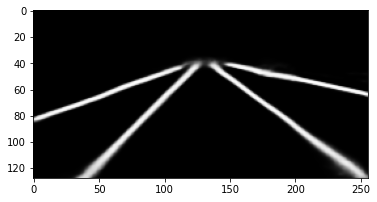

Train Epoch: 0 [34700/91660 (38%)]	Loss: 0.181890


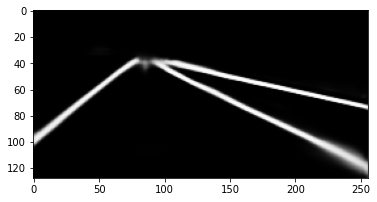

Train Epoch: 0 [34750/91660 (38%)]	Loss: 0.150701


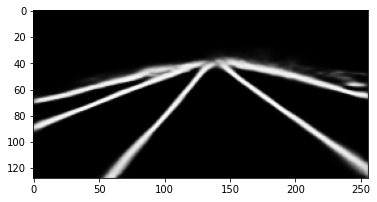

Train Epoch: 0 [34800/91660 (38%)]	Loss: 0.169175


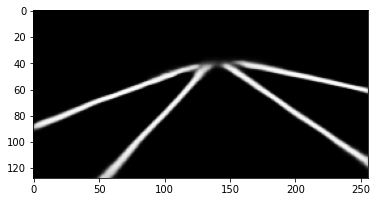

Train Epoch: 0 [34850/91660 (38%)]	Loss: 0.169868


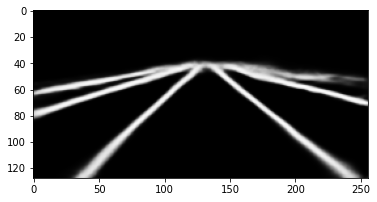

Train Epoch: 0 [34900/91660 (38%)]	Loss: 0.153158


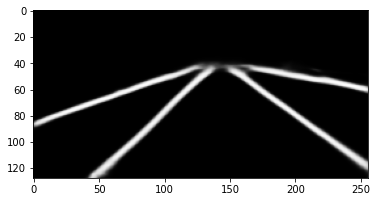

Train Epoch: 0 [34950/91660 (38%)]	Loss: 0.120398


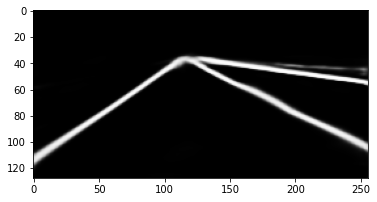

Train Epoch: 0 [35000/91660 (38%)]	Loss: 0.142853


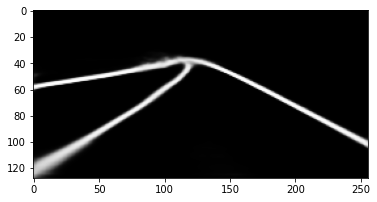

Train Epoch: 0 [35050/91660 (38%)]	Loss: 0.169808


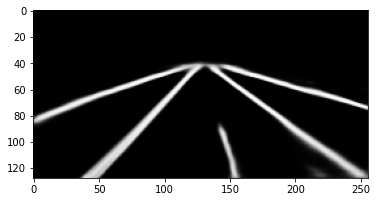

Train Epoch: 0 [35100/91660 (38%)]	Loss: 0.144034


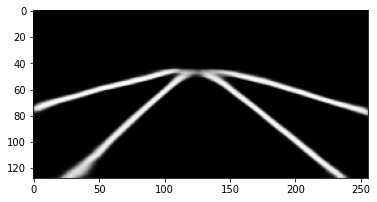

Train Epoch: 0 [35150/91660 (38%)]	Loss: 0.183355


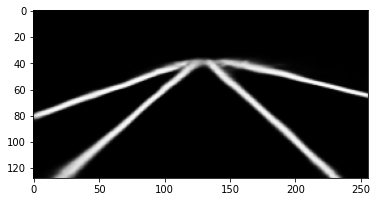

Train Epoch: 0 [35200/91660 (38%)]	Loss: 0.140946


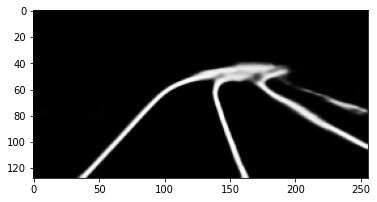

Train Epoch: 0 [35250/91660 (38%)]	Loss: 0.177773


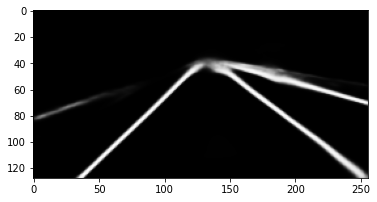

Train Epoch: 0 [35300/91660 (39%)]	Loss: 0.172230


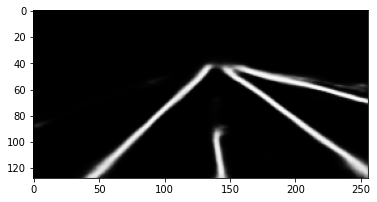

Train Epoch: 0 [35350/91660 (39%)]	Loss: 0.135133


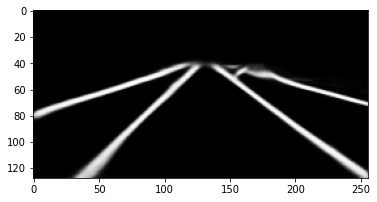

Train Epoch: 0 [35400/91660 (39%)]	Loss: 0.153896


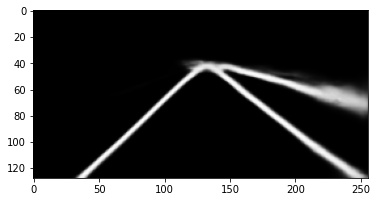

Train Epoch: 0 [35450/91660 (39%)]	Loss: 0.193131


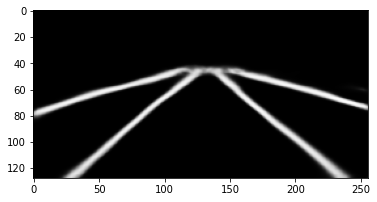

Train Epoch: 0 [35500/91660 (39%)]	Loss: 0.192769


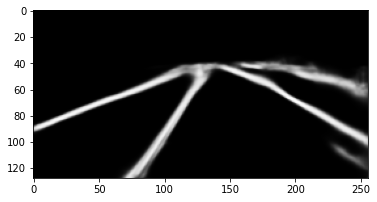

Train Epoch: 0 [35550/91660 (39%)]	Loss: 0.213630


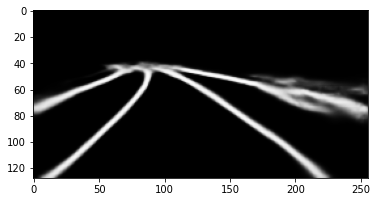

Train Epoch: 0 [35600/91660 (39%)]	Loss: 0.112247


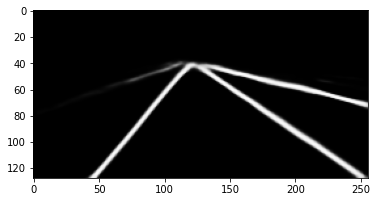

Train Epoch: 0 [35650/91660 (39%)]	Loss: 0.149895


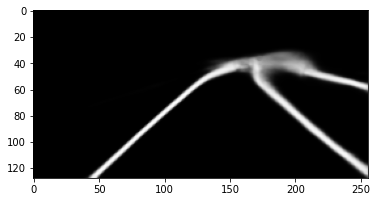

Train Epoch: 0 [35700/91660 (39%)]	Loss: 0.165317


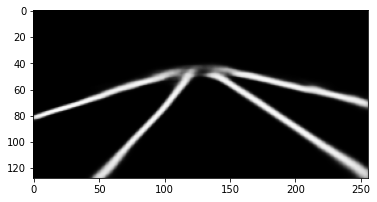

Train Epoch: 0 [35750/91660 (39%)]	Loss: 0.165543


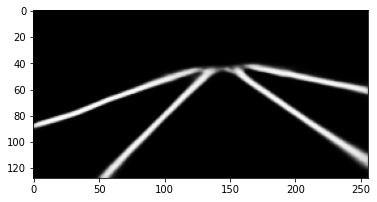

Train Epoch: 0 [35800/91660 (39%)]	Loss: 0.153474


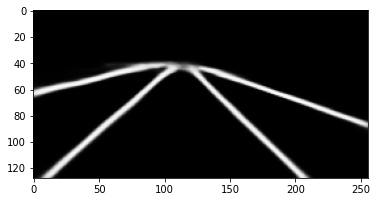

Train Epoch: 0 [35850/91660 (39%)]	Loss: 0.153608


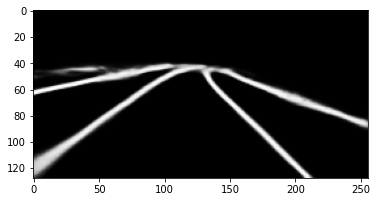

Train Epoch: 0 [35900/91660 (39%)]	Loss: 0.175008


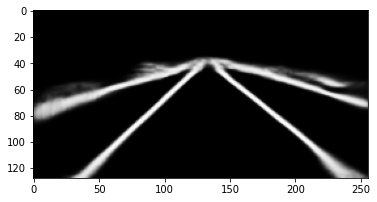

Train Epoch: 0 [35950/91660 (39%)]	Loss: 0.137610


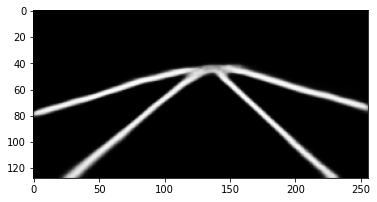

Train Epoch: 0 [36000/91660 (39%)]	Loss: 0.145986


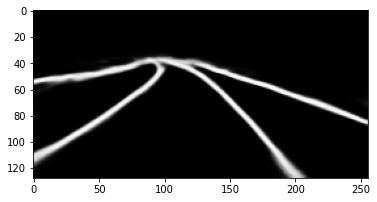

Train Epoch: 0 [36050/91660 (39%)]	Loss: 0.189028


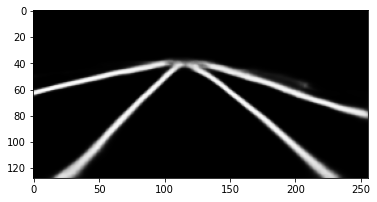

Train Epoch: 0 [36100/91660 (39%)]	Loss: 0.214122


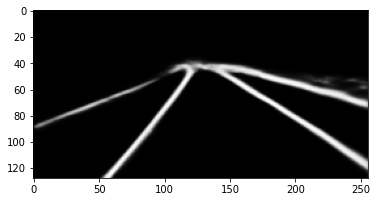

Train Epoch: 0 [36150/91660 (39%)]	Loss: 0.132790


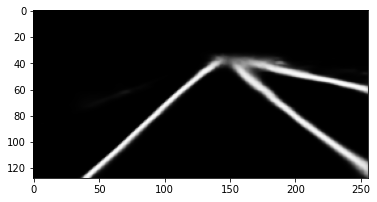

Train Epoch: 0 [36200/91660 (39%)]	Loss: 0.133916


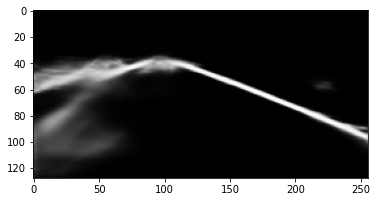

Train Epoch: 0 [36250/91660 (40%)]	Loss: 0.158583


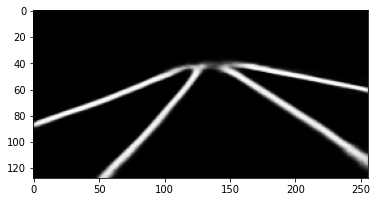

Train Epoch: 0 [36300/91660 (40%)]	Loss: 0.175962


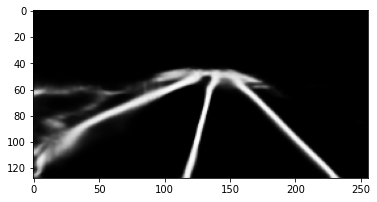

Train Epoch: 0 [36350/91660 (40%)]	Loss: 0.219852


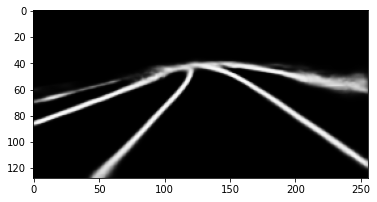

Train Epoch: 0 [36400/91660 (40%)]	Loss: 0.147862


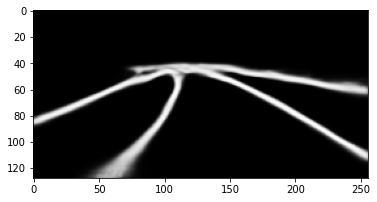

Train Epoch: 0 [36450/91660 (40%)]	Loss: 0.151992


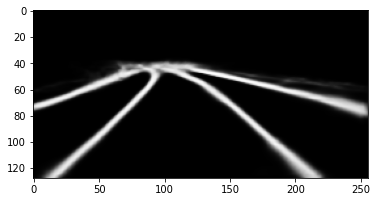

Train Epoch: 0 [36500/91660 (40%)]	Loss: 0.147736


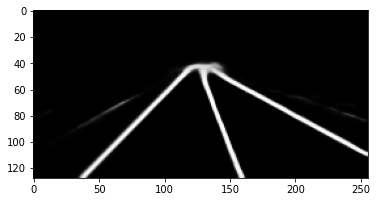

Train Epoch: 0 [36550/91660 (40%)]	Loss: 0.126692


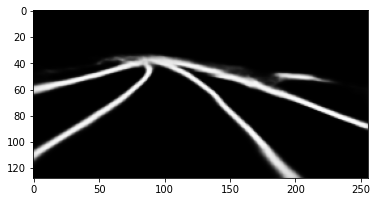

Train Epoch: 0 [36600/91660 (40%)]	Loss: 0.147546


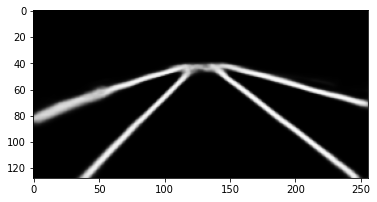

Train Epoch: 0 [36650/91660 (40%)]	Loss: 0.163215


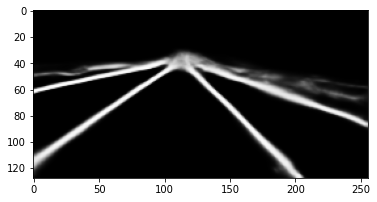

Train Epoch: 0 [36700/91660 (40%)]	Loss: 0.159047


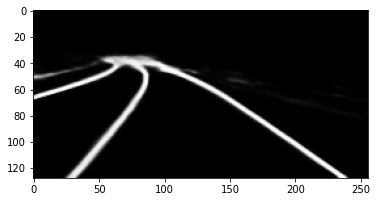

Train Epoch: 0 [36750/91660 (40%)]	Loss: 0.174545


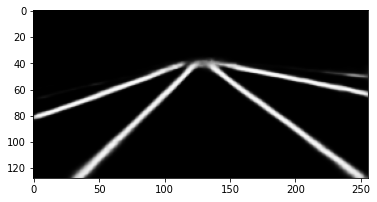

Train Epoch: 0 [36800/91660 (40%)]	Loss: 0.172334


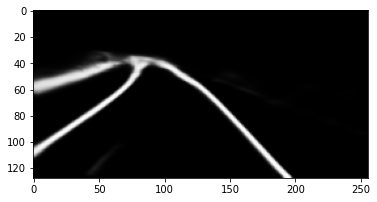

Train Epoch: 0 [36850/91660 (40%)]	Loss: 0.168622


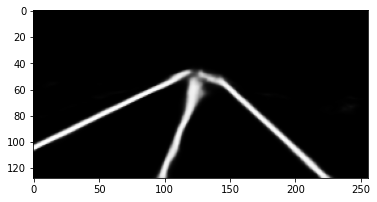

Train Epoch: 0 [36900/91660 (40%)]	Loss: 0.205748


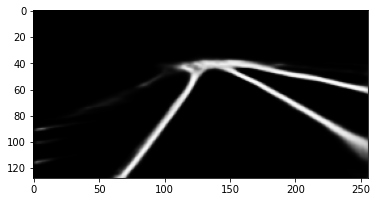

Train Epoch: 0 [36950/91660 (40%)]	Loss: 0.142500


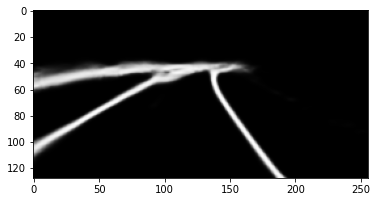

Train Epoch: 0 [37000/91660 (40%)]	Loss: 0.171714


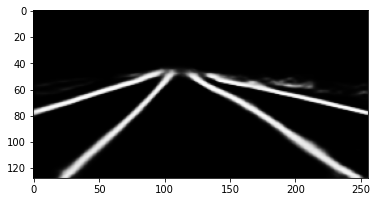

Train Epoch: 0 [37050/91660 (40%)]	Loss: 0.233492


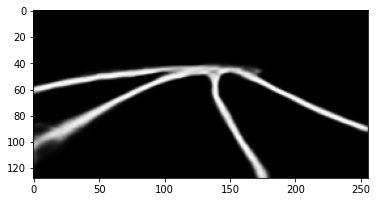

Train Epoch: 0 [37100/91660 (40%)]	Loss: 0.213112


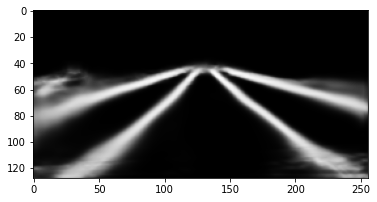

Train Epoch: 0 [37150/91660 (41%)]	Loss: 0.171404


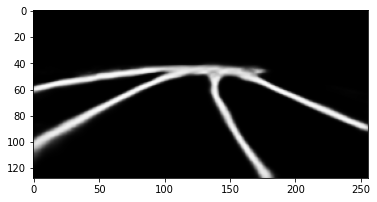

Train Epoch: 0 [37200/91660 (41%)]	Loss: 0.156709


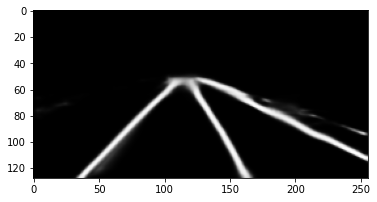

Train Epoch: 0 [37250/91660 (41%)]	Loss: 0.168606


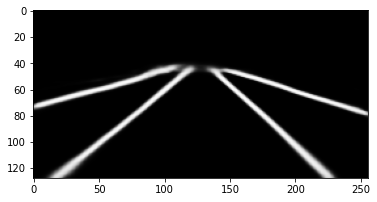

Train Epoch: 0 [37300/91660 (41%)]	Loss: 0.163718


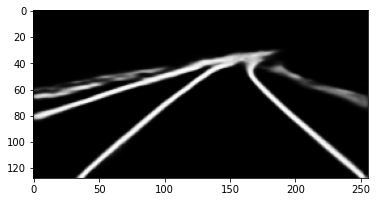

Train Epoch: 0 [37350/91660 (41%)]	Loss: 0.166581


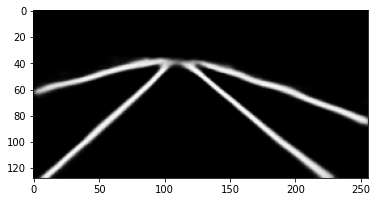

Train Epoch: 0 [37400/91660 (41%)]	Loss: 0.129979


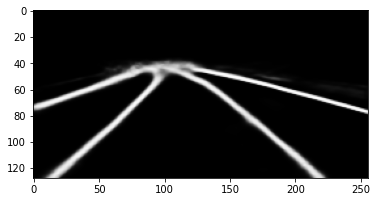

Train Epoch: 0 [37450/91660 (41%)]	Loss: 0.139157


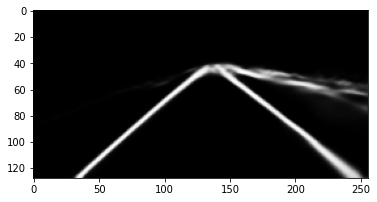

Train Epoch: 0 [37500/91660 (41%)]	Loss: 0.164728


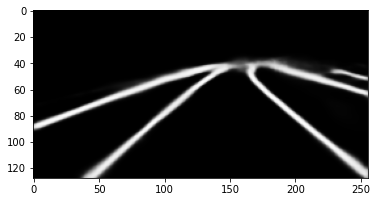

Train Epoch: 0 [37550/91660 (41%)]	Loss: 0.172087


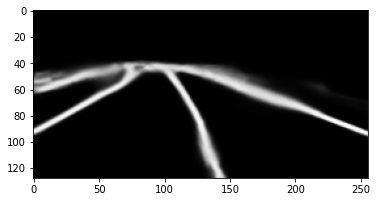

Train Epoch: 0 [37600/91660 (41%)]	Loss: 0.145047


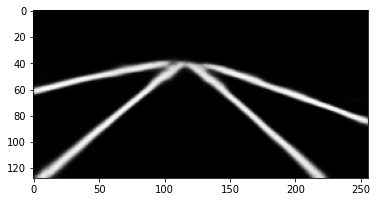

Train Epoch: 0 [37650/91660 (41%)]	Loss: 0.234339


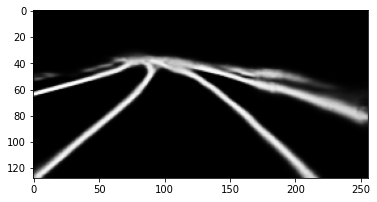

Train Epoch: 0 [37700/91660 (41%)]	Loss: 0.157156


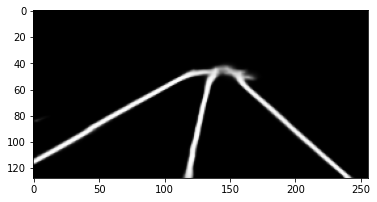

Train Epoch: 0 [37750/91660 (41%)]	Loss: 0.202170


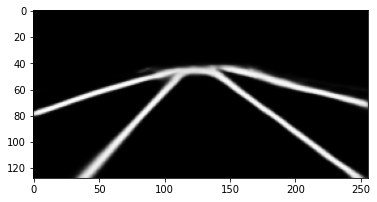

Train Epoch: 0 [37800/91660 (41%)]	Loss: 0.144717


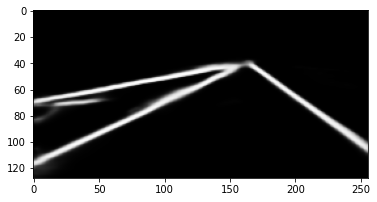

Train Epoch: 0 [37850/91660 (41%)]	Loss: 0.134629


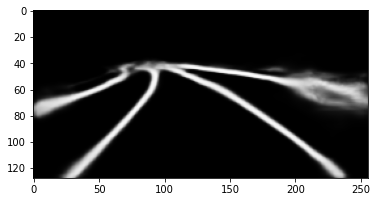

Train Epoch: 0 [37900/91660 (41%)]	Loss: 0.196338


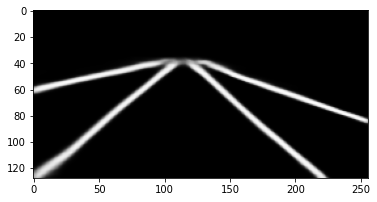

Train Epoch: 0 [37950/91660 (41%)]	Loss: 0.112420


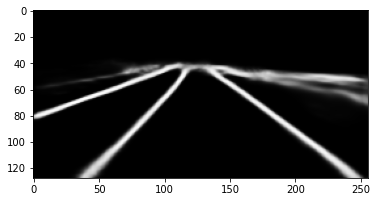

Train Epoch: 0 [38000/91660 (41%)]	Loss: 0.182417


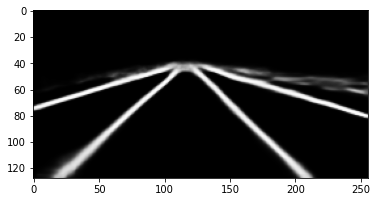

Train Epoch: 0 [38050/91660 (42%)]	Loss: 0.131561


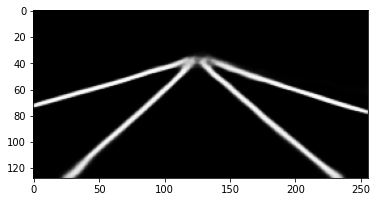

Train Epoch: 0 [38100/91660 (42%)]	Loss: 0.159436


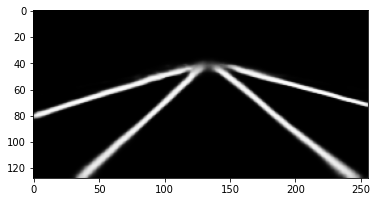

Train Epoch: 0 [38150/91660 (42%)]	Loss: 0.254642


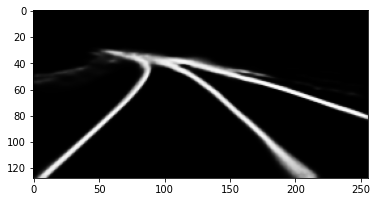

Train Epoch: 0 [38200/91660 (42%)]	Loss: 0.212899


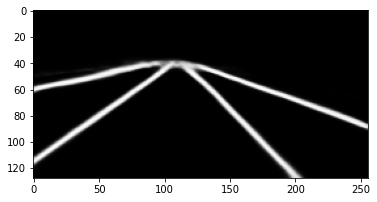

Train Epoch: 0 [38250/91660 (42%)]	Loss: 0.218868


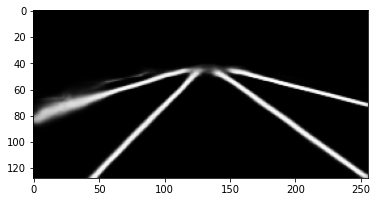

Train Epoch: 0 [38300/91660 (42%)]	Loss: 0.155477


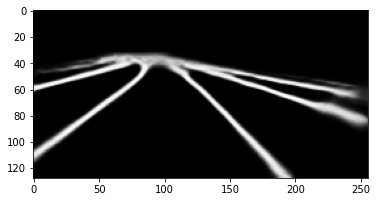

Train Epoch: 0 [38350/91660 (42%)]	Loss: 0.170952


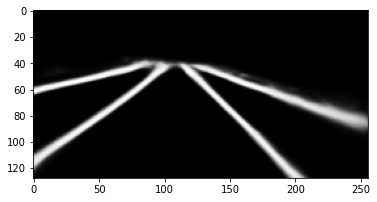

Train Epoch: 0 [38400/91660 (42%)]	Loss: 0.141134


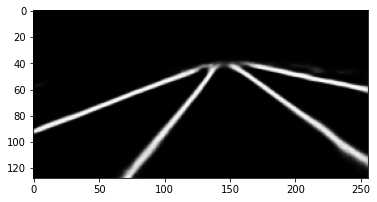

Train Epoch: 0 [38450/91660 (42%)]	Loss: 0.163083


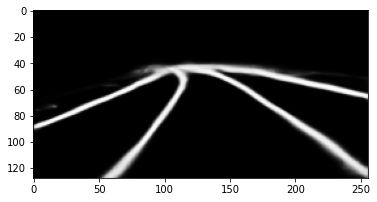

Train Epoch: 0 [38500/91660 (42%)]	Loss: 0.174552


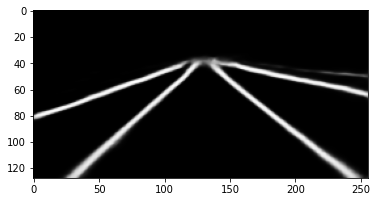

Train Epoch: 0 [38550/91660 (42%)]	Loss: 0.157262


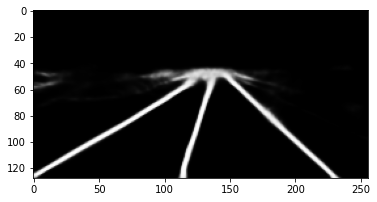

Train Epoch: 0 [38600/91660 (42%)]	Loss: 0.137933


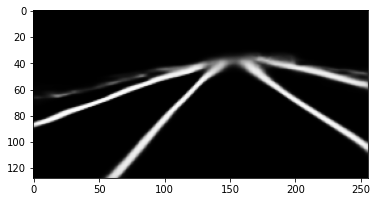

Train Epoch: 0 [38650/91660 (42%)]	Loss: 0.199316


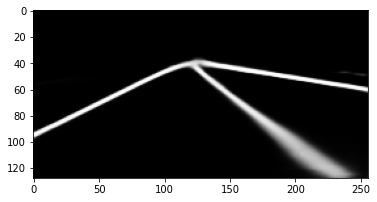

Train Epoch: 0 [38700/91660 (42%)]	Loss: 0.210256


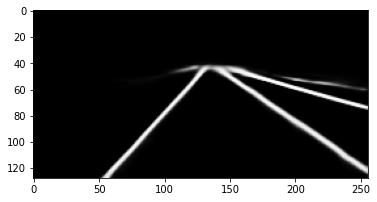

Train Epoch: 0 [38750/91660 (42%)]	Loss: 0.205951


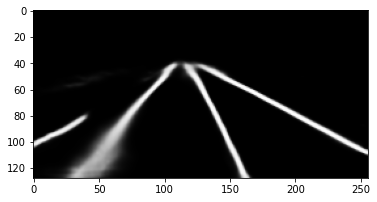

Train Epoch: 0 [38800/91660 (42%)]	Loss: 0.134766


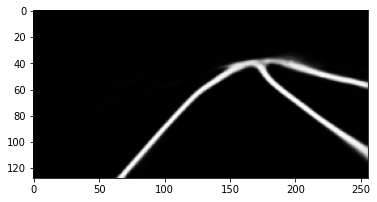

Train Epoch: 0 [38850/91660 (42%)]	Loss: 0.165074


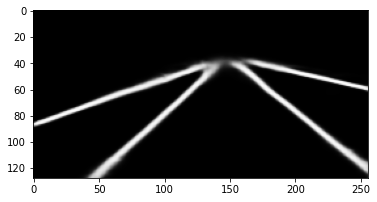

Train Epoch: 0 [38900/91660 (42%)]	Loss: 0.170504


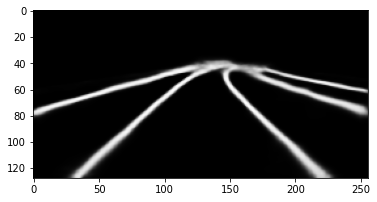

Train Epoch: 0 [38950/91660 (42%)]	Loss: 0.152909


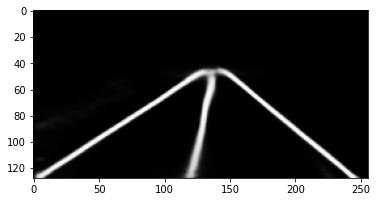

Train Epoch: 0 [39000/91660 (43%)]	Loss: 0.191574


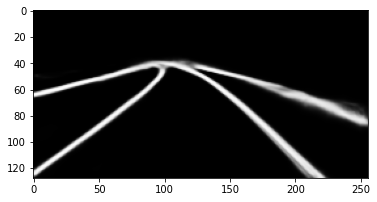

Train Epoch: 0 [39050/91660 (43%)]	Loss: 0.200524


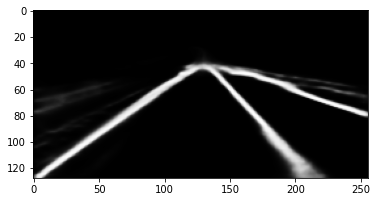

Train Epoch: 0 [39100/91660 (43%)]	Loss: 0.154372


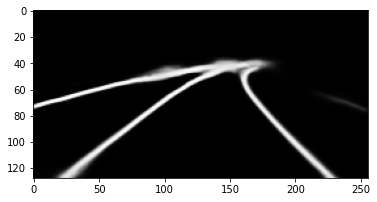

Train Epoch: 0 [39150/91660 (43%)]	Loss: 0.209221


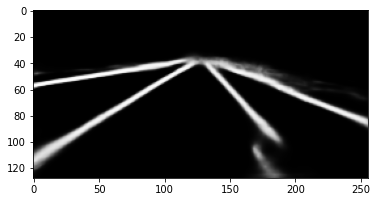

Train Epoch: 0 [39200/91660 (43%)]	Loss: 0.247539


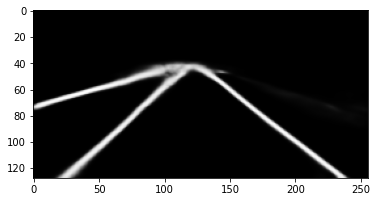

Train Epoch: 0 [39250/91660 (43%)]	Loss: 0.166911


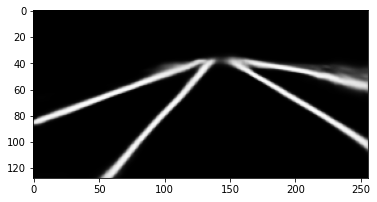

Train Epoch: 0 [39300/91660 (43%)]	Loss: 0.149993


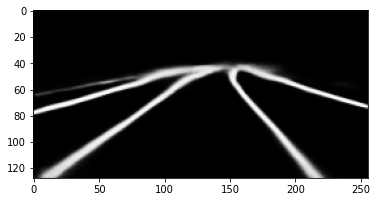

Train Epoch: 0 [39350/91660 (43%)]	Loss: 0.160793


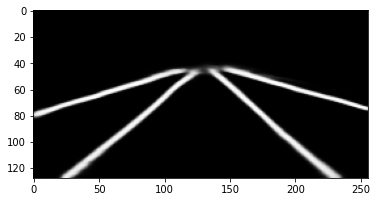

Train Epoch: 0 [39400/91660 (43%)]	Loss: 0.217224


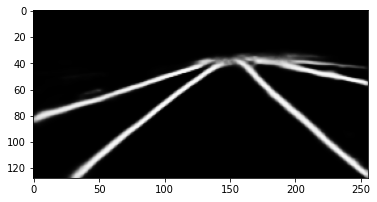

Train Epoch: 0 [39450/91660 (43%)]	Loss: 0.177614


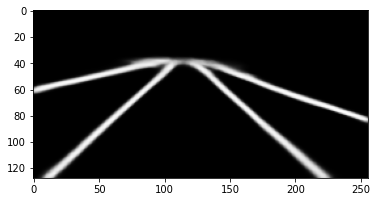

Train Epoch: 0 [39500/91660 (43%)]	Loss: 0.164979


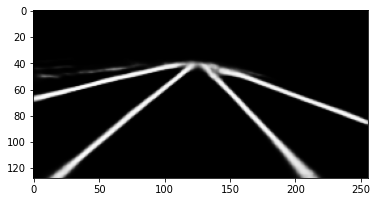

Train Epoch: 0 [39550/91660 (43%)]	Loss: 0.136079


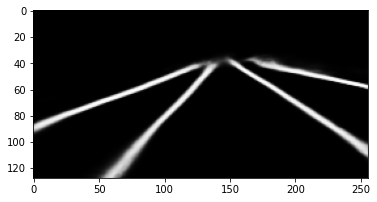

Train Epoch: 0 [39600/91660 (43%)]	Loss: 0.163752


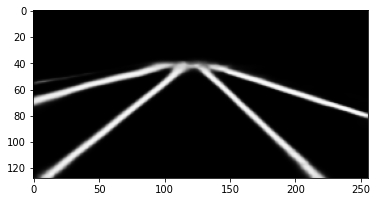

Train Epoch: 0 [39650/91660 (43%)]	Loss: 0.225764


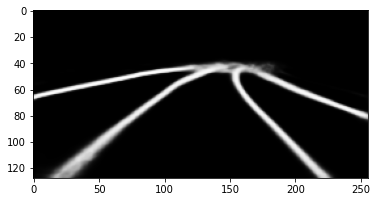

Train Epoch: 0 [39700/91660 (43%)]	Loss: 0.185439


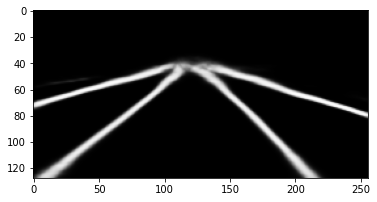

Train Epoch: 0 [39750/91660 (43%)]	Loss: 0.176099


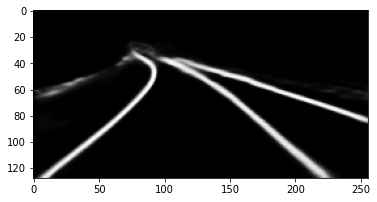

Train Epoch: 0 [39800/91660 (43%)]	Loss: 0.150702


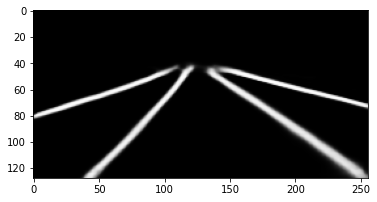

Train Epoch: 0 [39850/91660 (43%)]	Loss: 0.223579


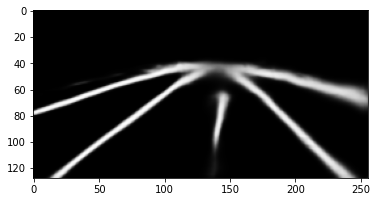

Train Epoch: 0 [39900/91660 (44%)]	Loss: 0.141795


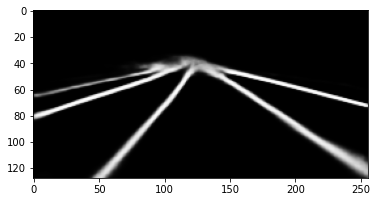

Train Epoch: 0 [39950/91660 (44%)]	Loss: 0.231580


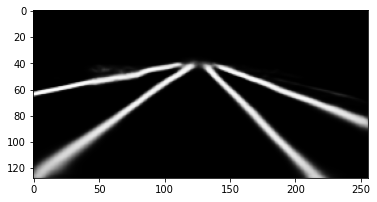

Train Epoch: 0 [40000/91660 (44%)]	Loss: 0.189850


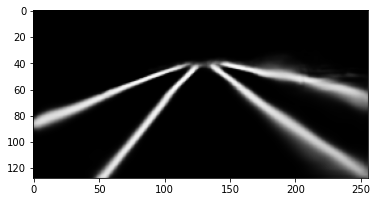

Train Epoch: 0 [40050/91660 (44%)]	Loss: 0.163096


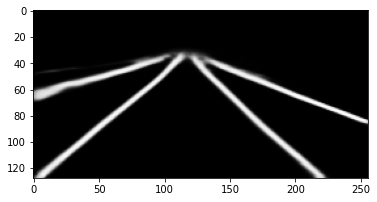

Train Epoch: 0 [40100/91660 (44%)]	Loss: 0.114257


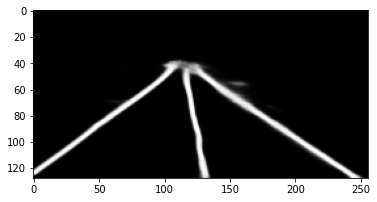

Train Epoch: 0 [40150/91660 (44%)]	Loss: 0.139469


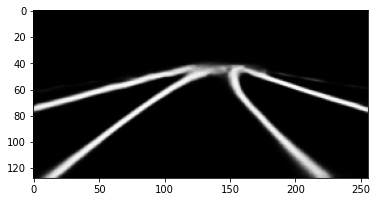

Train Epoch: 0 [40200/91660 (44%)]	Loss: 0.207419


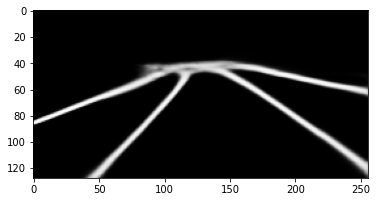

Train Epoch: 0 [40250/91660 (44%)]	Loss: 0.168820


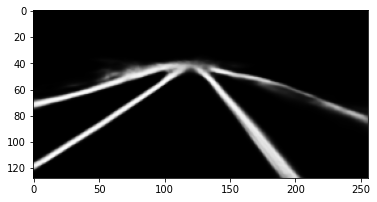

Train Epoch: 0 [40300/91660 (44%)]	Loss: 0.183646


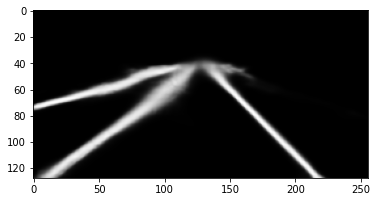

Train Epoch: 0 [40350/91660 (44%)]	Loss: 0.183918


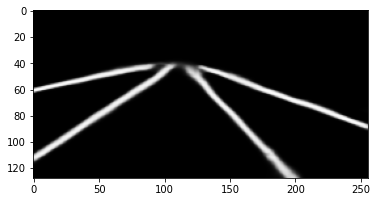

Train Epoch: 0 [40400/91660 (44%)]	Loss: 0.149599


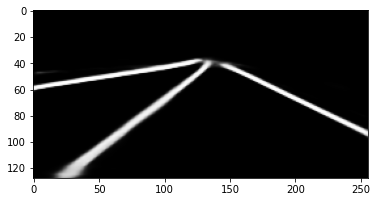

Train Epoch: 0 [40450/91660 (44%)]	Loss: 0.143177


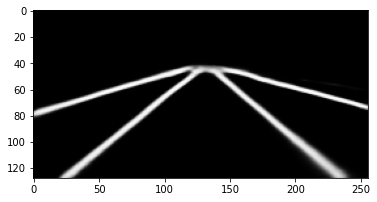

Train Epoch: 0 [40500/91660 (44%)]	Loss: 0.151761


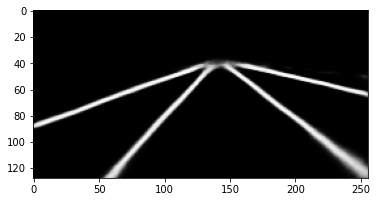

Train Epoch: 0 [40550/91660 (44%)]	Loss: 0.148279


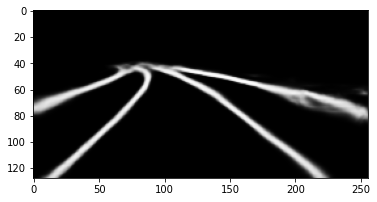

Train Epoch: 0 [40600/91660 (44%)]	Loss: 0.197988


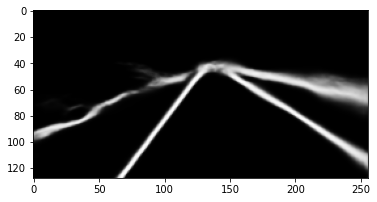

Train Epoch: 0 [40650/91660 (44%)]	Loss: 0.169959


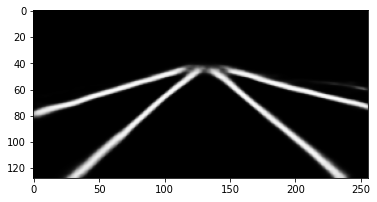

Train Epoch: 0 [40700/91660 (44%)]	Loss: 0.133177


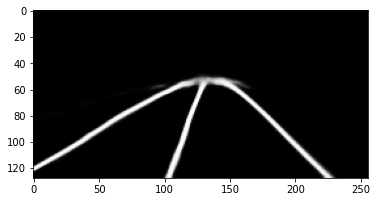

Train Epoch: 0 [40750/91660 (44%)]	Loss: 0.124136


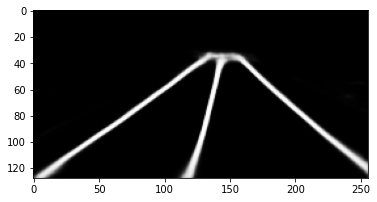

Train Epoch: 0 [40800/91660 (45%)]	Loss: 0.168752


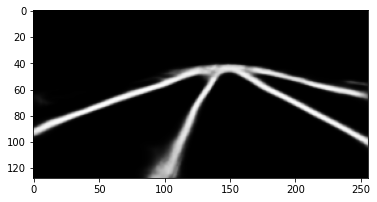

Train Epoch: 0 [40850/91660 (45%)]	Loss: 0.152399


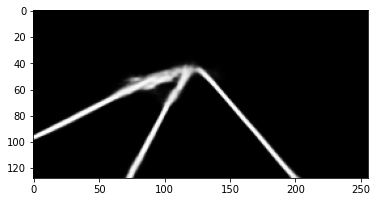

Train Epoch: 0 [40900/91660 (45%)]	Loss: 0.246572


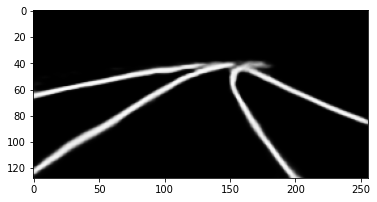

Train Epoch: 0 [40950/91660 (45%)]	Loss: 0.153015


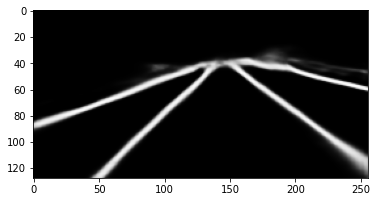

Train Epoch: 0 [41000/91660 (45%)]	Loss: 0.116585


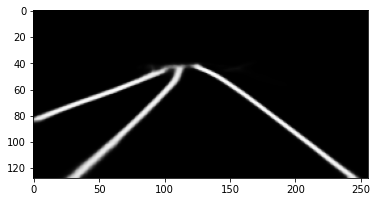

Train Epoch: 0 [41050/91660 (45%)]	Loss: 0.173159


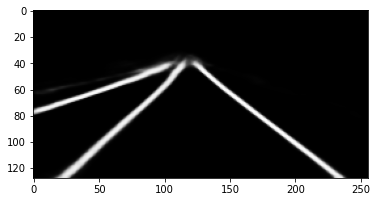

Train Epoch: 0 [41100/91660 (45%)]	Loss: 0.141173


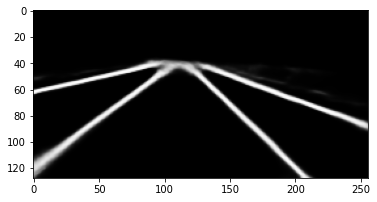

Train Epoch: 0 [41150/91660 (45%)]	Loss: 0.200589


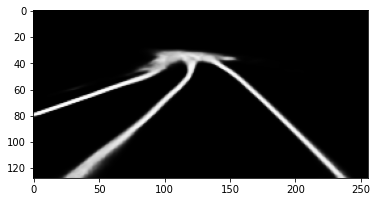

Train Epoch: 0 [41200/91660 (45%)]	Loss: 0.180240


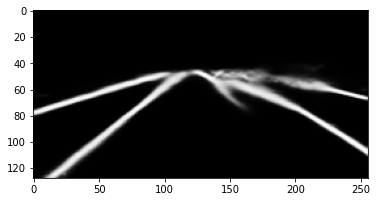

Train Epoch: 0 [41250/91660 (45%)]	Loss: 0.160169


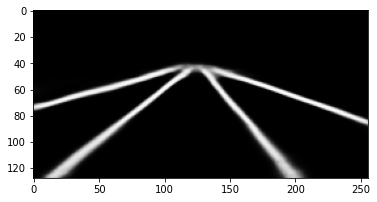

Train Epoch: 0 [41300/91660 (45%)]	Loss: 0.177551


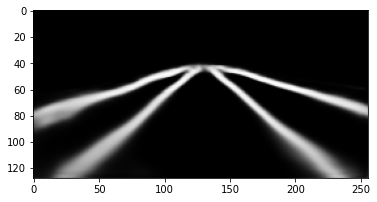

Train Epoch: 0 [41350/91660 (45%)]	Loss: 0.140844


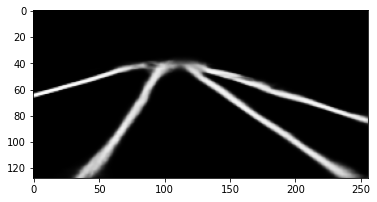

Train Epoch: 0 [41400/91660 (45%)]	Loss: 0.176021


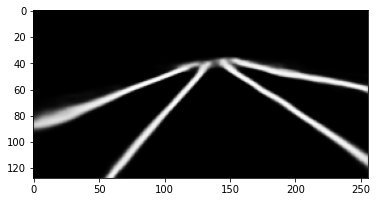

Train Epoch: 0 [41450/91660 (45%)]	Loss: 0.155883


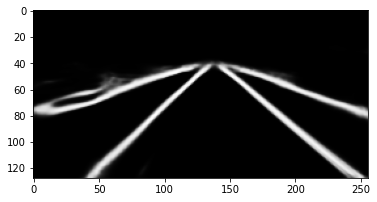

Train Epoch: 0 [41500/91660 (45%)]	Loss: 0.142800


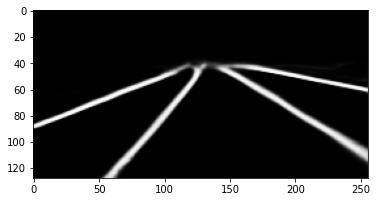

Train Epoch: 0 [41550/91660 (45%)]	Loss: 0.146141


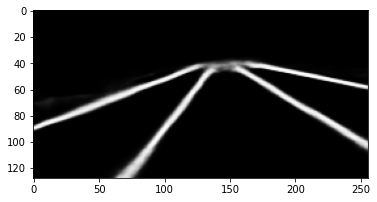

Train Epoch: 0 [41600/91660 (45%)]	Loss: 0.169293


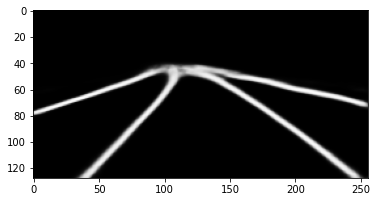

Train Epoch: 0 [41650/91660 (45%)]	Loss: 0.149790


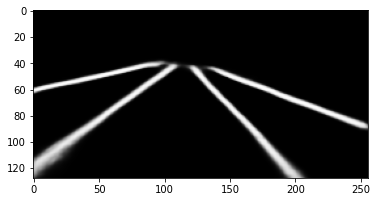

Train Epoch: 0 [41700/91660 (45%)]	Loss: 0.170388


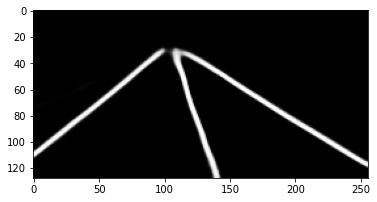

Train Epoch: 0 [41750/91660 (46%)]	Loss: 0.167993


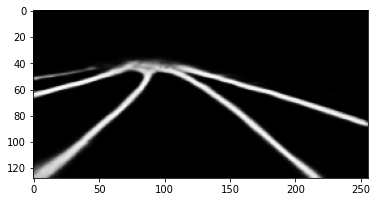

Train Epoch: 0 [41800/91660 (46%)]	Loss: 0.178159


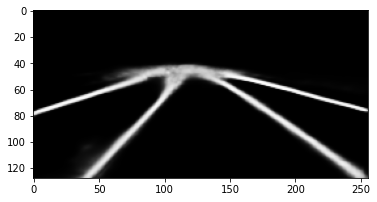

Train Epoch: 0 [41850/91660 (46%)]	Loss: 0.191284


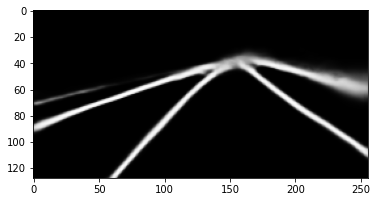

Train Epoch: 0 [41900/91660 (46%)]	Loss: 0.139121


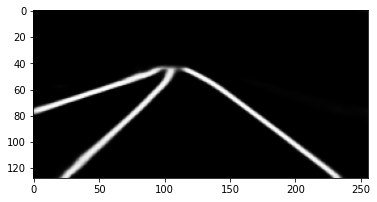

Train Epoch: 0 [41950/91660 (46%)]	Loss: 0.148132


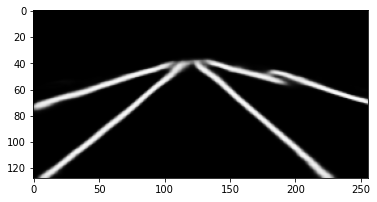

Train Epoch: 0 [42000/91660 (46%)]	Loss: 0.149617


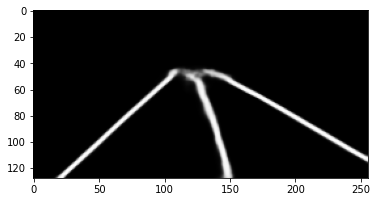

Train Epoch: 0 [42050/91660 (46%)]	Loss: 0.208959


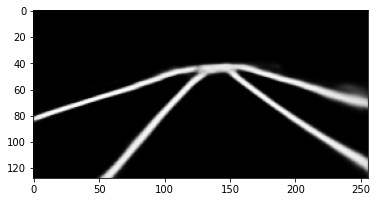

Train Epoch: 0 [42100/91660 (46%)]	Loss: 0.153431


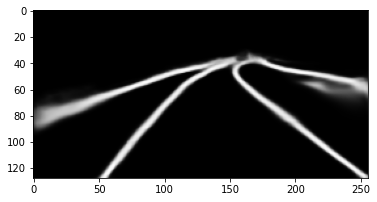

Train Epoch: 0 [42150/91660 (46%)]	Loss: 0.255126


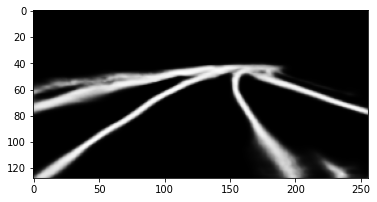

Train Epoch: 0 [42200/91660 (46%)]	Loss: 0.136674


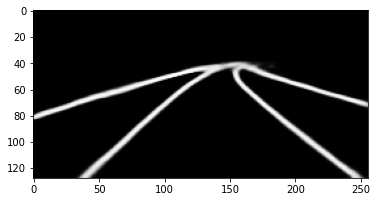

Train Epoch: 0 [42250/91660 (46%)]	Loss: 0.256260


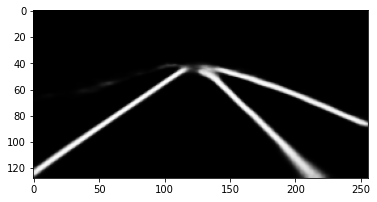

Train Epoch: 0 [42300/91660 (46%)]	Loss: 0.165777


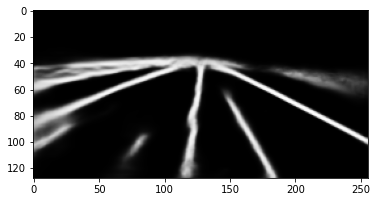

Train Epoch: 0 [42350/91660 (46%)]	Loss: 0.143773


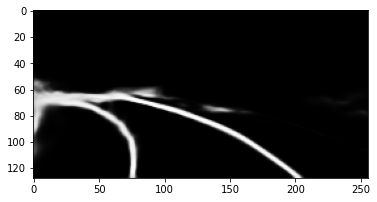

Train Epoch: 0 [42400/91660 (46%)]	Loss: 0.242659


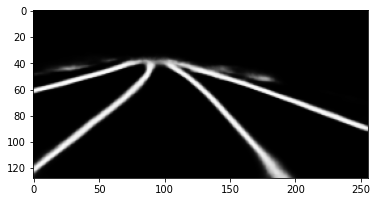

Train Epoch: 0 [42450/91660 (46%)]	Loss: 0.136216


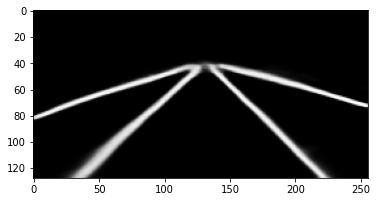

Train Epoch: 0 [42500/91660 (46%)]	Loss: 0.177487


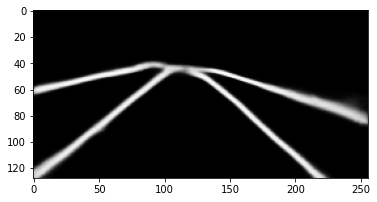

Train Epoch: 0 [42550/91660 (46%)]	Loss: 0.144815


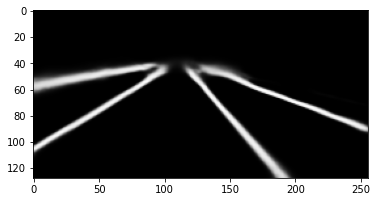

Train Epoch: 0 [42600/91660 (46%)]	Loss: 0.164679


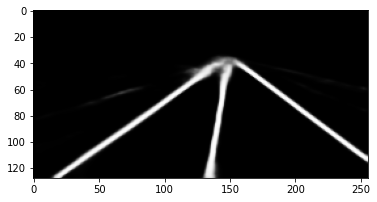

Train Epoch: 0 [42650/91660 (47%)]	Loss: 0.203865


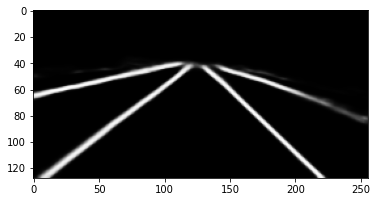

Train Epoch: 0 [42700/91660 (47%)]	Loss: 0.185952


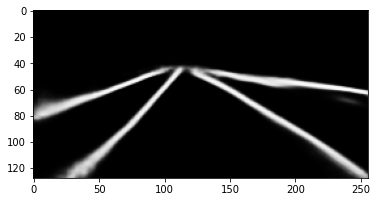

Train Epoch: 0 [42750/91660 (47%)]	Loss: 0.157381


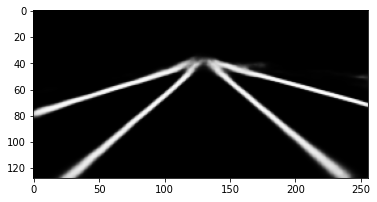

Train Epoch: 0 [42800/91660 (47%)]	Loss: 0.124494


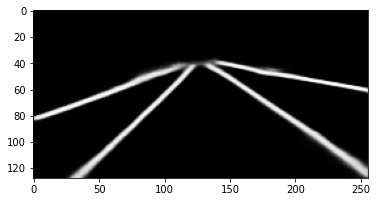

Train Epoch: 0 [42850/91660 (47%)]	Loss: 0.129303


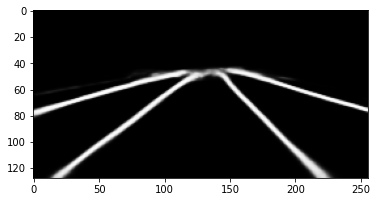

Train Epoch: 0 [42900/91660 (47%)]	Loss: 0.189015


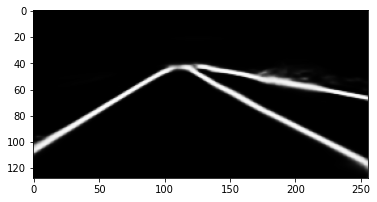

Train Epoch: 0 [42950/91660 (47%)]	Loss: 0.195854


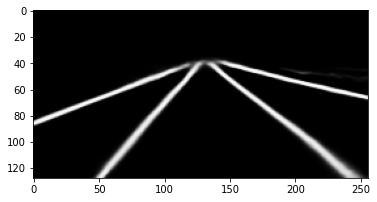

Train Epoch: 0 [43000/91660 (47%)]	Loss: 0.169446


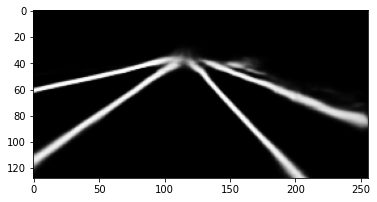

Train Epoch: 0 [43050/91660 (47%)]	Loss: 0.155203


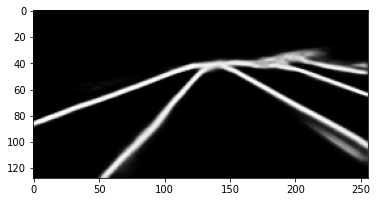

Train Epoch: 0 [43100/91660 (47%)]	Loss: 0.183037


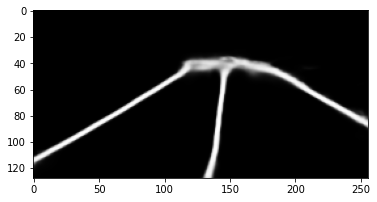

Train Epoch: 0 [43150/91660 (47%)]	Loss: 0.146660


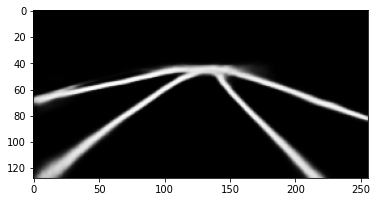

Train Epoch: 0 [43200/91660 (47%)]	Loss: 0.154731


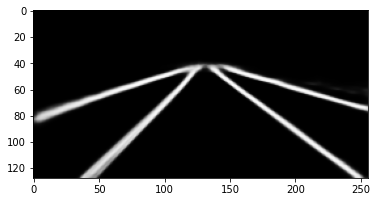

Train Epoch: 0 [43250/91660 (47%)]	Loss: 0.173923


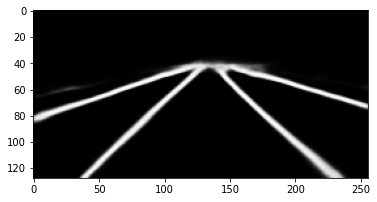

Train Epoch: 0 [43300/91660 (47%)]	Loss: 0.140944


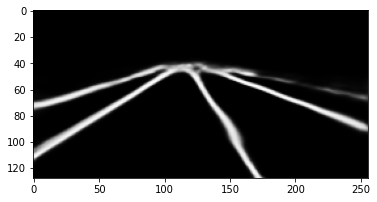

Train Epoch: 0 [43350/91660 (47%)]	Loss: 0.138995


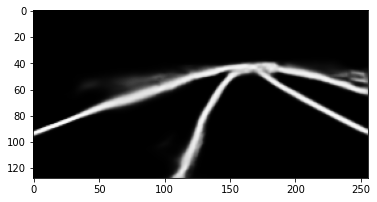

Train Epoch: 0 [43400/91660 (47%)]	Loss: 0.134660


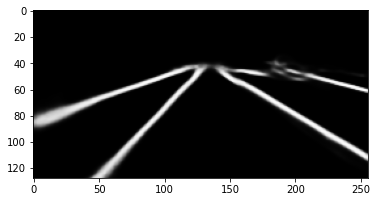

Train Epoch: 0 [43450/91660 (47%)]	Loss: 0.190705


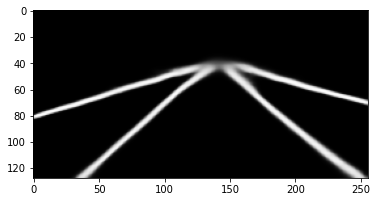

Train Epoch: 0 [43500/91660 (47%)]	Loss: 0.137870


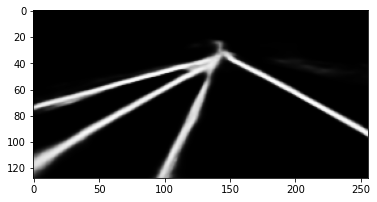

Train Epoch: 0 [43550/91660 (48%)]	Loss: 0.235504


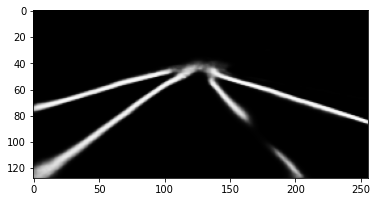

Train Epoch: 0 [43600/91660 (48%)]	Loss: 0.162811


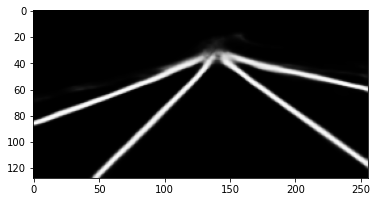

Train Epoch: 0 [43650/91660 (48%)]	Loss: 0.149078


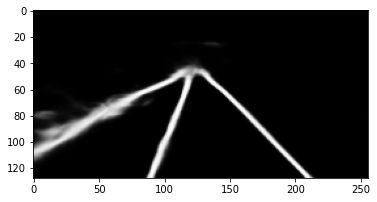

Train Epoch: 0 [43700/91660 (48%)]	Loss: 0.181237


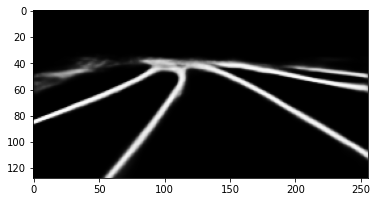

Train Epoch: 0 [43750/91660 (48%)]	Loss: 0.136931


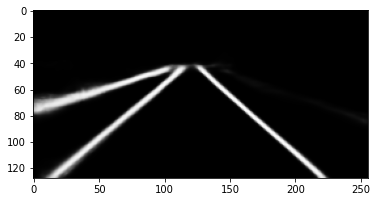

Train Epoch: 0 [43800/91660 (48%)]	Loss: 0.124357


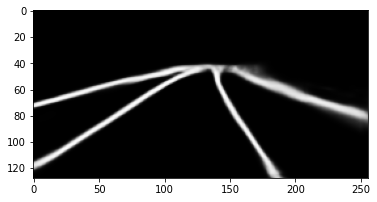

Train Epoch: 0 [43850/91660 (48%)]	Loss: 0.142182


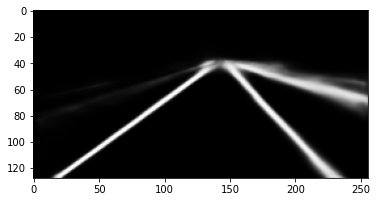

Train Epoch: 0 [43900/91660 (48%)]	Loss: 0.238017


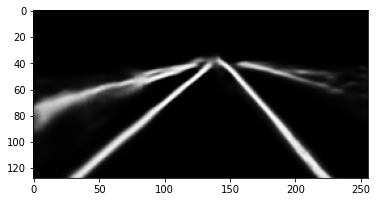

Train Epoch: 0 [43950/91660 (48%)]	Loss: 0.171531


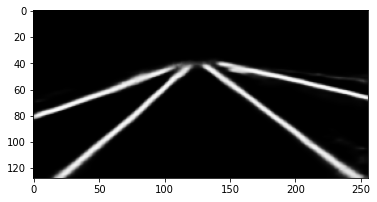

Train Epoch: 0 [44000/91660 (48%)]	Loss: 0.135796


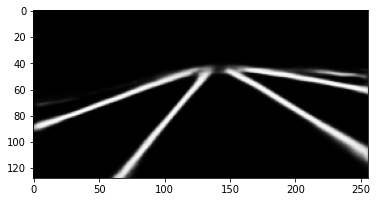

Train Epoch: 0 [44050/91660 (48%)]	Loss: 0.182148


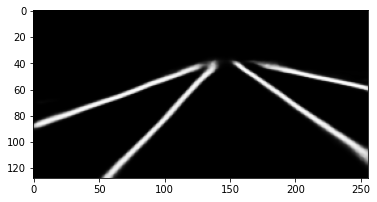

Train Epoch: 0 [44100/91660 (48%)]	Loss: 0.137163


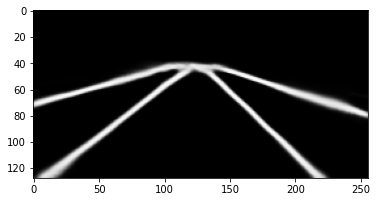

Train Epoch: 0 [44150/91660 (48%)]	Loss: 0.130593


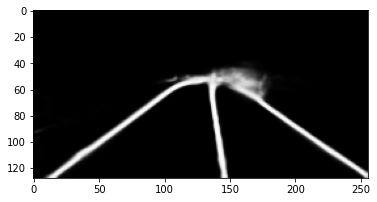

Train Epoch: 0 [44200/91660 (48%)]	Loss: 0.205997


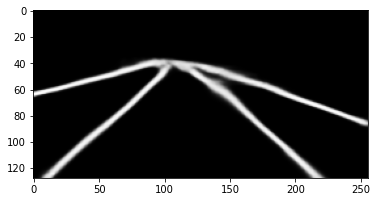

Train Epoch: 0 [44250/91660 (48%)]	Loss: 0.170555


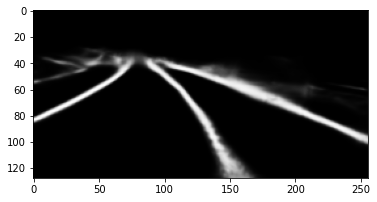

Train Epoch: 0 [44300/91660 (48%)]	Loss: 0.218056


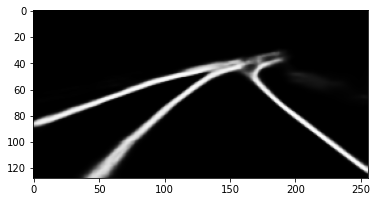

Train Epoch: 0 [44350/91660 (48%)]	Loss: 0.135326


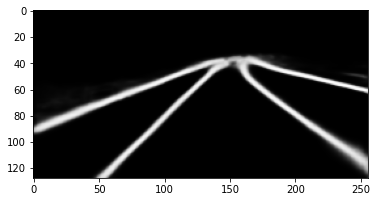

Train Epoch: 0 [44400/91660 (48%)]	Loss: 0.187415


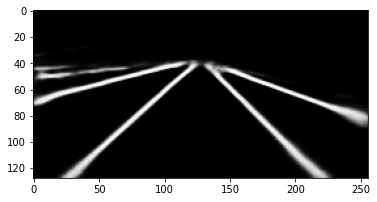

Train Epoch: 0 [44450/91660 (48%)]	Loss: 0.135134


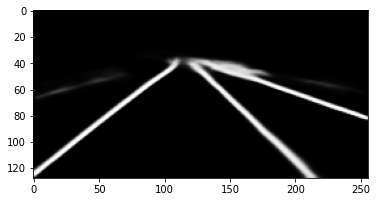

Train Epoch: 0 [44500/91660 (49%)]	Loss: 0.204367


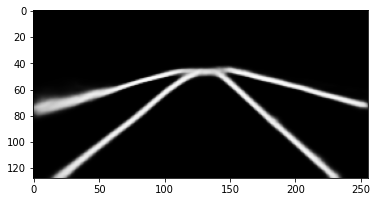

Train Epoch: 0 [44550/91660 (49%)]	Loss: 0.155201


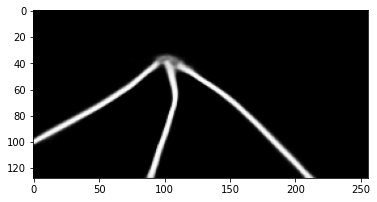

Train Epoch: 0 [44600/91660 (49%)]	Loss: 0.118505


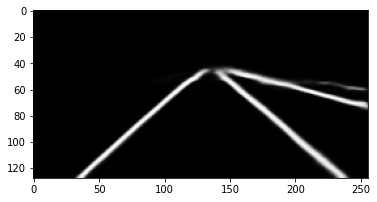

Train Epoch: 0 [44650/91660 (49%)]	Loss: 0.183482


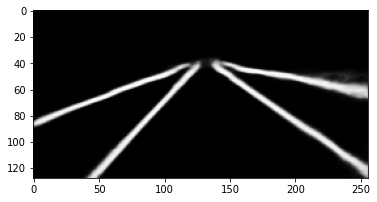

Train Epoch: 0 [44700/91660 (49%)]	Loss: 0.190953


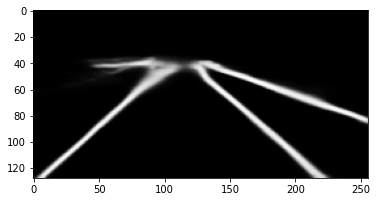

Train Epoch: 0 [44750/91660 (49%)]	Loss: 0.140148


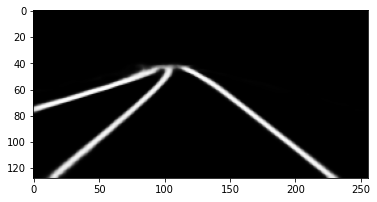

Train Epoch: 0 [44800/91660 (49%)]	Loss: 0.221959


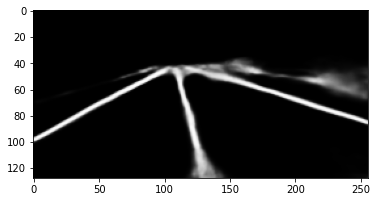

Train Epoch: 0 [44850/91660 (49%)]	Loss: 0.163153


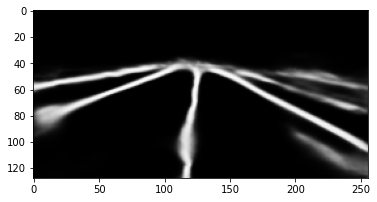

Train Epoch: 0 [44900/91660 (49%)]	Loss: 0.178894


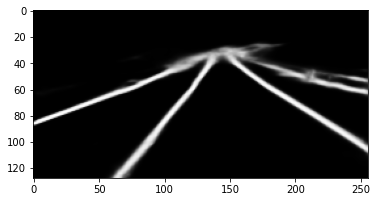

Train Epoch: 0 [44950/91660 (49%)]	Loss: 0.132929


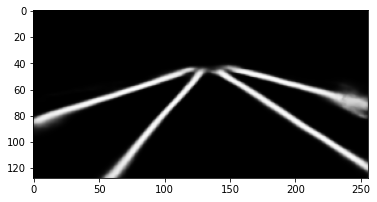

Train Epoch: 0 [45000/91660 (49%)]	Loss: 0.115922


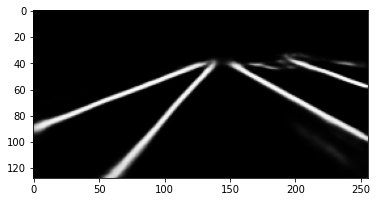

Train Epoch: 0 [45050/91660 (49%)]	Loss: 0.159626


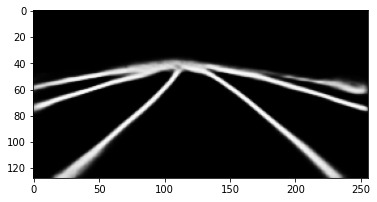

Train Epoch: 0 [45100/91660 (49%)]	Loss: 0.230156


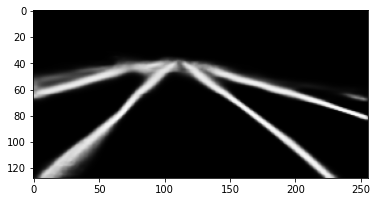

Train Epoch: 0 [45150/91660 (49%)]	Loss: 0.138843


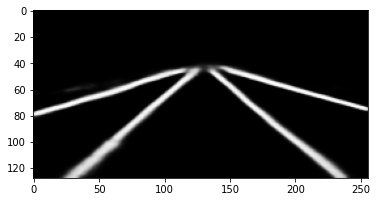

Train Epoch: 0 [45200/91660 (49%)]	Loss: 0.106177


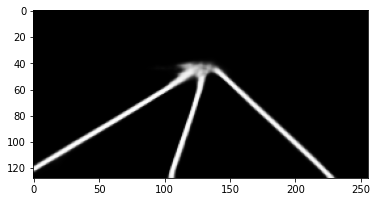

Train Epoch: 0 [45250/91660 (49%)]	Loss: 0.179511


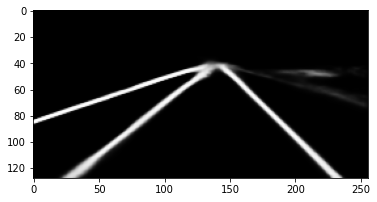

Train Epoch: 0 [45300/91660 (49%)]	Loss: 0.193823


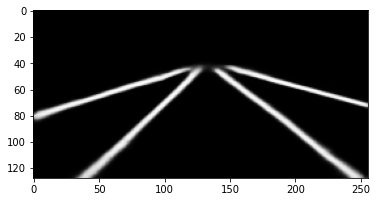

Train Epoch: 0 [45350/91660 (49%)]	Loss: 0.140799


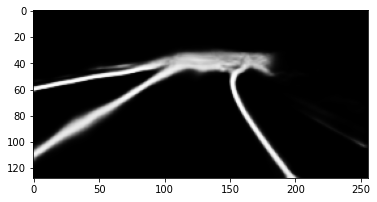

Train Epoch: 0 [45400/91660 (50%)]	Loss: 0.175643


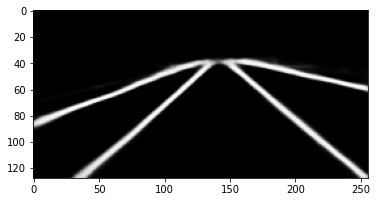

Train Epoch: 0 [45450/91660 (50%)]	Loss: 0.212270


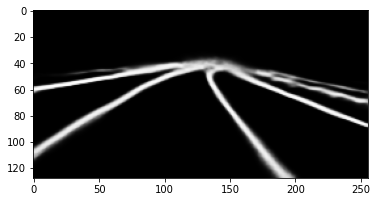

Train Epoch: 0 [45500/91660 (50%)]	Loss: 0.170695


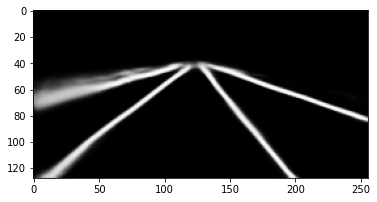

Train Epoch: 0 [45550/91660 (50%)]	Loss: 0.153366


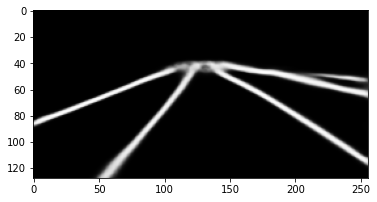

Train Epoch: 0 [45600/91660 (50%)]	Loss: 0.161228


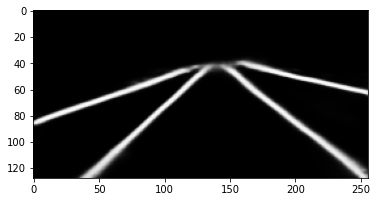

Train Epoch: 0 [45650/91660 (50%)]	Loss: 0.172454


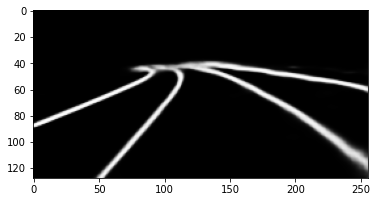

Train Epoch: 0 [45700/91660 (50%)]	Loss: 0.188426


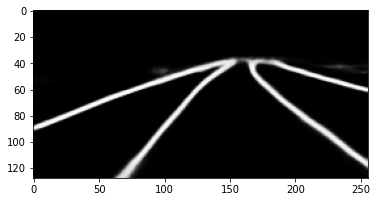

In [ ]:
for epoch in range(1):
    train(args, epoch, model, train_loader, optimizer, batch_size)
    val(args, model, val_loader, epoch)